داده ها به ترین و ولیدیشن تقسیم شده ان
بعدا تست هم درست کن لطفا!

In [8]:
import os
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
# مسیر دایرکتوری تصاویر
img_dir = 'Data/Image'
json_dir = 'Data/Label'
# لیست کردن تمام فایل‌های تصویر
all_images = [img for img in os.listdir(img_dir) if img.lower().endswith(('png', 'jpg', 'jpeg'))]
all_json = [json for json in os.listdir(json_dir) if json.lower().endswith('json')]

# انتخاب رندوم 15 تصویر برای train
train_size = np.int64(np.round(len(all_images) * 0.8))

train_images = random.sample(all_images, train_size)
train_json = [json for json in all_json if json.split(".")[0]+".jpg" in all_images or json.split(".")[0]+".png" in all_images or json.split(".")[0]+".jpeg" in all_images]



# تقسیم بقیه تصاویر برای validation
val_images = [img for img in all_images if img not in train_images]
val_json = [json for json in all_json if json not in train_json]

linked_dic = [(json, json.split('.')[0]+ext) for json in all_json for ext in ['.jpg', '.png', '.jpeg'] if json.split('.')[0]+ext in all_images]

train_linked_dic = [(json, json.split('.')[0]+ext) for json in all_json for ext in ['.jpg', '.png', '.jpeg'] if json.split('.')[0]+ext in train_images]
val_linked_dic = [(json, json.split('.')[0]+ext) for json in all_json for ext in ['.jpg', '.png', '.jpeg'] if json.split('.')[0]+ext in val_images]
print(f"Train size is: {train_size}")
print(f"Validation size is: {len(val_images)}")
print(f'Train Images: {train_images}')
print(f'Validation Images: {val_images}')

Train size is: 72
Validation size is: 18
Train Images: ['WIN_20250122_15_42_06_Pro (2).jpg', 'WIN_20250122_15_42_15_Pro.jpg', 'WIN_20250122_15_43_49_Pro.jpg', 'WIN_20250122_15_42_39_Pro (2).jpg', 'WIN_20250122_15_44_12_Pro.jpg', 'WIN_20250122_15_42_11_Pro (2).jpg', 'WIN_20250122_15_42_10_Pro.jpg', 'WIN_20250122_15_42_00_Pro.jpg', 'WIN_20250122_15_43_57_Pro.jpg', 'WIN_20250122_15_42_30_Pro.jpg', 'WIN_20250122_15_42_22_Pro.jpg', 'WIN_20250122_15_42_36_Pro.jpg', 'WIN_20250122_15_42_43_Pro.jpg', 'WIN_20250122_15_42_27_Pro (2).jpg', 'WIN_20250122_15_42_50_Pro.jpg', 'WIN_20250122_15_42_04_Pro.jpg', 'WIN_20250122_15_41_57_Pro.jpg', 'WIN_20250122_15_42_48_Pro.jpg', 'WIN_20250122_15_42_05_Pro (2).jpg', 'WIN_20250122_15_42_48_Pro (2).jpg', 'WIN_20250122_15_42_01_Pro (2).jpg', 'WIN_20250122_15_42_07_Pro (3).jpg', 'WIN_20250122_15_42_05_Pro.jpg', 'WIN_20250122_15_42_08_Pro.jpg', 'WIN_20250122_15_42_17_Pro.jpg', 'WIN_20250122_15_42_15_Pro (3).jpg', 'WIN_20250122_15_43_46_Pro.jpg', 'WIN_20250122_15_

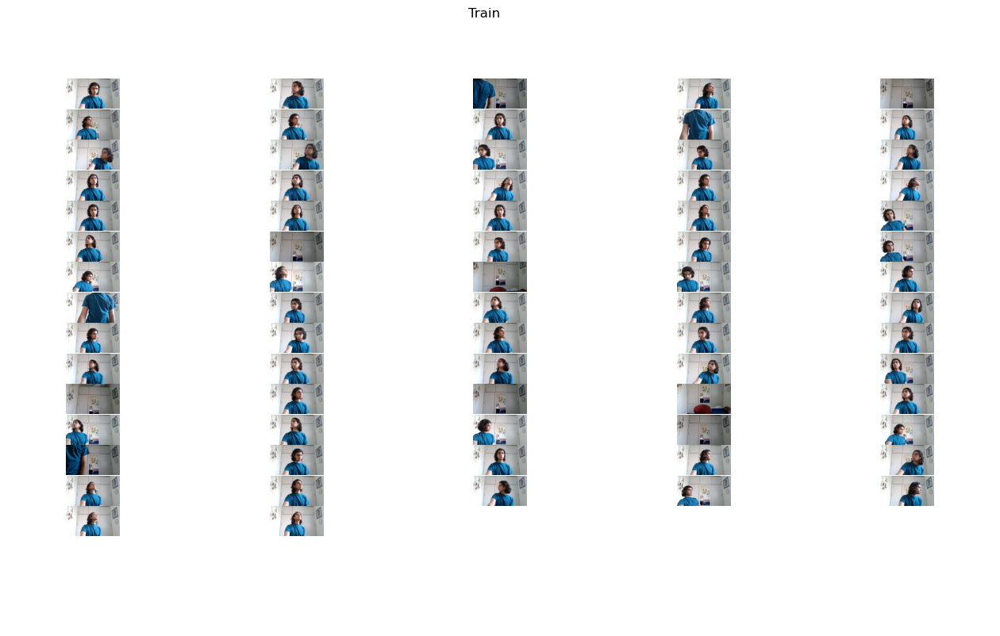

In [24]:
# تابع برای نمایش تصاویر به صورت grid
num_images = len(all_images)
cols = 5
rows = (num_images // cols) + (num_images % cols > 0)
fig, axes = plt.subplots(rows, cols, figsize=(16, 9))
fig.subplots_adjust(hspace=0.5)

for idx, img_name in enumerate(train_images):
    img_path = os.path.join(img_dir, img_name)
    img = mpimg.imread(img_path)
    # کم کردن رزولوشن با downsampling
    small_img = img[::2, ::2]  # کاهش اندازه
    ax = axes[idx // cols, idx % cols]
    ax.imshow(small_img)
    ax.axis('off')

# حذف محورها در صورتی که تصویر کمتر از تعداد گرید باشد
for idx in range(len(train_images), rows * cols):
    axes[idx // cols, idx % cols].axis('off')
    
fig.suptitle('Train')
fig.subplots_adjust(hspace=0.01)
plt.show()

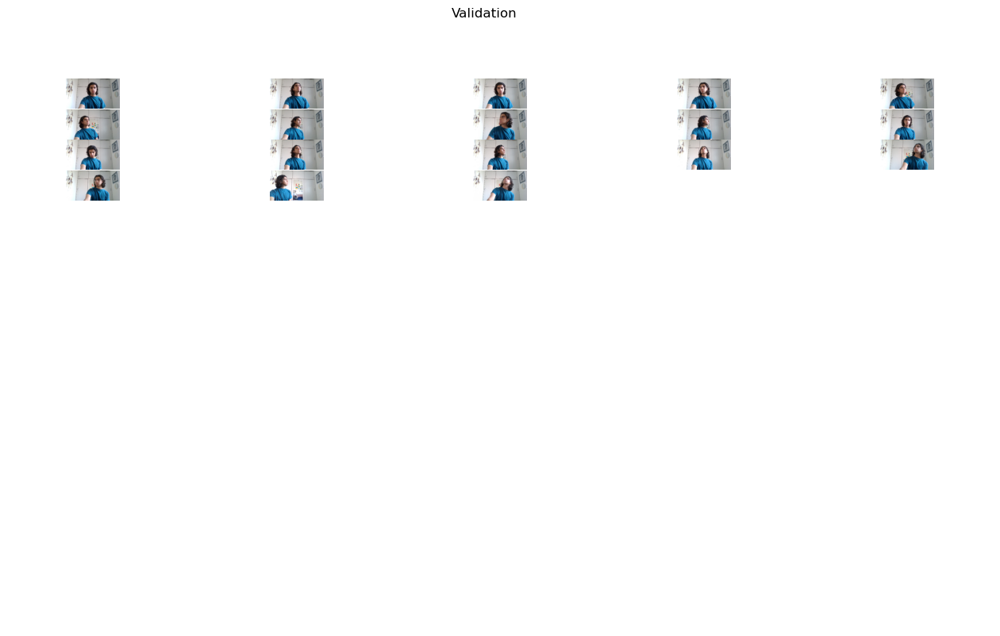

In [26]:
num_images = len(all_images)
cols = 5
rows = (num_images // cols) + (num_images % cols > 0)
fig, axes = plt.subplots(rows, cols, figsize=(16, 9))
fig.subplots_adjust(hspace=0.5)

for idx, img_name in enumerate(val_images):
    img_path = os.path.join(img_dir, img_name)
    img = mpimg.imread(img_path)
    # کم کردن رزولوشن با downsampling
    small_img = img[::5, ::5]  # کاهش اندازه
    ax = axes[idx // cols, idx % cols]
    ax.imshow(small_img)
    ax.axis('off')

# حذف محورها در صورتی که تصویر کمتر از تعداد گرید باشد
for idx in range(len(val_images), rows * cols):
    axes[idx // cols, idx % cols].axis('off')
    
fig.suptitle("Validation")
fig.subplots_adjust(hspace=0.01)
plt.show()

In [27]:
import tensorflow as tf
import json
import numpy as np
import albumentations as alb
import cv2 

In [28]:
img = cv2.imread("Data/Image/"+train_images[0])
img.shape

(720, 1280, 3)

In [29]:
augmentor = alb.Compose([alb.RandomCrop(width=720, height=720), 
                         alb.HorizontalFlip(p=0.5), 
                         alb.RandomBrightnessContrast(p=0.2),
                         alb.RandomGamma(p=0.2), 
                         alb.RGBShift(p=0.2), 
                         alb.VerticalFlip(p=0.5)], 
                       bbox_params=alb.BboxParams(format='albumentations', 
                                                  label_fields=['class_labels']))

C:\ProgramData\anaconda3\lib\site-packages\pydantic\main.py:426: UserWarning: Pydantic serializer warnings:
  Expected `dict[str, any]` but got `UniformParams` with value `UniformParams(noise_type=...6, 0.0784313725490196)])` - serialized value may not be as expected
  return self.__pydantic_serializer__.to_python(


In [30]:
img = cv2.imread("Data/Image/"+linked_dic[0][1])

with open("Data/Label/"+linked_dic[0][0], 'r') as f:
    label = json.load(f)
class_label = label["shapes"][0]["label"]
coords = [0,0,0,0]
coords[0] = label['shapes'][0]['points'][0][0]
coords[1] = label['shapes'][0]['points'][0][1]
coords[2] = label['shapes'][0]['points'][1][0]
coords[3] = label['shapes'][0]['points'][1][1]

coords = list(np.divide(coords, [1270,720,1270,720]))

In [31]:
aug = augmentor(image=img, bboxes=[coords], class_labels=['face'])
type(aug)

dict

In [32]:
type(aug['image'])

numpy.ndarray

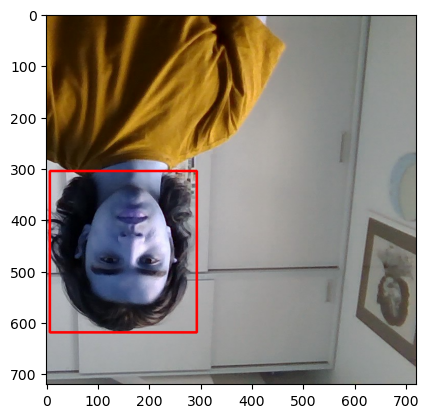

In [33]:
cv2.rectangle(aug['image'], 
              tuple(np.multiply(aug['bboxes'][0][:2], [720,720]).astype(int)),
              tuple(np.multiply(aug['bboxes'][0][2:], [720,720]).astype(int)), 
                    (255,0,0), 4)

plt.imshow(aug['image'])

In [34]:
def image_augmentor(partition,linked_dic):
    for index, item in enumerate(linked_dic):
        json_dir = "Data/Label/" + item[0]  # Path to the label JSON file
        img_dir = "Data/Image/" + item[1]  # Path to the image file
    
    
        if os.path.exists(json_dir):
            with open(json_dir, 'r') as f:
                label = json.load(f)
        else:
             print(f"Error processing {item}: File not found")
             continue
            
        # Read the image
        img = cv2.imread(img_dir)
    
        try:
            class_label = label["shapes"][0]["label"]
            for x in range(60):  # Generate 60 augmentations
                # Apply augmentation
                augmented = augmentor(image=img, bboxes=[coords], class_labels=['face'])
                # Save the augmented image
                aug_img_path = "Data/Aug_data/Image"+ f"/{partition}/" + str(index) + "_" + str(x)  + item[1]
                os.makedirs(os.path.dirname(aug_img_path), exist_ok=True)
                cv2.imwrite(aug_img_path, augmented['image'])
                
                # Prepare the annotation for the augmented image
                annotation = {}
                annotation['image'] = os.path.basename(aug_img_path)
                
                if os.path.exists(json_dir):
                    if len(augmented['bboxes']) == 0:  # No bounding boxes found
                        annotation['bbox'] = [0, 0, 0, 0]
                        annotation['class'] = 0
                    else:
                        annotation['bbox'] = augmented['bboxes'][0]
                        annotation['class'] = 1
                else:
                    annotation['bbox'] = [0, 0, 0, 0]
                    annotation['class'] = 0
                
                # Save the annotation to a JSON file
                aug_label_path = "Data/Aug_data/Label"+ f"/{partition}/" + str(index) + "_" + str(x)  + item[0]
                
                os.makedirs(os.path.dirname(aug_label_path), exist_ok=True)
                with open(aug_label_path, 'w') as f:
                    json.dump(annotation, f)
        
        except Exception as e:
            print(f"Error processing {item}: {e}")

image_augmentor("Train",train_linked_dic)
image_augmentor("Val",val_linked_dic)

In [35]:
def load_image(x): 
    byte_img = tf.io.read_file(x)
    img = tf.io.decode_jpeg(byte_img)
    return img

In [36]:
def load_labels(label_path):
    with open(label_path.numpy(), 'r', encoding = "utf-8") as f:
        label = json.load(f)
        
    return [label['class']], label['bbox']

In [37]:
train_image_df = tf.data.Dataset.list_files('Data/Aug_data/Image/Train/*.jpg', shuffle=False)
train_image_df = train_image_df.map(load_image)
train_image_df = train_image_df.map(lambda x: tf.image.resize(x, (120,120)))
train_image_df = train_image_df.map(lambda x: x/255)

In [38]:
val_image_df = tf.data.Dataset.list_files('Data/Aug_data/Image/Val/*.jpg', shuffle=False)
val_image_df = val_image_df.map(load_image)
val_image_df = val_image_df.map(lambda x: tf.image.resize(x, (120,120)))
val_image_df = val_image_df.map(lambda x: x/255)

In [39]:
train_label_df = tf.data.Dataset.list_files('Data/Aug_data/Label/Train/*.json', shuffle=False)
train_label_df = train_label_df.map(lambda x: tf.py_function(load_labels, [x], [tf.uint8, tf.float16]))

In [40]:
val_label_df = tf.data.Dataset.list_files('Data/Aug_data/Label/Val/*.json', shuffle=False)
val_label_df = val_label_df.map(lambda x: tf.py_function(load_labels, [x], [tf.uint8, tf.float16]))

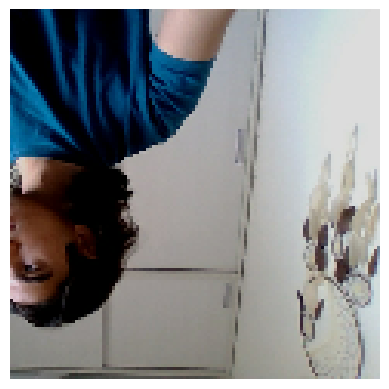

In [41]:
import matplotlib.pyplot as plt
import numpy as np

# Your array (replace this with your actual array)
data = train_image_df.as_numpy_iterator().next()

# Plot the array as an image
plt.imshow(data)
plt.axis('off')  # Hide the axis for better display
plt.show()

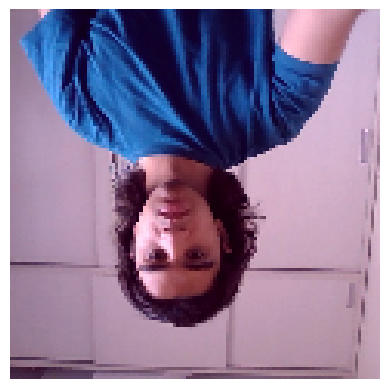

In [42]:
import matplotlib.pyplot as plt
import numpy as np

# Your array (replace this with your actual array)
data = val_image_df.as_numpy_iterator().next()

# Plot the array as an image
plt.imshow(data)
plt.axis('off')  # Hide the axis for better display
plt.show()

In [43]:
train_label_df.as_numpy_iterator().next()

(array([1], dtype=uint8),
 array([0.    , 0.424 , 0.3284, 0.8604], dtype=float16))

In [44]:
val_label_df.as_numpy_iterator().next()

(array([1], dtype=uint8),
 array([0.2676, 0.424 , 0.6646, 0.8604], dtype=float16))

In [45]:
len(train_image_df) , len(val_image_df) , len(train_label_df) , len(val_label_df)  

(3660, 1080, 3660, 1080)

In [46]:
train = tf.data.Dataset.zip((train_image_df, train_label_df))
train = train.shuffle(2000)
train = train.batch(8)
train = train.prefetch(4)

In [47]:
val = tf.data.Dataset.zip((val_image_df, val_label_df))
val = train.shuffle(500)
val = train.batch(8)
val = train.prefetch(4)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


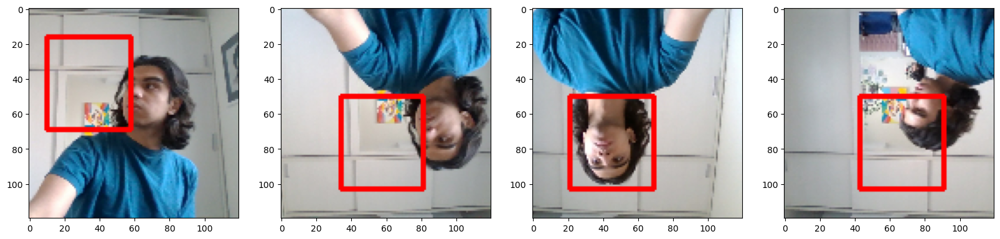

In [48]:
data_samples = train.as_numpy_iterator()
res = data_samples.next()

fig, ax = plt.subplots(ncols=4, figsize=(20,20))
for idx in range(4): 
    sample_image = np.copy(res[0][idx])
    sample_coords = np.copy(res[1][1][idx])
    cv2.rectangle(sample_image, 
                  tuple(np.multiply(sample_coords[:2], [120,120]).astype(int)),
                  tuple(np.multiply(sample_coords[2:], [120,120]).astype(int)), 
                        (255,0,0), 2)

    ax[idx].imshow(sample_image)

In [49]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, Dense, GlobalMaxPooling2D
from tensorflow.keras.applications import VGG16

In [50]:
vgg = VGG16(include_top=False)

In [51]:
vgg.summary()

Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, None, None, 3)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, None, None, 64) │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, None, None, 64) │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, None, None, 64) │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, None, None,     │        73,856 │
│                                 │ 128)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, None, None,     │       147,584 │
│                                 │ 128)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, None, None,     │             0 │
│                                 │ 128)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, None, None,     │       295,168 │
│                                 │ 256)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, None, None,     │       590,080 │
│                                 │ 256)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, None, None,     │       590,080 │
│                                 │ 256)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, None, None,     │             0 │
│                                 │ 256)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, None, None,     │     1,180,160 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, None, None,     │     2,359,808 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, None, None,     │     2,359,808 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, None, None,     │             0 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, None, None,     │     2,359,808 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, None, None,     │     2,359,808 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, None, None,     │     2,359,808 │
│                                 │ 512)                   │             

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 14,714,688 (56.13 MB)

 Non-trainable params: 0 (0.00 B)

In [52]:
def build_model(): 
    input_layer = Input(shape=(120,120,3))
    
    vgg = VGG16(include_top=False)(input_layer)

    # Classification Model  
    f1 = GlobalMaxPooling2D()(vgg)
    class1 = Dense(2048, activation='relu')(f1)
    class2 = Dense(1, activation='sigmoid',name='classification_output')(class1)
    
    # Bounding box model
    f2 = GlobalMaxPooling2D()(vgg)
    regress1 = Dense(2048, activation='relu')(f2)
    regress2 = Dense(4, activation='sigmoid', name='regression_output')(regress1)
    
    facetracker = Model(inputs=input_layer, outputs=[class2, regress2])
    return facetracker

In [53]:
model = build_model()
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 120, 120,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ vgg16 (Functional)  │ (None, 3, 3, 512) │ 14,714,688 │ input_layer_1[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_max_pooling… │ (None, 512)       │          0 │ vgg16[0][0]       │
│ (GlobalMaxPooling2… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_max_pooling… │ (None, 512)       │          0 │ vgg16[0][0]       │
│ (GlobalMaxPooling2… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense (Dense)       │ (None, 2048)      │  1,050,624 │ global_max_pooli… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_1 (Dense)     │ (None, 2048)      │  1,050,624 │ global_max_pooli… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ classification_out… │ (None, 1)         │      2,049 │ dense[0][0]       │
│ (Dense)             │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ regression_output   │ (None, 4)         │      8,196 │ dense_1[0][0]     │
│ (Dense)             │                   │            │                   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 16,826,181 (64.19 MB)

 Trainable params: 16,826,181 (64.19 MB)

 Non-trainable params: 0 (0.00 B)

In [54]:
x_train, y_train = train.as_numpy_iterator().next()
x_val, y_val = val.as_numpy_iterator().next()

In [55]:
model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
        loss={
            "classification_output": "binary_crossentropy",
            "regression_output": "mse"
        },
        metrics={
            "classification_output": ["accuracy"],
            "regression_output": ["mae"]
        }
    )

In [56]:
hist = model.fit(x_train,y_train,epochs=50)

Epoch 1/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - classification_output_accuracy: 0.5000 - classification_output_loss: 0.7046 - loss: 0.8068 - regression_output_loss: 0.1021 - regression_output_mae: 0.2625
Epoch 2/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step - classification_output_accuracy: 1.0000 - classification_output_loss: 0.0419 - loss: 0.1039 - regression_output_loss: 0.0620 - regression_output_mae: 0.2067
Epoch 3/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 417ms/step - classification_output_accuracy: 1.0000 - classification_output_loss: 0.0014 - loss: 0.0458 - regression_output_loss: 0.0444 - regression_output_mae: 0.1721
Epoch 4/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 400ms/step - classification_output_accuracy: 1.0000 - classification_output_loss: 2.8856e-04 - loss: 0.0270 - regression_output_loss: 0.0267 - regression_output_mae: 0.1265
Epoch 5/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 413ms/step - classification_output_accuracy: 1.0000 - classification_output_loss: 1.1253e-04 - loss: 0.0137 - regression_output_

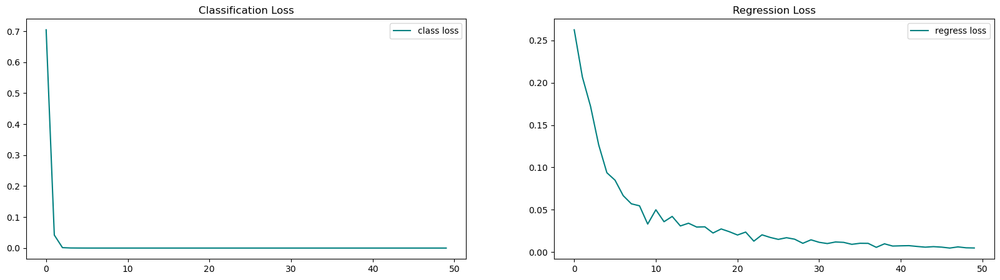

In [60]:
fig, ax = plt.subplots(ncols=2, figsize=(20,5))
ax[0].plot(hist.history['classification_output_loss'], color='teal', label='class loss')
ax[0].title.set_text('Classification Loss')
ax[0].legend()

ax[1].plot(hist.history['regression_output_mae'], color='teal', label='regress loss')
ax[1].title.set_text('Regression Loss')
ax[1].legend()

plt.show()

In [62]:
val_data = val.as_numpy_iterator()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999046],
       [0.99999994],
       [0.9999984 ],
       [0.9999987 ],
       [0.9999882 ],
       [0.99999946],
       [0.99999994],
       [0.9999934 ]], dtype=float32), array([[0.1971994 , 0.29061708, 0.6953851 , 0.54660994],
       [0.11246353, 0.24806389, 0.5861516 , 0.4694172 ],
       [0.6425754 , 0.44309416, 0.9846656 , 0.86082226],
       [0.22975737, 0.150509  , 0.7224531 , 0.54424214],
       [0.31679332, 0.35701758, 0.8113677 , 0.7599779 ],
       [0.06873342, 0.43150902, 0.49479112, 0.78324336],
       [0.03355841, 0.44553068, 0.5273108 , 0.8304221 ],
       [0.5943359 , 0.3621704 , 0.9650835 , 0.82752985]], dtype=float32)]


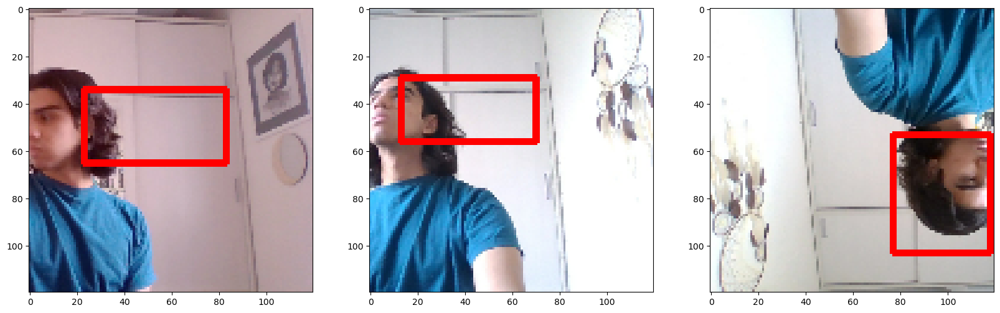

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999994],
       [1.        ],
       [0.99998915],
       [0.99999857],
       [0.9999934 ],
       [0.99999917],
       [0.9999551 ],
       [0.99999905]], dtype=float32), array([[0.16454247, 0.18456653, 0.6418835 , 0.5130024 ],
       [0.02867309, 0.44103745, 0.54393065, 0.8204889 ],
       [0.44848883, 0.44413215, 0.9053352 , 0.7712625 ],
       [0.22509639, 0.4233794 , 0.7041444 , 0.82727396],
       [0.24894753, 0.36473662, 0.7555655 , 0.77243227],
       [0.21885726, 0.10319115, 0.659798  , 0.60328066],
       [0.61021   , 0.3840524 , 0.97154987, 0.7885403 ],
       [0.14737323, 0.15626353, 0.64993215, 0.53697824]], dtype=float32)]


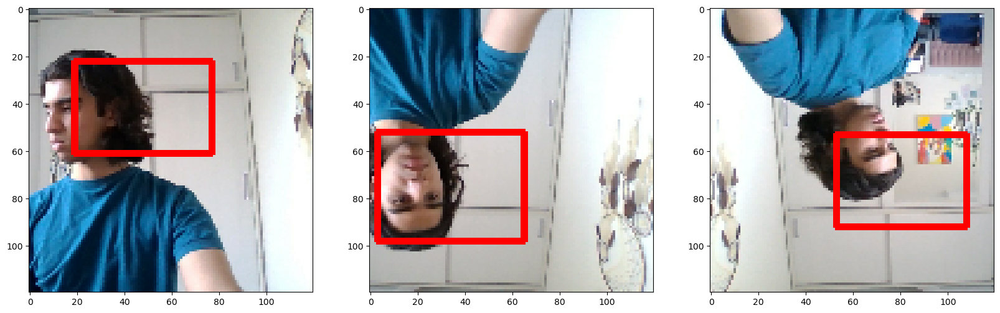

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999967 ],
       [0.9999877 ],
       [0.99996996],
       [0.99999297],
       [0.9999982 ],
       [0.9999998 ],
       [0.9999937 ],
       [0.9999632 ]], dtype=float32), array([[0.542301  , 0.39421117, 0.9565462 , 0.8539402 ],
       [0.3209034 , 0.41336212, 0.8742494 , 0.77497977],
       [0.5120379 , 0.23779374, 0.9700135 , 0.59611464],
       [0.5168991 , 0.2286447 , 0.92582774, 0.61867654],
       [0.60044736, 0.40005088, 0.9791262 , 0.8755436 ],
       [0.12753613, 0.14747538, 0.5752325 , 0.59441024],
       [0.3349029 , 0.3597878 , 0.911649  , 0.8374427 ],
       [0.5152041 , 0.3020165 , 0.92555934, 0.62154144]], dtype=float32)]


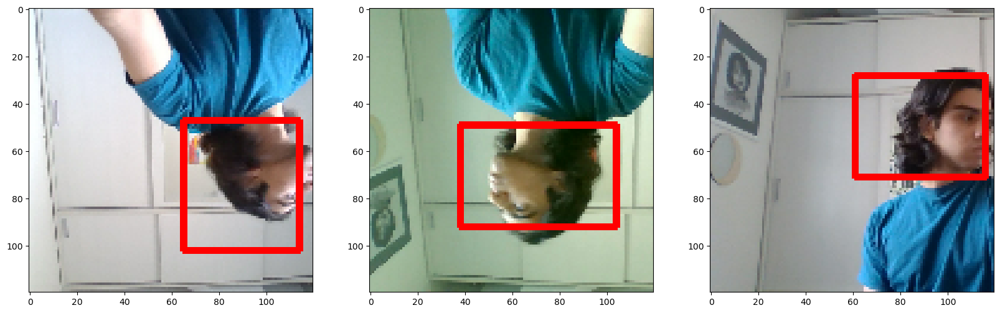

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999946],
       [0.99999595],
       [0.9999978 ],
       [0.99999934],
       [0.9999963 ],
       [0.99998677],
       [0.99979347],
       [0.99999315]], dtype=float32), array([[0.16538337, 0.11865578, 0.60555154, 0.5882834 ],
       [0.2537557 , 0.16687313, 0.6723899 , 0.55586374],
       [0.5142362 , 0.3680251 , 0.93007416, 0.84463626],
       [0.41812295, 0.339325  , 0.89077395, 0.85128856],
       [0.27979708, 0.37503153, 0.8660115 , 0.8713361 ],
       [0.40919754, 0.38936183, 0.93101203, 0.8023415 ],
       [0.3898624 , 0.33772945, 0.9154645 , 0.6302004 ],
       [0.48664168, 0.18526144, 0.94974697, 0.59228003]], dtype=float32)]


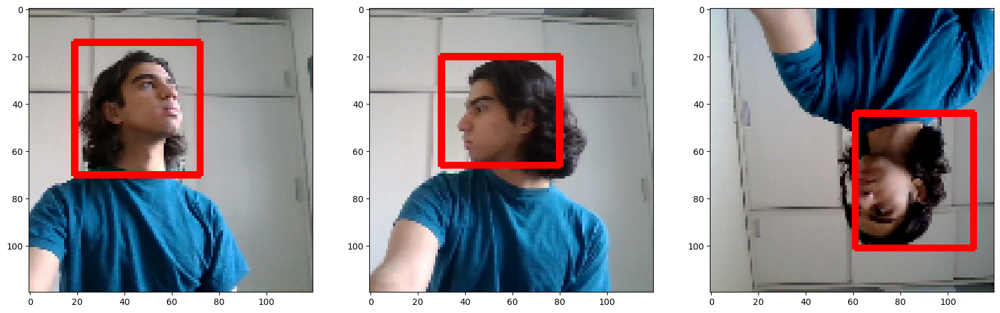

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999803],
       [0.9999998 ],
       [0.99999607],
       [0.9999289 ],
       [0.99998164],
       [0.99874353],
       [0.99989694],
       [0.9999978 ]], dtype=float32), array([[0.18002011, 0.21885954, 0.6911988 , 0.5085362 ],
       [0.164474  , 0.1151433 , 0.7124847 , 0.5379835 ],
       [0.1631307 , 0.41225126, 0.67363703, 0.74870527],
       [0.35139868, 0.3437149 , 0.85716176, 0.6986195 ],
       [0.2781661 , 0.27568012, 0.7312491 , 0.5404116 ],
       [0.4251481 , 0.41790044, 0.86544317, 0.55877787],
       [0.41032228, 0.35904062, 0.9096504 , 0.72990644],
       [0.10929736, 0.44334003, 0.5465182 , 0.8117969 ]], dtype=float32)]


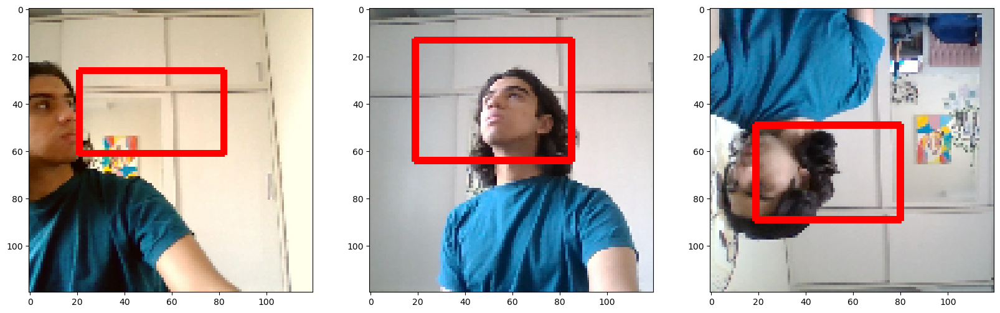

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999993 ],
       [0.99999934],
       [0.99996996],
       [0.99999934],
       [0.99998677],
       [0.9999997 ],
       [0.999631  ],
       [0.99999964]], dtype=float32), array([[0.20811777, 0.12282974, 0.61974263, 0.5942115 ],
       [0.51053333, 0.20159122, 0.9230053 , 0.62114894],
       [0.45533192, 0.3925094 , 0.94345975, 0.79837614],
       [0.19239022, 0.1136778 , 0.642938  , 0.5905702 ],
       [0.41028592, 0.40209788, 0.9333815 , 0.79343796],
       [0.19588627, 0.08970331, 0.58589816, 0.57650065],
       [0.45077506, 0.31705886, 0.91580063, 0.5500312 ],
       [0.3406005 , 0.11129582, 0.8552414 , 0.5919529 ]], dtype=float32)]


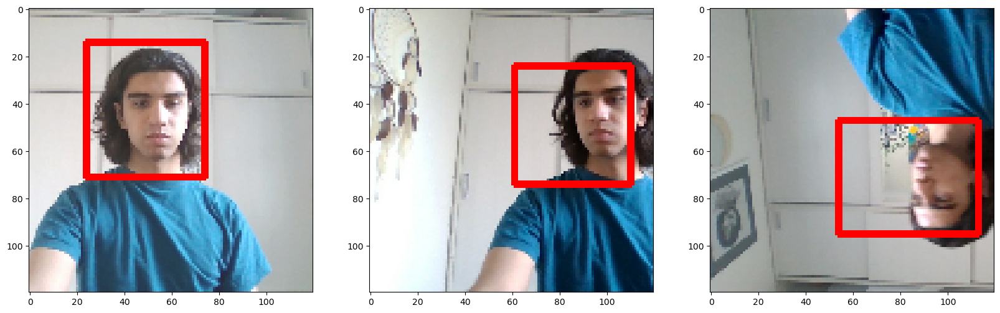

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999887],
       [0.99999976],
       [0.99999636],
       [0.9999984 ],
       [0.9999995 ],
       [0.99996734],
       [0.9999968 ],
       [0.99999976]], dtype=float32), array([[0.16762584, 0.15498672, 0.5641327 , 0.56642145],
       [0.403084  , 0.13939536, 0.8439808 , 0.61786044],
       [0.25767207, 0.17571184, 0.7593286 , 0.5345476 ],
       [0.1230034 , 0.35876915, 0.5781921 , 0.8077802 ],
       [0.09957037, 0.49139875, 0.70429164, 0.7897104 ],
       [0.5150433 , 0.26331046, 0.95852745, 0.65135175],
       [0.39999536, 0.15666667, 0.8681848 , 0.56642973],
       [0.15493621, 0.27463907, 0.6540054 , 0.46064058]], dtype=float32)]


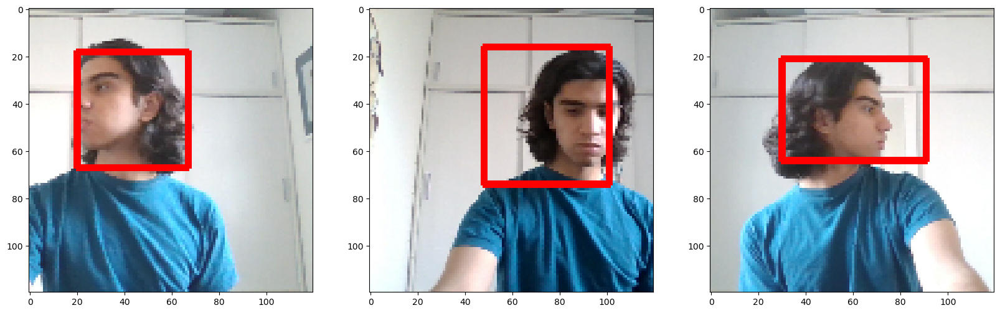

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999982],
       [0.9999986],
       [0.9999986],
       [0.9999991],
       [0.9999986],
       [0.9999482],
       [0.9997787],
       [0.9999785]], dtype=float32), array([[0.17090762, 0.25046566, 0.7105682 , 0.48453334],
       [0.10556243, 0.37696177, 0.55484396, 0.7962763 ],
       [0.20717345, 0.14750738, 0.60166144, 0.5664436 ],
       [0.44465336, 0.12478275, 0.9234828 , 0.6113858 ],
       [0.18634845, 0.34495345, 0.7496075 , 0.8347851 ],
       [0.19585834, 0.23892017, 0.7219091 , 0.5239817 ],
       [0.47773495, 0.38545856, 0.93104595, 0.7214443 ],
       [0.47921142, 0.3628566 , 0.9464729 , 0.7961062 ]], dtype=float32)]


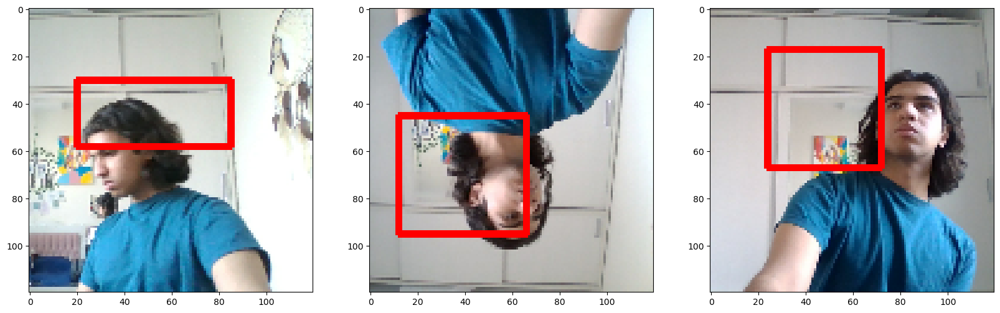

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999921 ],
       [0.99999887],
       [0.9999933 ],
       [0.99999946],
       [0.9999507 ],
       [0.99999946],
       [0.99999803],
       [0.9999771 ]], dtype=float32), array([[0.31222102, 0.3669273 , 0.8376487 , 0.76885986],
       [0.0744023 , 0.38990155, 0.49963105, 0.81471914],
       [0.2237071 , 0.45316133, 0.78789467, 0.7411161 ],
       [0.10384113, 0.16982004, 0.6074384 , 0.58601916],
       [0.6606479 , 0.38058993, 0.97395307, 0.80483425],
       [0.36712167, 0.11992969, 0.8215617 , 0.539863  ],
       [0.6413423 , 0.45939183, 0.9857091 , 0.86615163],
       [0.18097627, 0.22692789, 0.69841623, 0.6217266 ]], dtype=float32)]


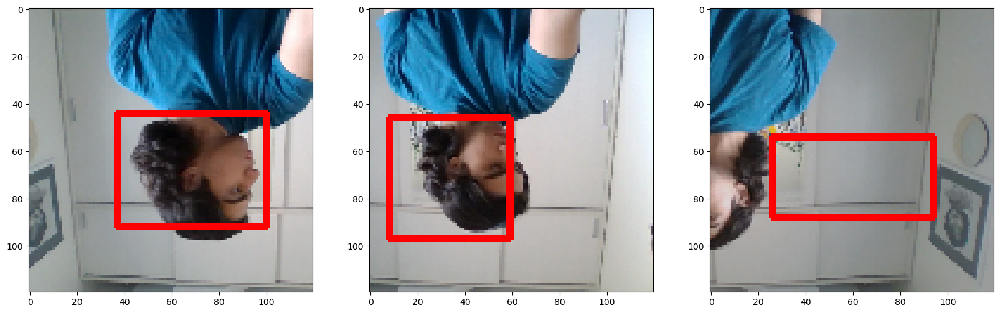

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999946],
       [0.9999491 ],
       [0.9997891 ],
       [0.99996287],
       [0.99999976],
       [0.9999975 ],
       [0.99999934],
       [0.99999285]], dtype=float32), array([[0.10445986, 0.398002  , 0.5970409 , 0.86951494],
       [0.4034658 , 0.25620255, 0.8847053 , 0.51610434],
       [0.4928374 , 0.40466884, 0.9181443 , 0.6916883 ],
       [0.23941167, 0.34757003, 0.8339349 , 0.6994026 ],
       [0.03639673, 0.42817307, 0.5033535 , 0.82749045],
       [0.17429274, 0.39192456, 0.66087914, 0.791792  ],
       [0.10521716, 0.3926034 , 0.58841   , 0.84574425],
       [0.62871206, 0.4046971 , 0.97752655, 0.8121775 ]], dtype=float32)]


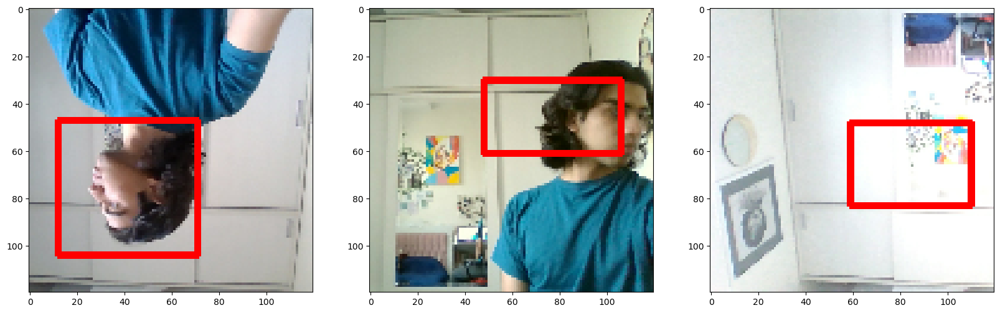

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999774],
       [0.9999991 ],
       [0.99999934],
       [0.9999992 ],
       [0.99999803],
       [0.9999979 ],
       [0.9999997 ],
       [0.99999964]], dtype=float32), array([[0.5821613 , 0.4325643 , 0.98068905, 0.8571434 ],
       [0.5883938 , 0.38619584, 0.9676942 , 0.8650079 ],
       [0.10051524, 0.15721057, 0.46573988, 0.5736313 ],
       [0.10436349, 0.20543016, 0.529688  , 0.5654646 ],
       [0.16855428, 0.19702838, 0.63502586, 0.5057794 ],
       [0.6693241 , 0.41671887, 0.98543876, 0.8752925 ],
       [0.15849221, 0.45228478, 0.6724999 , 0.79085726],
       [0.16776514, 0.12053473, 0.5415245 , 0.57693565]], dtype=float32)]


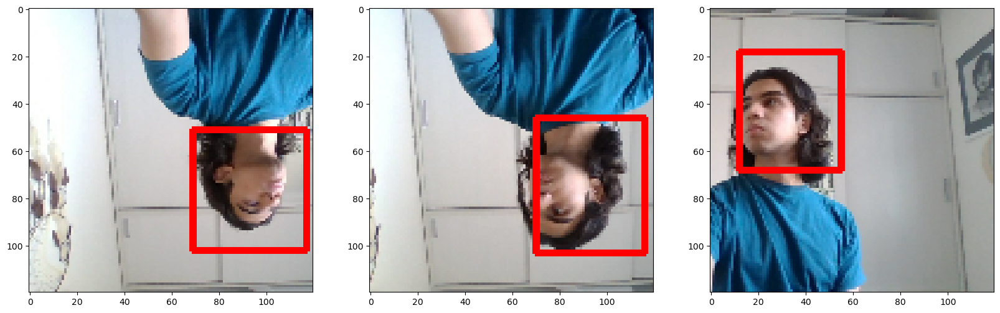

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999823 ],
       [0.9999967 ],
       [0.9999969 ],
       [0.99999434],
       [0.9999996 ],
       [0.9999942 ],
       [0.9999993 ],
       [0.99999756]], dtype=float32), array([[0.11436916, 0.38105437, 0.5633258 , 0.70012885],
       [0.423501  , 0.39768186, 0.9390733 , 0.80331314],
       [0.4688652 , 0.1778878 , 0.8962925 , 0.5960041 ],
       [0.16610211, 0.39276305, 0.7244216 , 0.70311505],
       [0.38789105, 0.11922621, 0.8785713 , 0.5568869 ],
       [0.47623757, 0.4210395 , 0.9469277 , 0.78884864],
       [0.17741814, 0.48515892, 0.67600834, 0.77822125],
       [0.35446498, 0.16384198, 0.8054881 , 0.5573369 ]], dtype=float32)]


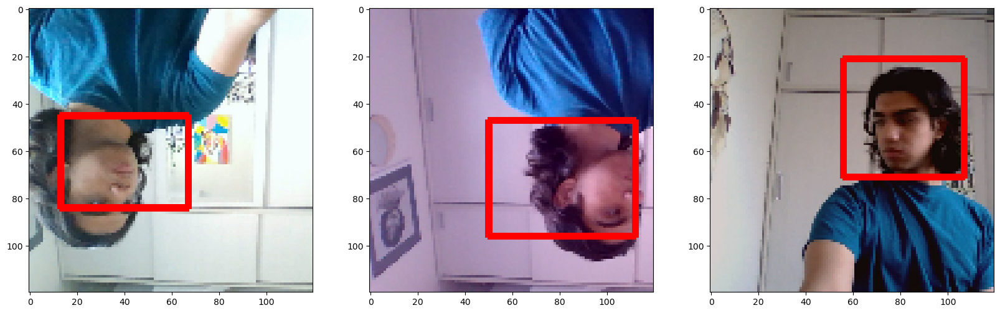

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999774],
       [0.99999875],
       [0.99998695],
       [0.99999934],
       [0.999995  ],
       [0.9999125 ],
       [0.99999964],
       [0.9999825 ]], dtype=float32), array([[0.18249038, 0.17873242, 0.62881804, 0.5365788 ],
       [0.15128963, 0.4444485 , 0.6158648 , 0.85428286],
       [0.43907976, 0.3705289 , 0.94228065, 0.8009691 ],
       [0.15901789, 0.12908132, 0.57705486, 0.5555505 ],
       [0.14419402, 0.21479513, 0.62622166, 0.52253425],
       [0.3752684 , 0.3683245 , 0.8919016 , 0.6889901 ],
       [0.2665804 , 0.1279009 , 0.7773832 , 0.5612486 ],
       [0.43182147, 0.35486782, 0.9441962 , 0.81333745]], dtype=float32)]


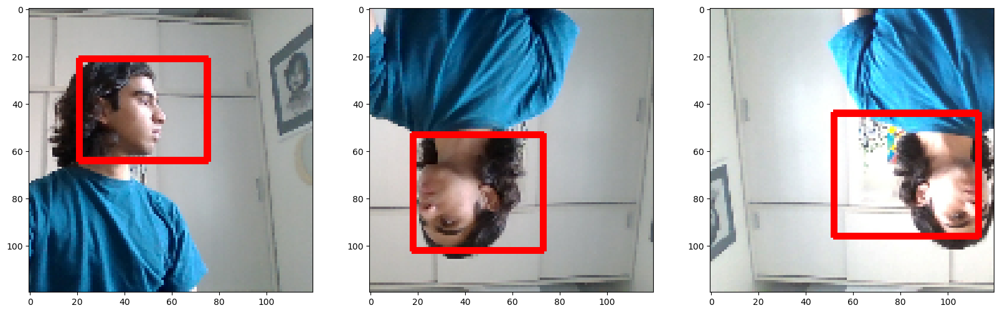

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999963 ],
       [0.9999876 ],
       [0.9999989 ],
       [0.9999996 ],
       [0.99999535],
       [0.9999981 ],
       [0.9999998 ],
       [0.99969697]], dtype=float32), array([[0.10835444, 0.43537578, 0.5873222 , 0.7676717 ],
       [0.62487304, 0.41138175, 0.9724251 , 0.8102306 ],
       [0.46141285, 0.1452192 , 0.889394  , 0.6091269 ],
       [0.2786472 , 0.09785786, 0.7301873 , 0.5758251 ],
       [0.1636072 , 0.23880644, 0.619809  , 0.55129254],
       [0.14169745, 0.4975285 , 0.6891037 , 0.7697018 ],
       [0.24980585, 0.11629336, 0.73723567, 0.5937526 ],
       [0.42072022, 0.33767623, 0.9068161 , 0.65276563]], dtype=float32)]


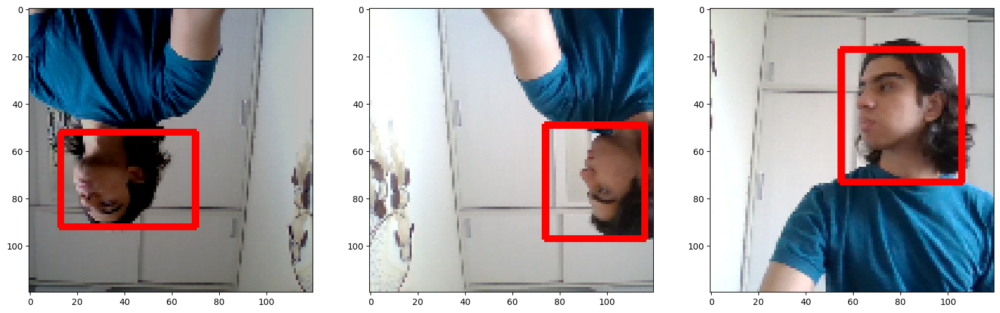

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999607],
       [0.999999  ],
       [0.9999963 ],
       [0.9999827 ],
       [0.99998397],
       [0.9999844 ],
       [0.9999923 ],
       [0.9999988 ]], dtype=float32), array([[0.45300233, 0.1644269 , 0.9397732 , 0.59103304],
       [0.27426484, 0.14555429, 0.8117459 , 0.6028923 ],
       [0.21388805, 0.24090992, 0.6662574 , 0.545176  ],
       [0.25823954, 0.37804294, 0.82767004, 0.8174608 ],
       [0.5172999 , 0.26442552, 0.9612783 , 0.6382842 ],
       [0.6807522 , 0.39162838, 0.97763264, 0.8342025 ],
       [0.43094745, 0.41940314, 0.90447   , 0.77036625],
       [0.19143182, 0.10650421, 0.6081823 , 0.5714038 ]], dtype=float32)]


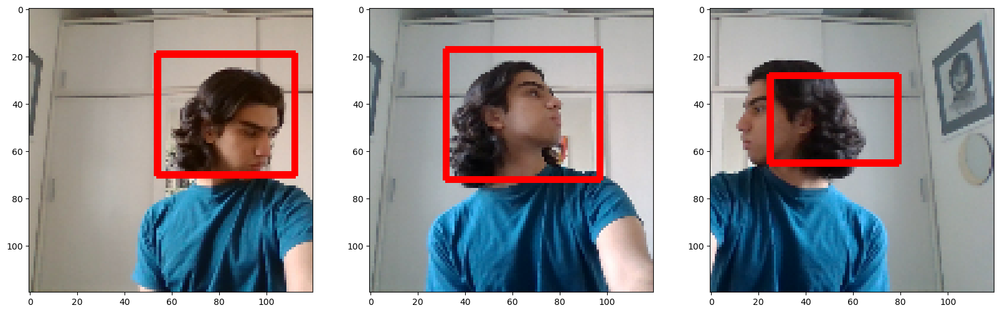

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999966 ],
       [0.9986561 ],
       [0.99892545],
       [0.99996525],
       [0.99999994],
       [0.99997276],
       [0.9999995 ],
       [0.99974036]], dtype=float32), array([[0.19359466, 0.14189015, 0.6322021 , 0.57526654],
       [0.423523  , 0.4182126 , 0.86745685, 0.5499786 ],
       [0.42324278, 0.3751898 , 0.91142356, 0.71409214],
       [0.48105362, 0.37325218, 0.94272906, 0.8035583 ],
       [0.10813949, 0.19657326, 0.5093792 , 0.48214462],
       [0.29054987, 0.35681796, 0.7860371 , 0.7196413 ],
       [0.11415587, 0.2203007 , 0.5685687 , 0.47254896],
       [0.33607763, 0.38994965, 0.8597106 , 0.69716954]], dtype=float32)]


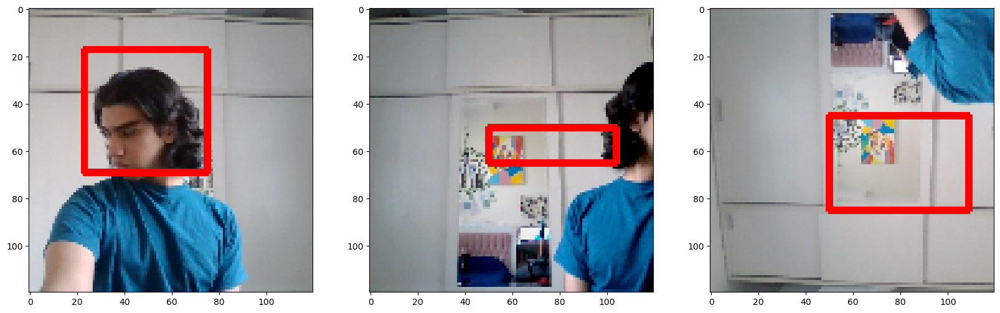

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999822 ],
       [0.9999996 ],
       [0.9996215 ],
       [0.999819  ],
       [0.9999783 ],
       [0.9999994 ],
       [0.99999034],
       [0.9999966 ]], dtype=float32), array([[0.42343837, 0.37890217, 0.9234713 , 0.8102852 ],
       [0.05848101, 0.38280144, 0.40182656, 0.84864813],
       [0.4908361 , 0.39136   , 0.93224955, 0.68828887],
       [0.3837114 , 0.28910598, 0.8821174 , 0.50847876],
       [0.61009824, 0.38109627, 0.97331864, 0.80473167],
       [0.2762295 , 0.09605951, 0.7302437 , 0.56993234],
       [0.49029395, 0.24519202, 0.96235186, 0.62362367],
       [0.20843455, 0.17293109, 0.664887  , 0.5525913 ]], dtype=float32)]


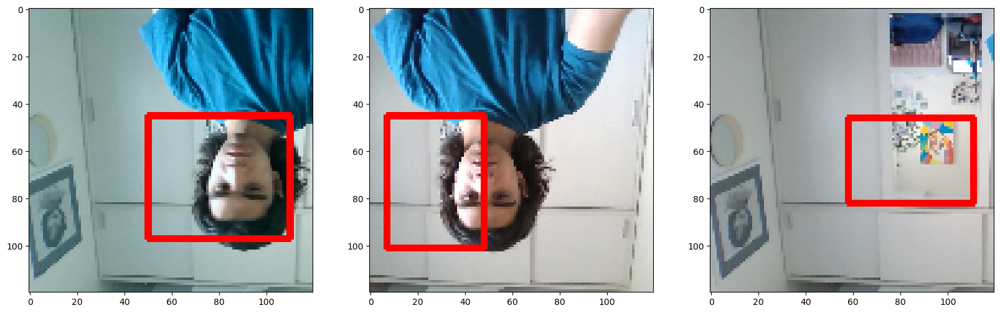

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999542 ],
       [0.99998087],
       [0.9996539 ],
       [0.9999986 ],
       [0.9999986 ],
       [0.99999833],
       [0.9999993 ],
       [0.9999955 ]], dtype=float32), array([[0.32995862, 0.33879283, 0.84852463, 0.7078074 ],
       [0.49211648, 0.24055089, 0.9165748 , 0.6155027 ],
       [0.37866798, 0.38454697, 0.8800853 , 0.68520236],
       [0.5231948 , 0.37178463, 0.93594956, 0.85227704],
       [0.15467368, 0.43690872, 0.63654447, 0.8235097 ],
       [0.12410869, 0.4456255 , 0.71645653, 0.76031816],
       [0.18397379, 0.18073407, 0.67305845, 0.55338496],
       [0.48273903, 0.23705919, 0.91676146, 0.61115277]], dtype=float32)]


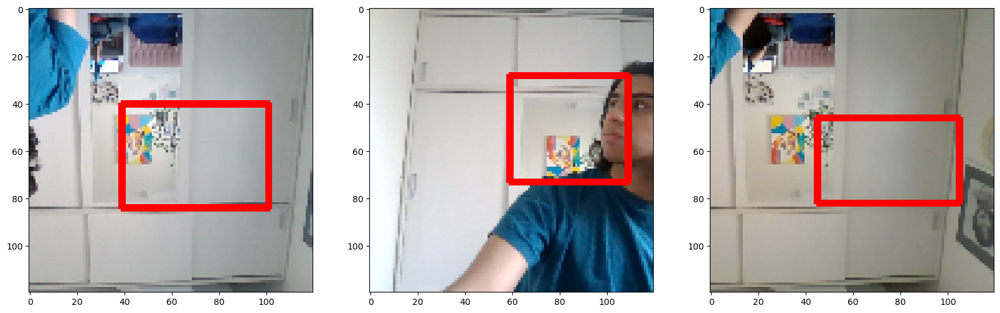

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999833],
       [0.99999976],
       [0.99999976],
       [0.9999989 ],
       [0.9999845 ],
       [0.99999833],
       [0.9999996 ],
       [0.99999654]], dtype=float32), array([[0.14858536, 0.40903813, 0.6136973 , 0.81891817],
       [0.28518036, 0.12316464, 0.82183945, 0.5906257 ],
       [0.03128709, 0.4284415 , 0.3745536 , 0.8395575 ],
       [0.13151768, 0.44561738, 0.4823914 , 0.85348356],
       [0.6175443 , 0.41878444, 0.97492903, 0.8217437 ],
       [0.28967887, 0.36477238, 0.76976115, 0.85816306],
       [0.1401237 , 0.1534336 , 0.6097698 , 0.512002  ],
       [0.5052818 , 0.22437632, 0.9173133 , 0.6065552 ]], dtype=float32)]


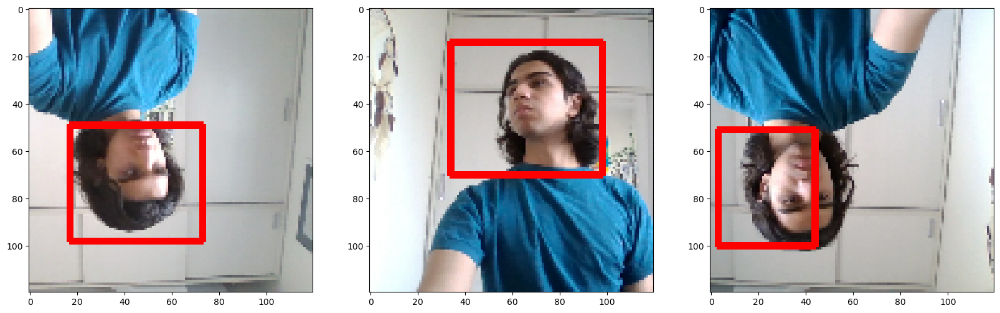

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999875 ],
       [0.99999887],
       [0.9999999 ],
       [0.99999475],
       [0.9995021 ],
       [0.9999999 ],
       [0.99999666],
       [0.99999917]], dtype=float32), array([[0.5822815 , 0.19366795, 0.9762133 , 0.6049609 ],
       [0.29535306, 0.10397055, 0.77066433, 0.5896001 ],
       [0.12912436, 0.17878053, 0.60884124, 0.53833795],
       [0.48520684, 0.1800422 , 0.9454855 , 0.64055   ],
       [0.5008918 , 0.3600826 , 0.93421394, 0.7043419 ],
       [0.15619864, 0.28311458, 0.6225159 , 0.47662437],
       [0.15548742, 0.4706718 , 0.6770526 , 0.7440649 ],
       [0.39950624, 0.36440507, 0.89619344, 0.85598075]], dtype=float32)]


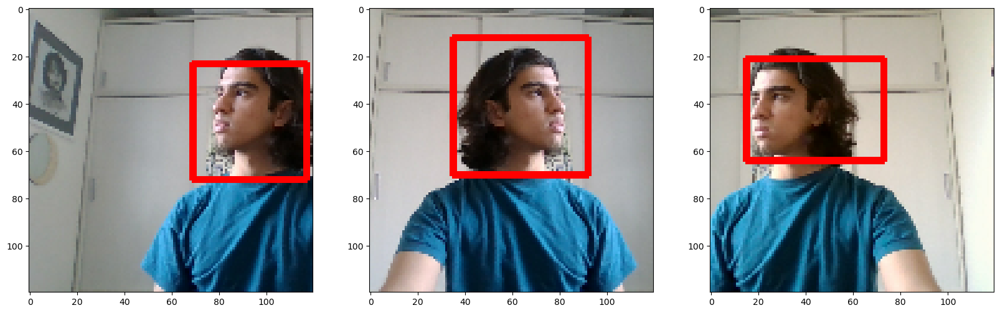

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999785],
       [0.9999818 ],
       [0.9999996 ],
       [0.99999946],
       [0.9999998 ],
       [0.99999976],
       [0.99999607],
       [0.9999993 ]], dtype=float32), array([[0.14134182, 0.21657702, 0.5147871 , 0.537046  ],
       [0.1763771 , 0.22527906, 0.6620935 , 0.55756193],
       [0.4681742 , 0.14969687, 0.88567495, 0.6246505 ],
       [0.2166356 , 0.1320635 , 0.72091484, 0.55497634],
       [0.24719426, 0.11007622, 0.78818905, 0.57468045],
       [0.2761632 , 0.11981143, 0.7635573 , 0.6068951 ],
       [0.16617432, 0.20253806, 0.5800173 , 0.5587974 ],
       [0.11375231, 0.5089202 , 0.59603006, 0.7957263 ]], dtype=float32)]


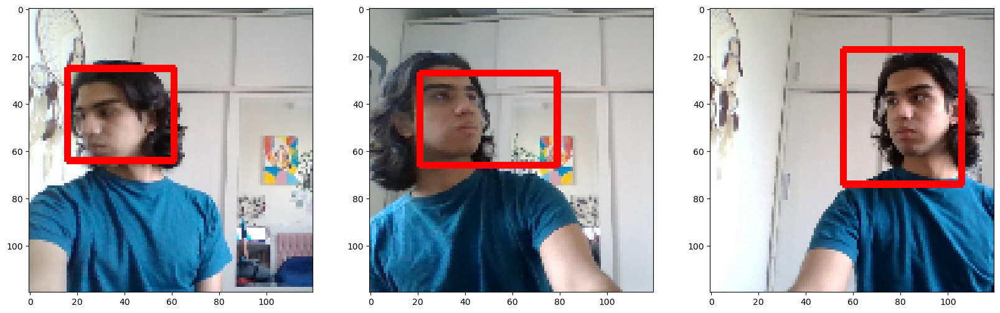

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999996 ],
       [0.9999721 ],
       [0.9999998 ],
       [0.9999734 ],
       [0.9999959 ],
       [0.99999917],
       [0.99999905],
       [0.9998759 ]], dtype=float32), array([[0.13089031, 0.48441607, 0.60161465, 0.7977677 ],
       [0.57608867, 0.3660144 , 0.97680736, 0.8101295 ],
       [0.06423476, 0.4008753 , 0.49118423, 0.8336112 ],
       [0.55104774, 0.24106418, 0.9708898 , 0.6252108 ],
       [0.27325758, 0.41883832, 0.7522189 , 0.8067549 ],
       [0.0968238 , 0.4829045 , 0.56205994, 0.8089083 ],
       [0.15863492, 0.42777458, 0.61690027, 0.8510859 ],
       [0.29050672, 0.35076964, 0.7131461 , 0.6081276 ]], dtype=float32)]


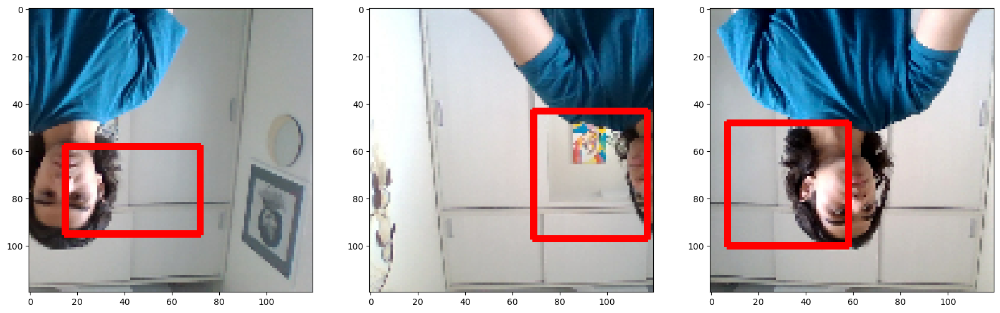

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999523],
       [0.9993975 ],
       [0.9999996 ],
       [0.9991308 ],
       [0.99999905],
       [0.99999654],
       [0.9987705 ],
       [1.        ]], dtype=float32), array([[0.15069446, 0.46481988, 0.6460414 , 0.7350682 ],
       [0.47776657, 0.3711938 , 0.93301904, 0.7057847 ],
       [0.4367245 , 0.14300741, 0.87508094, 0.62434745],
       [0.4342193 , 0.37140998, 0.90952337, 0.70501155],
       [0.48952174, 0.34869975, 0.9265193 , 0.84879684],
       [0.2681115 , 0.41617697, 0.80658126, 0.79833865],
       [0.47395116, 0.34907287, 0.9188112 , 0.6128149 ],
       [0.08346415, 0.19506477, 0.45388484, 0.5334895 ]], dtype=float32)]


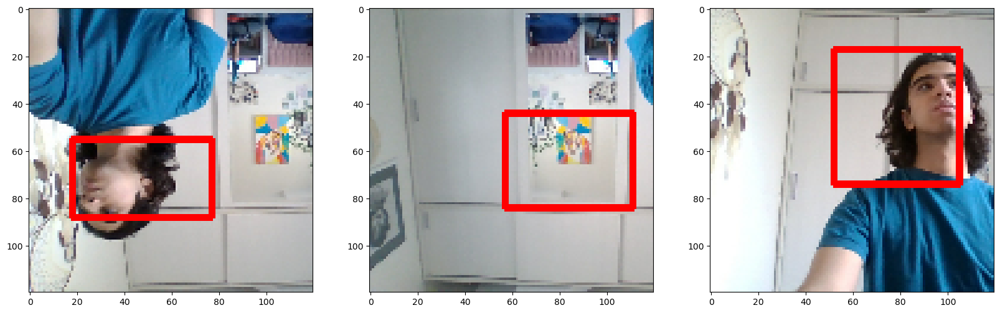

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999943 ],
       [0.9999988 ],
       [0.99996173],
       [0.99999887],
       [0.99999535],
       [0.99999887],
       [0.9999992 ],
       [0.9999987 ]], dtype=float32), array([[0.18689369, 0.20685902, 0.73431337, 0.5632849 ],
       [0.14827499, 0.39744142, 0.6737374 , 0.84416866],
       [0.22328533, 0.39560133, 0.7303567 , 0.701421  ],
       [0.08295061, 0.42454338, 0.5962675 , 0.7672347 ],
       [0.19557694, 0.37945578, 0.6056725 , 0.7792434 ],
       [0.58610487, 0.4697381 , 0.9721269 , 0.86825293],
       [0.1269623 , 0.4603405 , 0.63109946, 0.8328767 ],
       [0.0937226 , 0.37747735, 0.52804875, 0.79460764]], dtype=float32)]


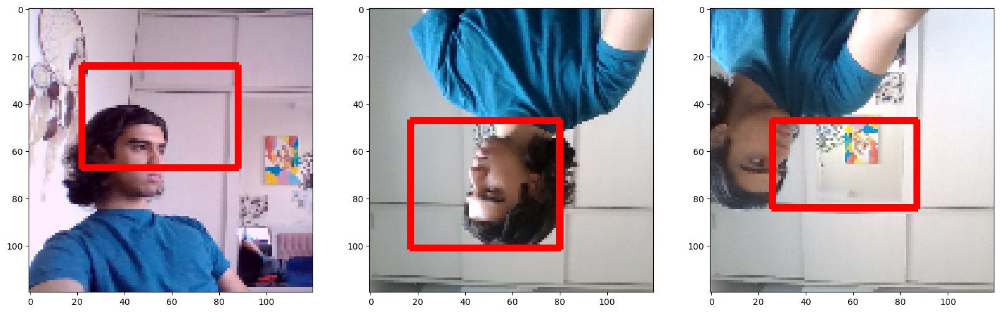

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999991 ],
       [0.9999999 ],
       [0.9999253 ],
       [0.99999905],
       [0.9999668 ],
       [0.9999905 ],
       [0.99999845],
       [0.9999997 ]], dtype=float32), array([[0.5132674 , 0.15509298, 0.9345789 , 0.6044233 ],
       [0.18055828, 0.10152251, 0.6863531 , 0.58874327],
       [0.503532  , 0.31742683, 0.9203208 , 0.62415147],
       [0.12608133, 0.22855364, 0.63228834, 0.5577772 ],
       [0.6092708 , 0.3840185 , 0.97243273, 0.79331636],
       [0.2674987 , 0.3208748 , 0.8281381 , 0.7275548 ],
       [0.0923259 , 0.3625888 , 0.53382146, 0.83183587],
       [0.43705156, 0.1193241 , 0.8902991 , 0.6011455 ]], dtype=float32)]


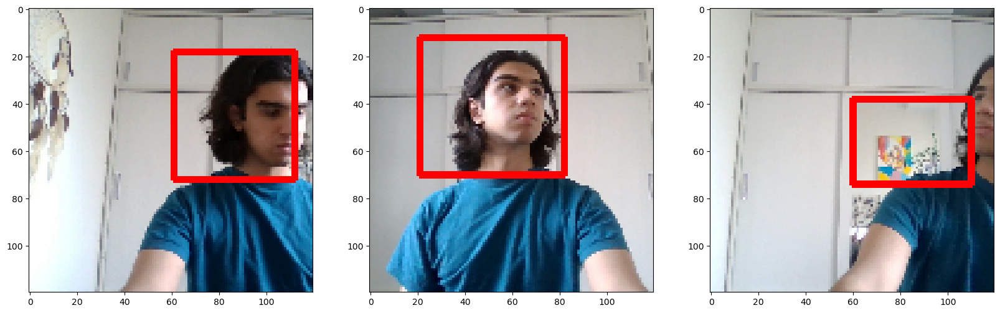

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
[array([[0.99999833],
       [0.99999154],
       [0.99968165],
       [0.99999654],
       [0.99999934],
       [0.99999774],
       [0.99999803],
       [0.99999905]], dtype=float32), array([[0.15168597, 0.39494708, 0.69076395, 0.8465295 ],
       [0.29394618, 0.33271152, 0.836433  , 0.70512176],
       [0.40908292, 0.3499084 , 0.9113879 , 0.64789724],
       [0.2076562 , 0.22465314, 0.7153355 , 0.50520265],
       [0.2947079 , 0.12730639, 0.79765004, 0.5708315 ],
       [0.24874893, 0.22095495, 0.7323583 , 0.56214935],
       [0.156388  , 0.36416674, 0.6900448 , 0.8341867 ],
       [0.08967972, 0.44682798, 0.68000233, 0.7617284 ]], dtype=float32)]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


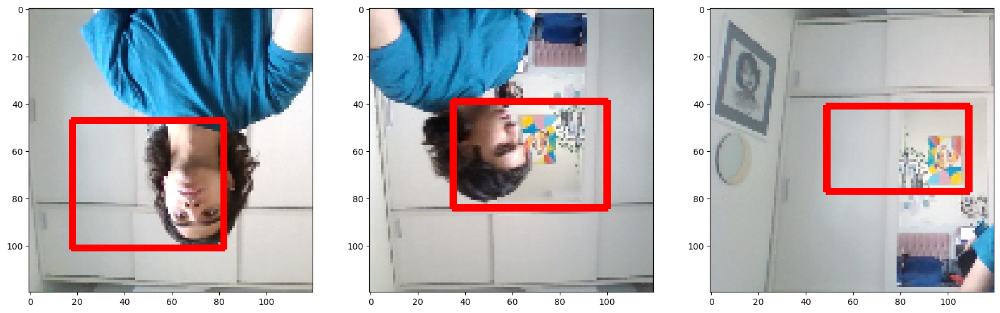

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[1.        ],
       [0.9999977 ],
       [0.999999  ],
       [0.99999875],
       [0.9999999 ],
       [0.999996  ],
       [0.9999785 ],
       [0.99994916]], dtype=float32), array([[0.12688324, 0.21179414, 0.6788784 , 0.50970435],
       [0.12779608, 0.18231118, 0.5256135 , 0.5449226 ],
       [0.14977154, 0.1581721 , 0.6297685 , 0.53121316],
       [0.20340328, 0.11652108, 0.6550854 , 0.57288396],
       [0.0270699 , 0.40774688, 0.38305473, 0.8477492 ],
       [0.37826797, 0.36106682, 0.85840416, 0.8224979 ],
       [0.30202755, 0.402773  , 0.88079554, 0.7078612 ],
       [0.3426422 , 0.390813  , 0.8630085 , 0.6958819 ]], dtype=float32)]


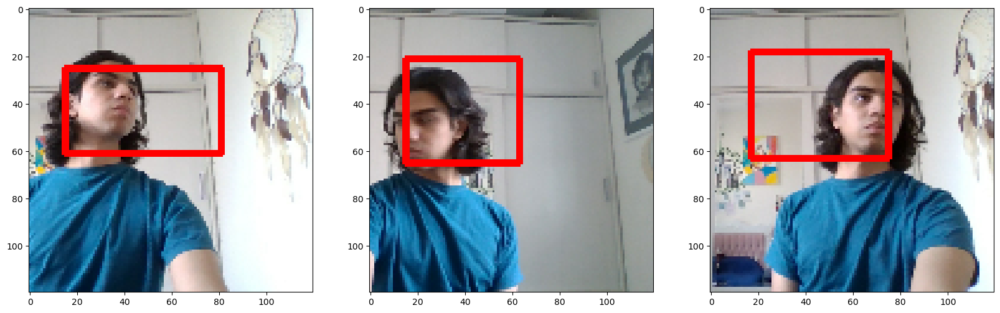

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999917],
       [0.9999985 ],
       [0.9999987 ],
       [0.99999994],
       [0.9999963 ],
       [0.99999833],
       [0.9999783 ],
       [0.99999917]], dtype=float32), array([[0.28064382, 0.1515141 , 0.77709115, 0.5585686 ],
       [0.5271114 , 0.21679768, 0.9216452 , 0.64302075],
       [0.10819411, 0.36544964, 0.5923226 , 0.82542837],
       [0.17821793, 0.23823781, 0.70199805, 0.5512785 ],
       [0.32188788, 0.1681422 , 0.7951353 , 0.56402063],
       [0.55990857, 0.13879971, 0.96434414, 0.5922375 ],
       [0.48365554, 0.4129562 , 0.94668037, 0.8093693 ],
       [0.08189433, 0.40534022, 0.4883804 , 0.83678937]], dtype=float32)]


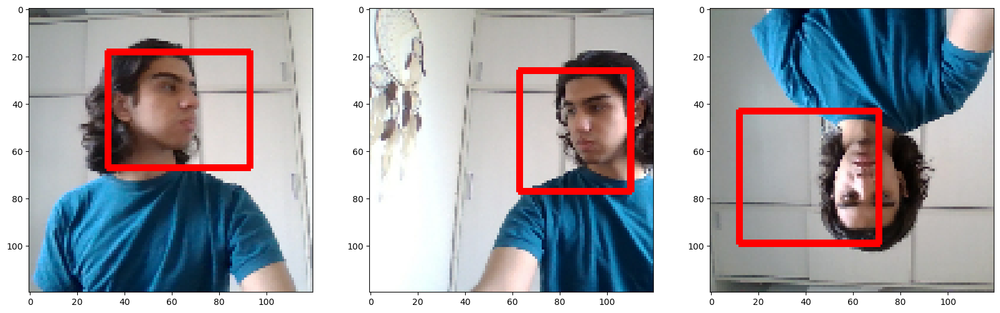

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999976],
       [0.9999989 ],
       [0.9999979 ],
       [0.9999988 ],
       [0.9999989 ],
       [0.99999875],
       [0.9999991 ],
       [0.99972385]], dtype=float32), array([[0.04985426, 0.40926176, 0.53385925, 0.8012471 ],
       [0.09496303, 0.42688668, 0.52537394, 0.84118533],
       [0.27291554, 0.35667634, 0.73014367, 0.8242103 ],
       [0.45206314, 0.15147342, 0.95025796, 0.61573374],
       [0.50558203, 0.33604276, 0.942362  , 0.85111576],
       [0.62958384, 0.42240644, 0.98416317, 0.85669434],
       [0.60079217, 0.36948508, 0.97641647, 0.8748419 ],
       [0.39898983, 0.33951703, 0.9080272 , 0.6325996 ]], dtype=float32)]


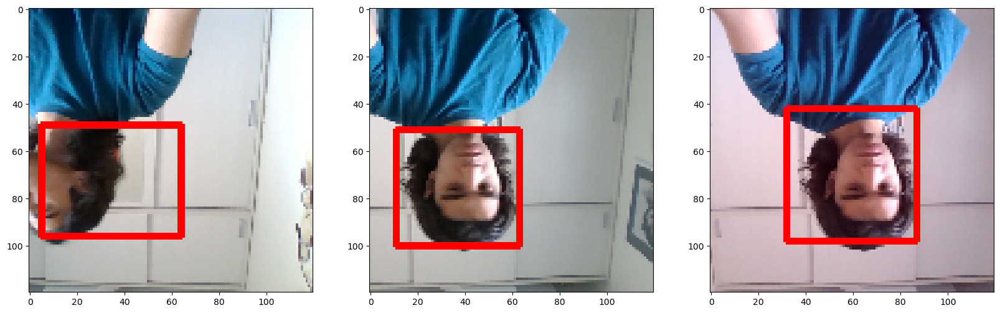

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999984 ],
       [0.9999941 ],
       [0.9999891 ],
       [0.99999833],
       [0.9999996 ],
       [0.99999744],
       [0.9999998 ],
       [0.99999976]], dtype=float32), array([[0.36813954, 0.15387666, 0.86448205, 0.6087662 ],
       [0.30779848, 0.3640835 , 0.77452904, 0.79418266],
       [0.20988828, 0.27114737, 0.78673416, 0.5207261 ],
       [0.16874988, 0.34737793, 0.7403288 , 0.8616149 ],
       [0.34590635, 0.10038491, 0.85941064, 0.559975  ],
       [0.2697967 , 0.36220434, 0.83706504, 0.83745056],
       [0.24897817, 0.11184806, 0.7459378 , 0.57637227],
       [0.03004095, 0.40335488, 0.34595236, 0.8446152 ]], dtype=float32)]


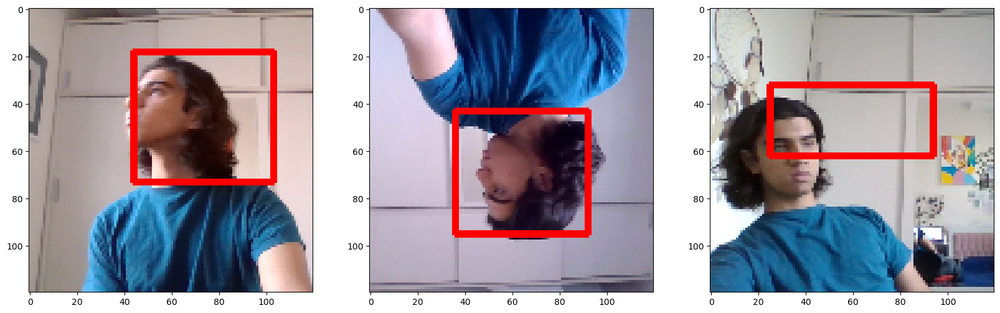

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9992581 ],
       [0.999997  ],
       [0.99999976],
       [0.99999684],
       [0.99999994],
       [0.99999994],
       [0.9999463 ],
       [1.        ]], dtype=float32), array([[0.47083983, 0.34075353, 0.91833484, 0.59365153],
       [0.22368029, 0.4386452 , 0.8140883 , 0.8067027 ],
       [0.03722546, 0.4377019 , 0.4390084 , 0.8395808 ],
       [0.46784255, 0.18928722, 0.8999806 , 0.5853393 ],
       [0.1114829 , 0.25877553, 0.565019  , 0.4602935 ],
       [0.02801575, 0.41749382, 0.46058267, 0.8372701 ],
       [0.23752804, 0.26230952, 0.68835485, 0.5169581 ],
       [0.02194626, 0.43469453, 0.48923653, 0.8239187 ]], dtype=float32)]


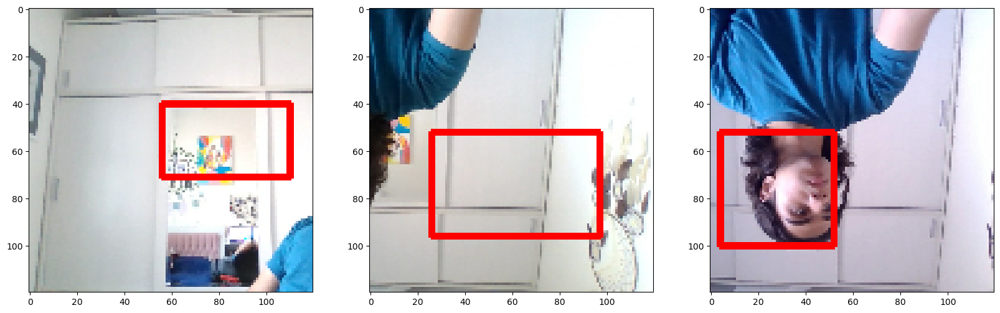

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99998546],
       [0.9999992 ],
       [0.9999977 ],
       [0.999761  ],
       [0.9999997 ],
       [0.99999994],
       [0.9990578 ],
       [0.9999995 ]], dtype=float32), array([[0.41687274, 0.36373535, 0.8827547 , 0.79030466],
       [0.15919042, 0.14153671, 0.583686  , 0.5451691 ],
       [0.5950408 , 0.1407379 , 0.9717122 , 0.5871641 ],
       [0.42554408, 0.35334334, 0.87850285, 0.54764616],
       [0.19128284, 0.19204645, 0.60974216, 0.5592022 ],
       [0.05493093, 0.45688835, 0.64823115, 0.8259394 ],
       [0.44279575, 0.36309496, 0.91594255, 0.699541  ],
       [0.2747689 , 0.14375035, 0.74395597, 0.58612955]], dtype=float32)]


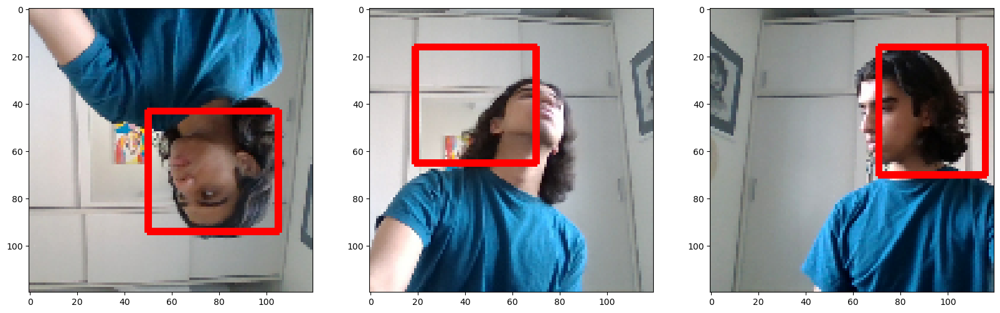

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999714],
       [0.99999887],
       [0.9999755 ],
       [0.9999996 ],
       [0.9999861 ],
       [0.9999877 ],
       [0.99999964],
       [0.99999917]], dtype=float32), array([[0.25114155, 0.14846124, 0.68051136, 0.5632324 ],
       [0.63895226, 0.4245181 , 0.985988  , 0.8710624 ],
       [0.19310088, 0.23329872, 0.7049632 , 0.6219742 ],
       [0.43955028, 0.14450324, 0.8853251 , 0.6237234 ],
       [0.42727464, 0.3820758 , 0.88836646, 0.7997005 ],
       [0.2170806 , 0.38801265, 0.7835446 , 0.7591294 ],
       [0.43260983, 0.10219321, 0.94186085, 0.59721935],
       [0.13169332, 0.40388808, 0.6031736 , 0.8601454 ]], dtype=float32)]


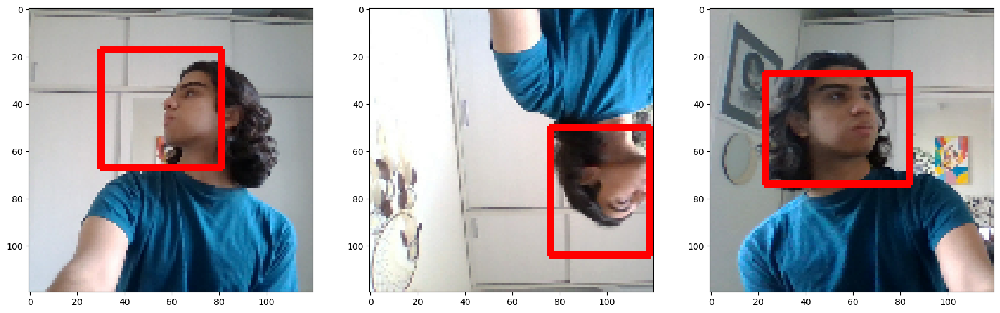

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999988 ],
       [0.9999992 ],
       [0.9999998 ],
       [0.9999992 ],
       [0.9999993 ],
       [0.9999987 ],
       [0.9999994 ],
       [0.99999994]], dtype=float32), array([[0.10268059, 0.44774684, 0.5118367 , 0.8459739 ],
       [0.09914743, 0.4002898 , 0.5443138 , 0.83378446],
       [0.16999167, 0.08673016, 0.5729301 , 0.5935645 ],
       [0.4342228 , 0.33342442, 0.8973871 , 0.83670306],
       [0.0826013 , 0.3757832 , 0.4877997 , 0.8310847 ],
       [0.15408695, 0.17185685, 0.6607083 , 0.5604792 ],
       [0.5907104 , 0.37793344, 0.9801191 , 0.8752122 ],
       [0.18461211, 0.10079353, 0.7459363 , 0.57653993]], dtype=float32)]


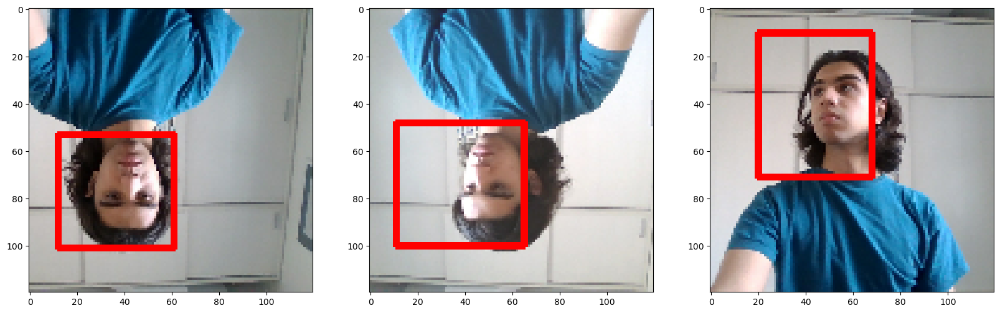

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999803],
       [0.9999965 ],
       [0.9994574 ],
       [0.99997365],
       [0.99999887],
       [0.9999988 ],
       [0.9999997 ],
       [0.99999964]], dtype=float32), array([[0.36239558, 0.34815958, 0.8292886 , 0.81936455],
       [0.20629278, 0.41774845, 0.68094754, 0.83713394],
       [0.49359736, 0.35522464, 0.93492526, 0.70971406],
       [0.48756278, 0.25058386, 0.9633866 , 0.602442  ],
       [0.5019431 , 0.3945932 , 0.94793624, 0.85464585],
       [0.2764838 , 0.14750496, 0.8442377 , 0.59216386],
       [0.2449617 , 0.14366375, 0.7430762 , 0.5894103 ],
       [0.2582452 , 0.10881983, 0.70633423, 0.57106483]], dtype=float32)]


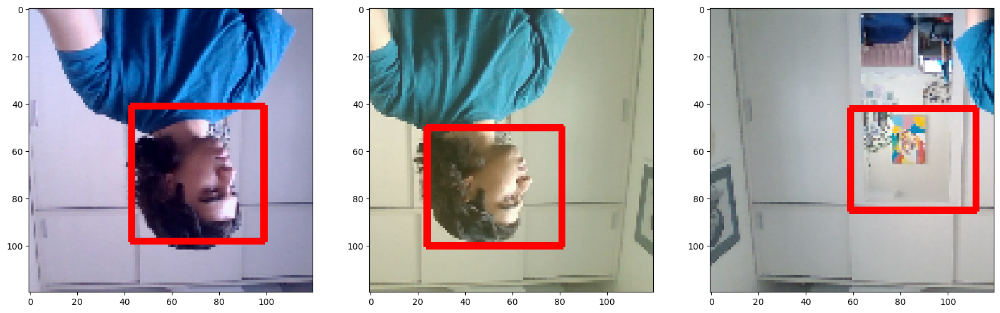

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99997777],
       [0.9999984 ],
       [0.9999984 ],
       [0.99999994],
       [0.9999998 ],
       [0.9999996 ],
       [0.9998039 ],
       [0.9999997 ]], dtype=float32), array([[0.3308351 , 0.20699675, 0.79178447, 0.53649926],
       [0.272802  , 0.37390542, 0.8498087 , 0.82512677],
       [0.13086386, 0.1947429 , 0.6327317 , 0.6005865 ],
       [0.13176443, 0.21843235, 0.5861981 , 0.5283594 ],
       [0.25109622, 0.11136792, 0.68341446, 0.60686004],
       [0.06862747, 0.3701834 , 0.46082273, 0.8375604 ],
       [0.4363305 , 0.3145168 , 0.8980012 , 0.5275937 ],
       [0.43402016, 0.09072001, 0.9354732 , 0.5896394 ]], dtype=float32)]


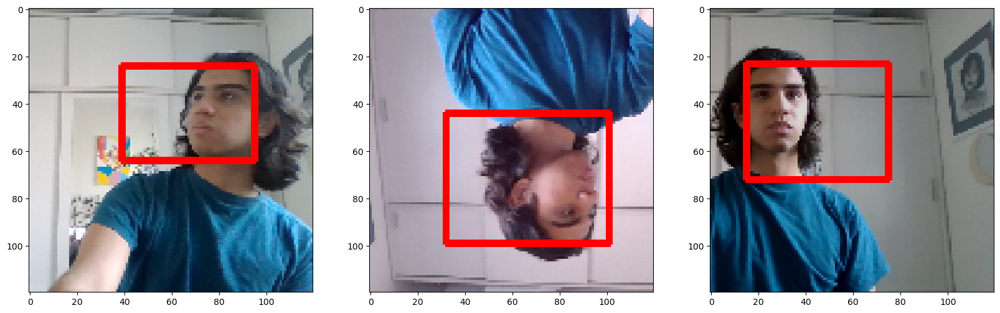

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999243],
       [0.99999547],
       [0.999998  ],
       [0.99999934],
       [0.99999654],
       [0.9999981 ],
       [0.9998058 ],
       [0.9999465 ]], dtype=float32), array([[0.49574843, 0.19237642, 0.97220814, 0.6079706 ],
       [0.34533226, 0.19534959, 0.92074585, 0.5895232 ],
       [0.14866123, 0.22578944, 0.66447186, 0.5540396 ],
       [0.07209533, 0.38755685, 0.48355916, 0.8464387 ],
       [0.2445711 , 0.1844524 , 0.73616505, 0.53148115],
       [0.4871728 , 0.40620795, 0.92197317, 0.8396741 ],
       [0.301281  , 0.35871875, 0.7410437 , 0.5990794 ],
       [0.25716433, 0.32301465, 0.6898346 , 0.5636164 ]], dtype=float32)]


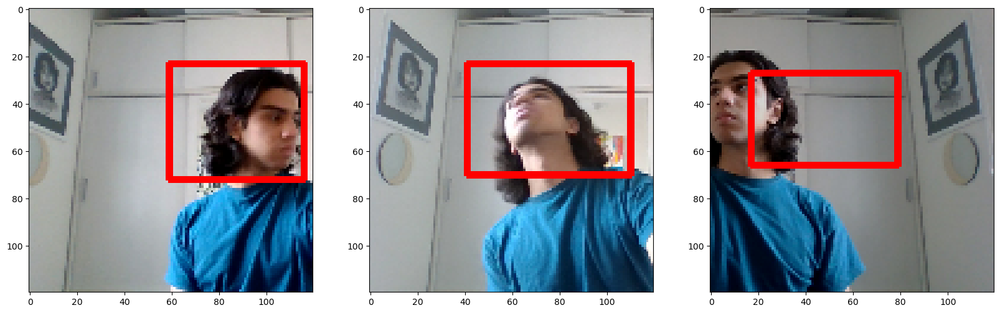

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999905],
       [0.99999607],
       [0.9999989 ],
       [0.9999988 ],
       [0.99999964],
       [0.9999472 ],
       [0.9995031 ],
       [0.99999356]], dtype=float32), array([[0.09938334, 0.48676223, 0.55270505, 0.8178276 ],
       [0.10090979, 0.47166604, 0.5833575 , 0.7508261 ],
       [0.06327828, 0.37347448, 0.4698434 , 0.80360276],
       [0.25215003, 0.14516985, 0.7684915 , 0.5871531 ],
       [0.04115522, 0.4124561 , 0.49558836, 0.7788838 ],
       [0.38009387, 0.25529024, 0.86986923, 0.5796834 ],
       [0.42385846, 0.33850405, 0.93365264, 0.62303185],
       [0.25305927, 0.38924944, 0.8281472 , 0.7736693 ]], dtype=float32)]


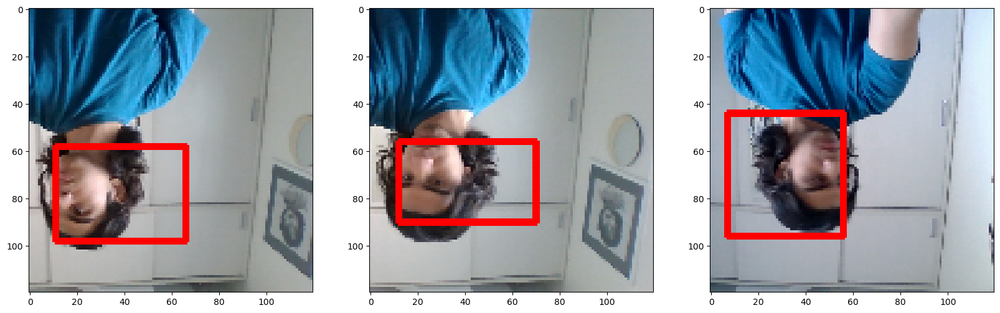

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999577],
       [0.99999946],
       [0.99985546],
       [0.9999991 ],
       [0.9999991 ],
       [0.9999996 ],
       [0.99998915],
       [0.99999857]], dtype=float32), array([[0.13132875, 0.25003022, 0.66297686, 0.53101796],
       [0.16151151, 0.12612984, 0.5540602 , 0.57169014],
       [0.37192085, 0.3347883 , 0.8809985 , 0.6797962 ],
       [0.11952723, 0.46727866, 0.56460565, 0.82694364],
       [0.11068399, 0.2254305 , 0.5344049 , 0.52347964],
       [0.50866795, 0.12613176, 0.9231313 , 0.60291064],
       [0.25714973, 0.40552244, 0.7947114 , 0.69767773],
       [0.1306222 , 0.50318164, 0.6127771 , 0.816529  ]], dtype=float32)]


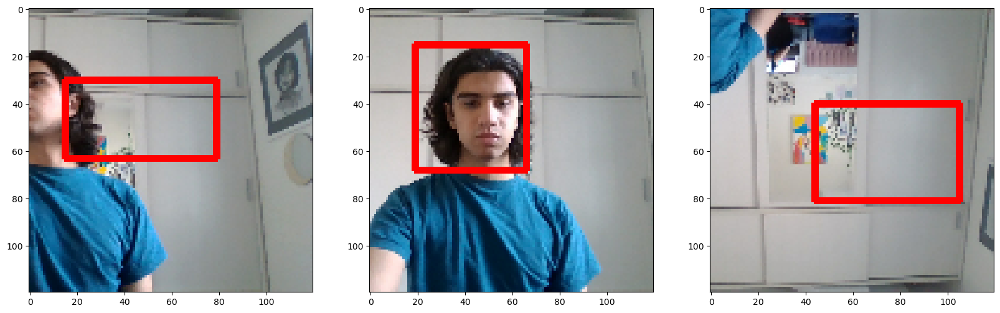

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99998045],
       [0.9993976 ],
       [0.9999987 ],
       [0.9999926 ],
       [0.99999726],
       [0.9994482 ],
       [0.9999997 ],
       [0.999982  ]], dtype=float32), array([[0.2599218 , 0.2911362 , 0.7633771 , 0.5648507 ],
       [0.45685196, 0.34519562, 0.92489934, 0.70617926],
       [0.6393583 , 0.41976357, 0.9849329 , 0.86973906],
       [0.22905503, 0.4485535 , 0.6977005 , 0.7812959 ],
       [0.11517155, 0.45332792, 0.6056186 , 0.7892778 ],
       [0.44710708, 0.35685882, 0.92916626, 0.7155373 ],
       [0.17983855, 0.17277665, 0.6749371 , 0.5335167 ],
       [0.46893722, 0.38935873, 0.93934125, 0.80903214]], dtype=float32)]


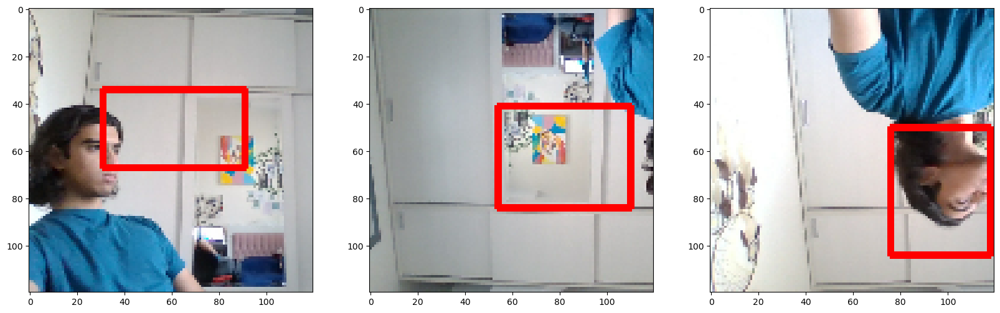

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99991435],
       [1.        ],
       [0.99999857],
       [0.9999987 ],
       [0.99993324],
       [0.99999994],
       [0.9999922 ],
       [0.99999905]], dtype=float32), array([[0.33764884, 0.29240257, 0.783936  , 0.5176    ],
       [0.09291267, 0.2171879 , 0.59259075, 0.50851166],
       [0.44166395, 0.21772681, 0.9028681 , 0.59248316],
       [0.14979768, 0.4865495 , 0.66721874, 0.773173  ],
       [0.26712456, 0.37659028, 0.851731  , 0.68906075],
       [0.16339023, 0.26875016, 0.69329846, 0.552336  ],
       [0.56211424, 0.19506846, 0.92385185, 0.61180496],
       [0.50265723, 0.33903193, 0.9224163 , 0.86227334]], dtype=float32)]


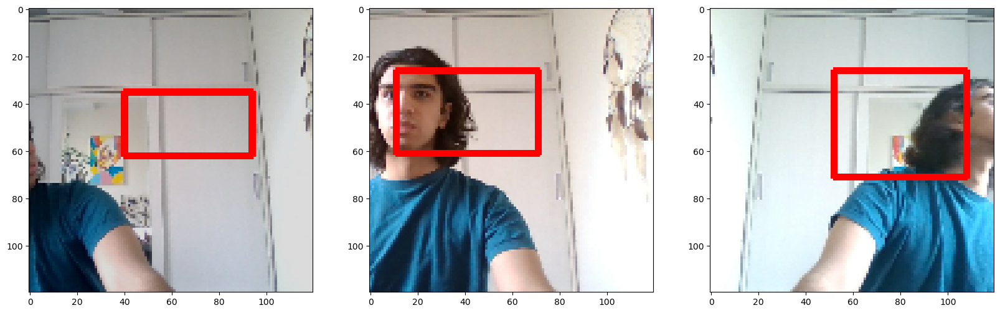

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999969 ],
       [0.99987644],
       [0.99998385],
       [0.9996653 ],
       [0.99999917],
       [0.99999547],
       [0.9999939 ],
       [0.99999756]], dtype=float32), array([[0.37927514, 0.38647473, 0.8237979 , 0.7901653 ],
       [0.36970216, 0.35740885, 0.8810373 , 0.70259917],
       [0.5178311 , 0.25675532, 0.91336083, 0.6277492 ],
       [0.34987307, 0.39464808, 0.8633893 , 0.6966263 ],
       [0.17959346, 0.20645964, 0.6651046 , 0.5412673 ],
       [0.2757993 , 0.40152013, 0.7044973 , 0.77321976],
       [0.2225179 , 0.18460453, 0.70605826, 0.5517268 ],
       [0.09464972, 0.37864515, 0.59951437, 0.78042305]], dtype=float32)]


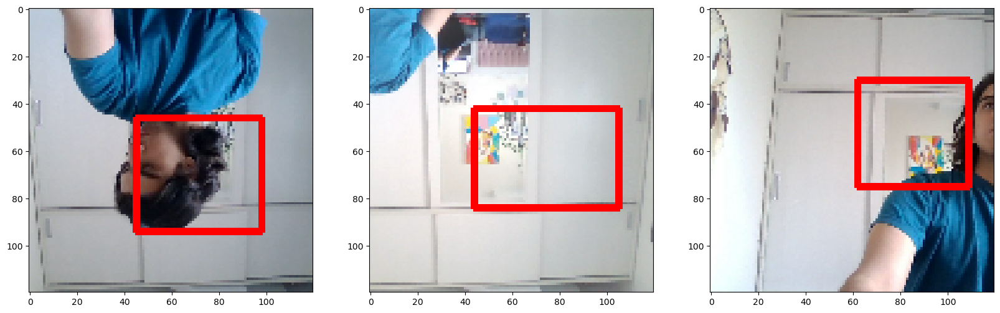

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999774],
       [0.9999991 ],
       [0.9999989 ],
       [0.9999992 ],
       [0.99999934],
       [0.9999739 ],
       [0.99999976],
       [0.9996925 ]], dtype=float32), array([[0.14159836, 0.39155427, 0.61934114, 0.77491623],
       [0.5975094 , 0.39182952, 0.9751114 , 0.8785538 ],
       [0.55053556, 0.44036064, 0.94121814, 0.8613597 ],
       [0.11350453, 0.18094459, 0.62075806, 0.5483154 ],
       [0.11257201, 0.21958858, 0.6066663 , 0.55871415],
       [0.45344305, 0.36367416, 0.94598955, 0.8037206 ],
       [0.16993642, 0.2843306 , 0.6677871 , 0.48459554],
       [0.33454466, 0.39204383, 0.85944265, 0.68331414]], dtype=float32)]


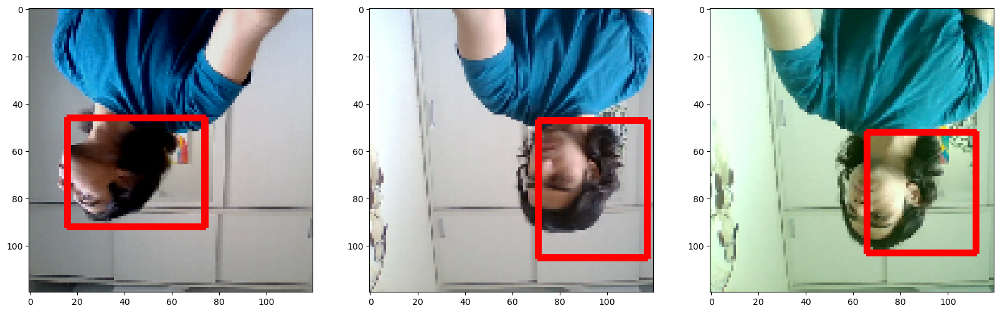

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999998 ],
       [0.9993382 ],
       [0.9999656 ],
       [0.9999992 ],
       [0.9999917 ],
       [0.9999989 ],
       [0.99999577],
       [0.99999434]], dtype=float32), array([[0.38555604, 0.12559128, 0.82915646, 0.589653  ],
       [0.5042028 , 0.37405807, 0.933339  , 0.6968392 ],
       [0.25498173, 0.31677124, 0.65952516, 0.54997915],
       [0.551256  , 0.39216968, 0.9646746 , 0.8709112 ],
       [0.22833411, 0.22330098, 0.7539903 , 0.53042257],
       [0.41743892, 0.15099107, 0.86324966, 0.6278126 ],
       [0.21191761, 0.14949538, 0.6331824 , 0.56361985],
       [0.22430378, 0.21577789, 0.75772804, 0.47255257]], dtype=float32)]


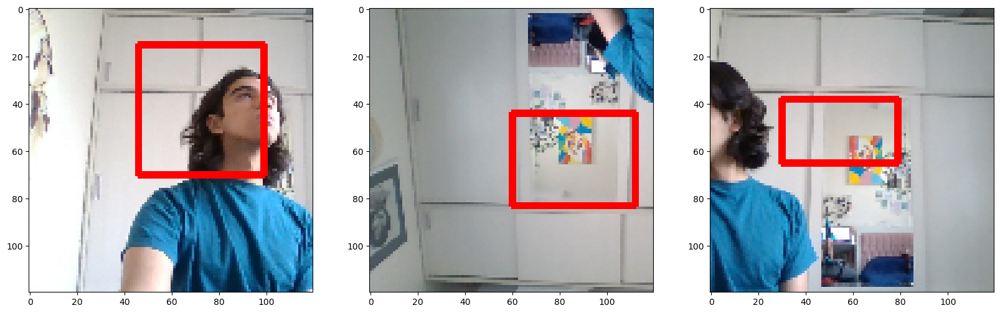

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[1.        ],
       [0.9999746 ],
       [0.9999986 ],
       [0.9999829 ],
       [0.9999997 ],
       [0.9991778 ],
       [0.99999887],
       [0.9999985 ]], dtype=float32), array([[0.0813899 , 0.18181981, 0.496137  , 0.54787564],
       [0.377898  , 0.39290935, 0.8518899 , 0.7513869 ],
       [0.5277817 , 0.36471924, 0.9350946 , 0.85758746],
       [0.23368077, 0.170259  , 0.6843559 , 0.530432  ],
       [0.44316453, 0.15546927, 0.88889563, 0.6214602 ],
       [0.45926785, 0.42187664, 0.88642883, 0.57202244],
       [0.3662234 , 0.35171896, 0.81918555, 0.8376458 ],
       [0.1335922 , 0.4696447 , 0.709754  , 0.75637734]], dtype=float32)]


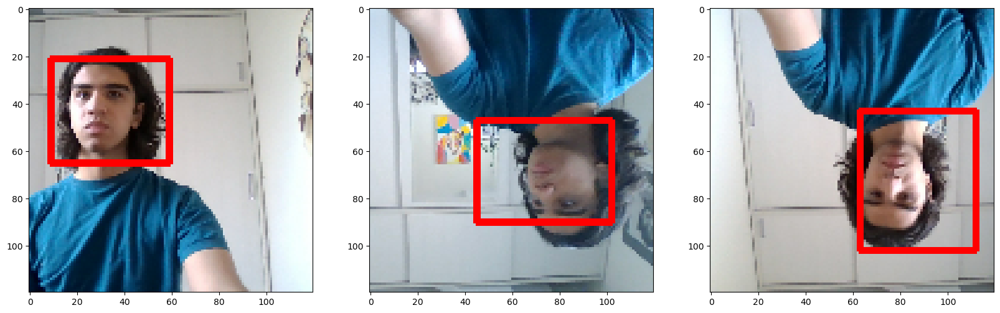

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999948 ],
       [0.99999785],
       [0.9999898 ],
       [0.99999386],
       [0.9999994 ],
       [0.9998054 ],
       [0.9999989 ],
       [0.9999981 ]], dtype=float32), array([[0.2914437 , 0.40368176, 0.85307413, 0.78992844],
       [0.19535857, 0.17635478, 0.604213  , 0.56569576],
       [0.48000854, 0.17514674, 0.9444109 , 0.5150834 ],
       [0.19197522, 0.2677477 , 0.7252382 , 0.556916  ],
       [0.0755308 , 0.38825604, 0.4829051 , 0.8380669 ],
       [0.56654656, 0.36148453, 0.9506896 , 0.7359215 ],
       [0.1887207 , 0.44778576, 0.6341053 , 0.8668412 ],
       [0.39968958, 0.15065144, 0.8887177 , 0.59780884]], dtype=float32)]


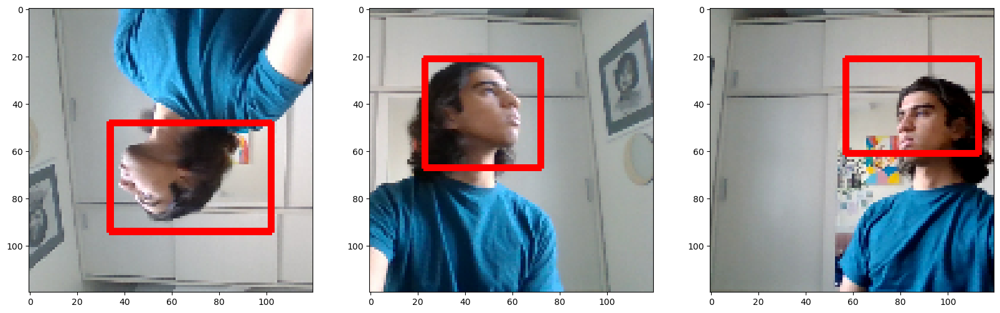

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9998577 ],
       [0.9996473 ],
       [0.99997795],
       [0.9999974 ],
       [0.9999953 ],
       [0.99999857],
       [1.        ],
       [0.9999998 ]], dtype=float32), array([[0.42887858, 0.3221389 , 0.92604697, 0.72887826],
       [0.48168457, 0.39387393, 0.92641723, 0.6810165 ],
       [0.27834505, 0.24778391, 0.7099231 , 0.52064085],
       [0.13365291, 0.40480623, 0.6147084 , 0.7870675 ],
       [0.38219005, 0.19433263, 0.92399734, 0.617226  ],
       [0.3969298 , 0.19513543, 0.86334825, 0.57762223],
       [0.01694285, 0.43828148, 0.44170758, 0.850548  ],
       [0.12646009, 0.18190032, 0.57860494, 0.51120436]], dtype=float32)]


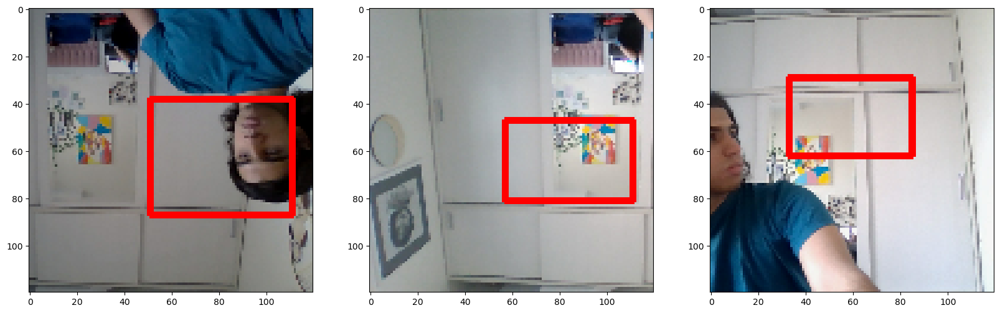

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999984 ],
       [0.9999953 ],
       [0.9999322 ],
       [0.9999958 ],
       [0.9999983 ],
       [0.9999854 ],
       [0.99997663],
       [0.9999986 ]], dtype=float32), array([[0.5350615 , 0.39798605, 0.95420396, 0.8580336 ],
       [0.1950641 , 0.3206692 , 0.6875111 , 0.5230374 ],
       [0.25661787, 0.3476276 , 0.83030224, 0.7182806 ],
       [0.1409685 , 0.4064601 , 0.67377245, 0.73170394],
       [0.5902829 , 0.34578535, 0.9578586 , 0.8679264 ],
       [0.36843035, 0.37037012, 0.9181198 , 0.7977052 ],
       [0.5093423 , 0.26744166, 0.9098903 , 0.6499055 ],
       [0.18066095, 0.50241935, 0.6871315 , 0.76898736]], dtype=float32)]


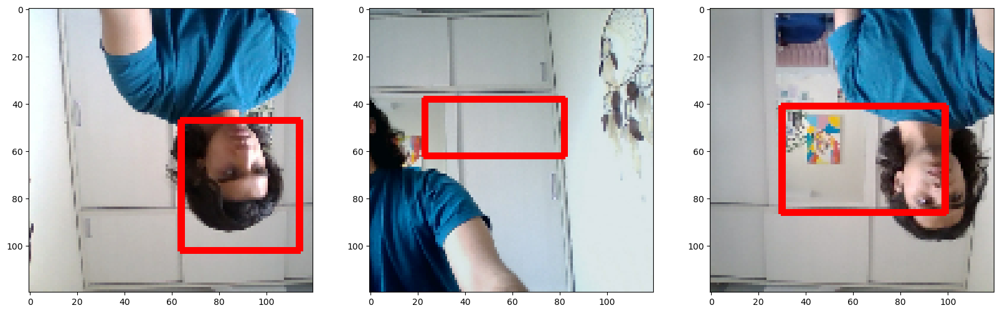

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999639 ],
       [0.9999985 ],
       [0.9999865 ],
       [0.9999992 ],
       [0.99997854],
       [0.9999972 ],
       [0.9999802 ],
       [0.99999547]], dtype=float32), array([[0.42642447, 0.3727278 , 0.8809436 , 0.77303475],
       [0.39245006, 0.31052125, 0.84677464, 0.8356579 ],
       [0.4126516 , 0.41186136, 0.9255411 , 0.8147452 ],
       [0.44560447, 0.12048089, 0.91813767, 0.59420645],
       [0.42083675, 0.36062512, 0.9325769 , 0.8024317 ],
       [0.21943185, 0.16352287, 0.6748922 , 0.54273283],
       [0.5814542 , 0.3638033 , 0.97293234, 0.80640775],
       [0.50857055, 0.21376367, 0.9325236 , 0.6093714 ]], dtype=float32)]


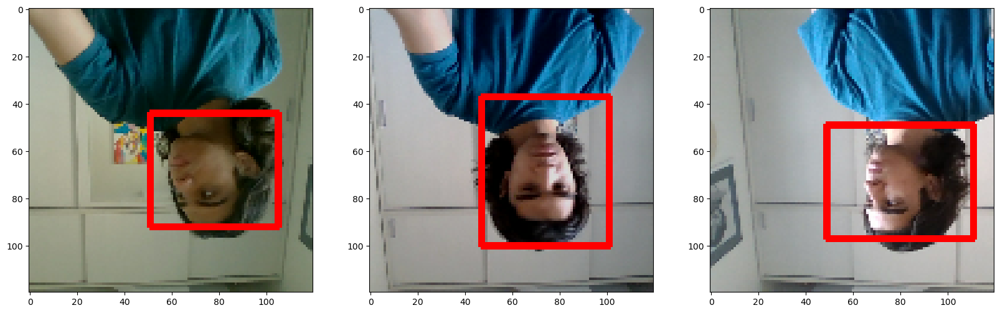

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99935746],
       [0.99999535],
       [0.9999996 ],
       [0.9999988 ],
       [0.99997723],
       [0.9999993 ],
       [0.9999999 ],
       [0.99999946]], dtype=float32), array([[0.49589023, 0.39484057, 0.9273269 , 0.6888511 ],
       [0.5924009 , 0.3655185 , 0.96957755, 0.87687904],
       [0.04561751, 0.36957702, 0.38272196, 0.83899534],
       [0.5274146 , 0.17481843, 0.9361572 , 0.6167871 ],
       [0.6128046 , 0.40331572, 0.971323  , 0.8128974 ],
       [0.33624536, 0.13417457, 0.81592494, 0.55796087],
       [0.2210385 , 0.10468221, 0.6602974 , 0.58673394],
       [0.46348068, 0.13491236, 0.9093448 , 0.5989253 ]], dtype=float32)]


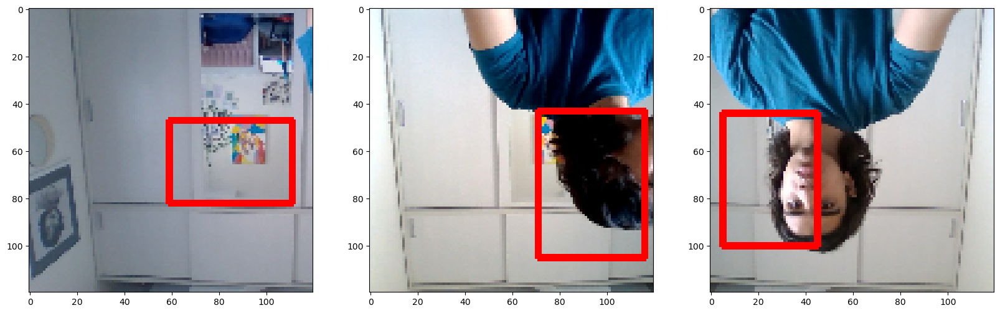

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99998015],
       [0.99999523],
       [0.99999607],
       [0.99999756],
       [0.9999984 ],
       [0.9999998 ],
       [0.99980056],
       [0.9995966 ]], dtype=float32), array([[0.20868637, 0.25828725, 0.6939054 , 0.52397525],
       [0.12619376, 0.37222677, 0.5867773 , 0.75204265],
       [0.18861482, 0.26572314, 0.7292399 , 0.5757927 ],
       [0.19602017, 0.44410092, 0.6292783 , 0.80929005],
       [0.616624  , 0.40721536, 0.97901225, 0.8504002 ],
       [0.14952354, 0.12534657, 0.671741  , 0.52933466],
       [0.4371215 , 0.31222495, 0.9006695 , 0.53026664],
       [0.353318  , 0.39038596, 0.8610916 , 0.6926025 ]], dtype=float32)]


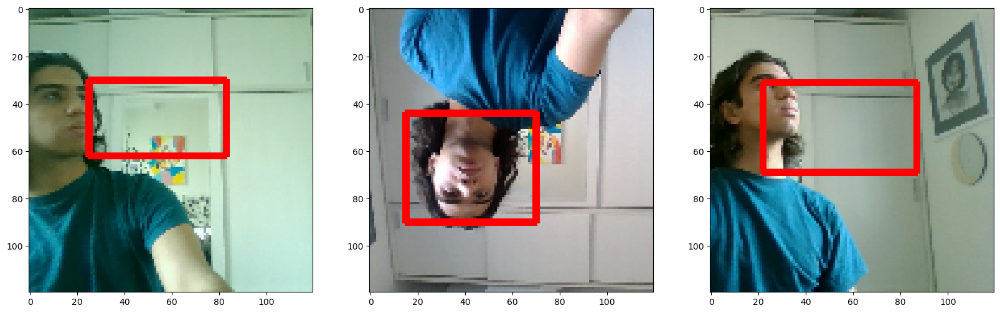

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999998 ],
       [0.9999987 ],
       [0.99999696],
       [0.99999934],
       [0.99998087],
       [0.9999918 ],
       [0.99999905],
       [0.9999941 ]], dtype=float32), array([[0.3250822 , 0.13954864, 0.8024682 , 0.6231859 ],
       [0.31077507, 0.160534  , 0.8152858 , 0.6054349 ],
       [0.2343318 , 0.13637258, 0.7317054 , 0.5822041 ],
       [0.42918655, 0.33103463, 0.9072711 , 0.83503807],
       [0.26128   , 0.39656183, 0.85802853, 0.75248504],
       [0.21379109, 0.29532126, 0.74741197, 0.573792  ],
       [0.12890479, 0.49700046, 0.61804485, 0.7767298 ],
       [0.46178553, 0.36967406, 0.91790485, 0.8418355 ]], dtype=float32)]


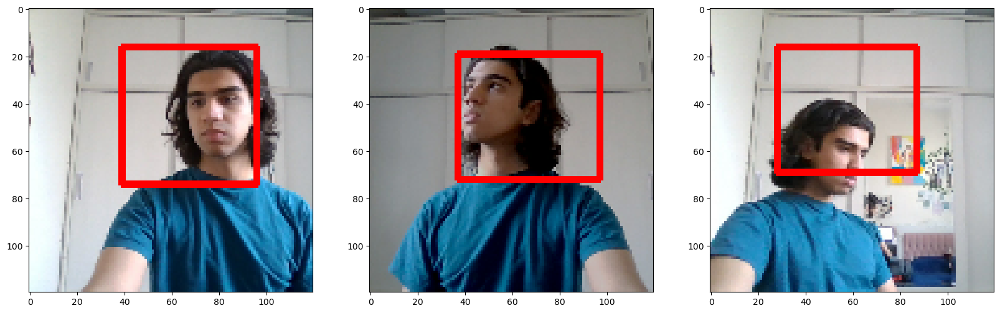

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999991 ],
       [0.99999356],
       [0.99999946],
       [0.99984145],
       [0.9999967 ],
       [0.99999344],
       [0.9999757 ],
       [0.9999055 ]], dtype=float32), array([[0.08511496, 0.48472846, 0.54634464, 0.8361896 ],
       [0.27534115, 0.39572382, 0.83706963, 0.74438524],
       [0.49790704, 0.16350536, 0.91630954, 0.6216459 ],
       [0.40355107, 0.29606143, 0.89256865, 0.52223575],
       [0.28147092, 0.3687747 , 0.84860754, 0.8249615 ],
       [0.41173926, 0.37167484, 0.90227425, 0.83686894],
       [0.47087464, 0.3990241 , 0.9463372 , 0.7963083 ],
       [0.2908715 , 0.34875238, 0.849423  , 0.7167468 ]], dtype=float32)]


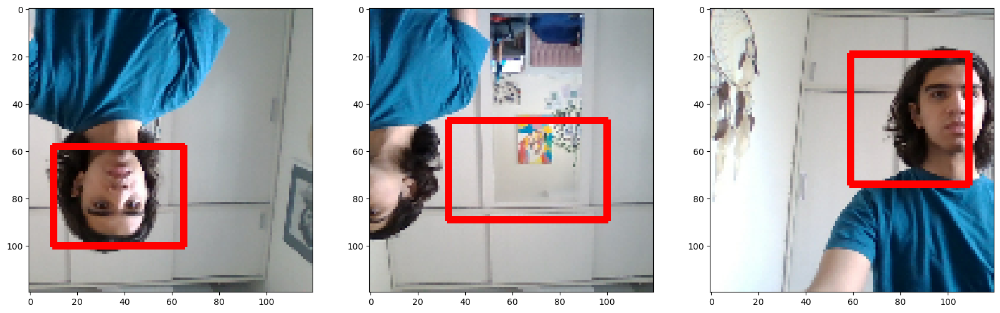

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999976],
       [0.99999976],
       [0.99999565],
       [0.99982446],
       [0.99999934],
       [0.9999993 ],
       [0.9983933 ],
       [0.999996  ]], dtype=float32), array([[0.03808086, 0.4174981 , 0.5312172 , 0.8417445 ],
       [0.4054664 , 0.13112281, 0.8332375 , 0.60723215],
       [0.25393534, 0.347465  , 0.7331508 , 0.5402814 ],
       [0.585269  , 0.4081151 , 0.95591027, 0.73364556],
       [0.28852352, 0.13332888, 0.7438196 , 0.6094845 ],
       [0.10006547, 0.49459207, 0.5425906 , 0.82844204],
       [0.43298122, 0.40036836, 0.879393  , 0.6045196 ],
       [0.45761913, 0.22024007, 0.8949586 , 0.62295485]], dtype=float32)]


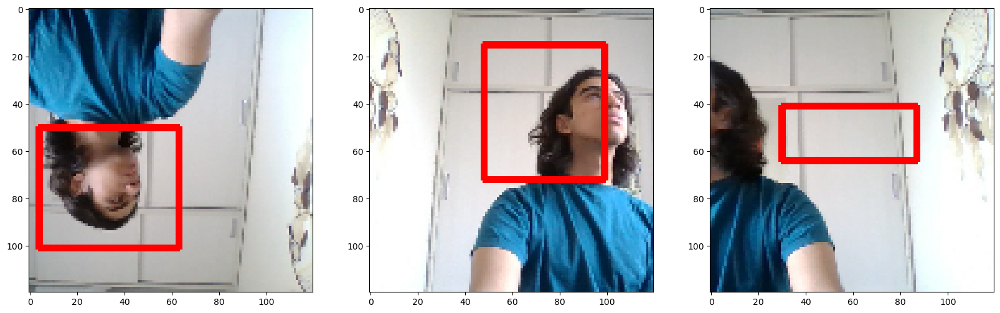

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999875],
       [0.9992331 ],
       [0.9999983 ],
       [0.9999995 ],
       [0.99999994],
       [0.9999939 ],
       [0.9999985 ],
       [0.9998721 ]], dtype=float32), array([[0.19818406, 0.24342594, 0.7130878 , 0.49985367],
       [0.4520612 , 0.3852418 , 0.9145161 , 0.7010281 ],
       [0.48695973, 0.34279454, 0.9229486 , 0.8441753 ],
       [0.3321118 , 0.13150646, 0.86661047, 0.5669054 ],
       [0.12247189, 0.2203354 , 0.62338173, 0.52735037],
       [0.4563217 , 0.19300778, 0.8803654 , 0.5850644 ],
       [0.37736794, 0.13424581, 0.825092  , 0.5822053 ],
       [0.26024365, 0.37578154, 0.8269856 , 0.65384907]], dtype=float32)]


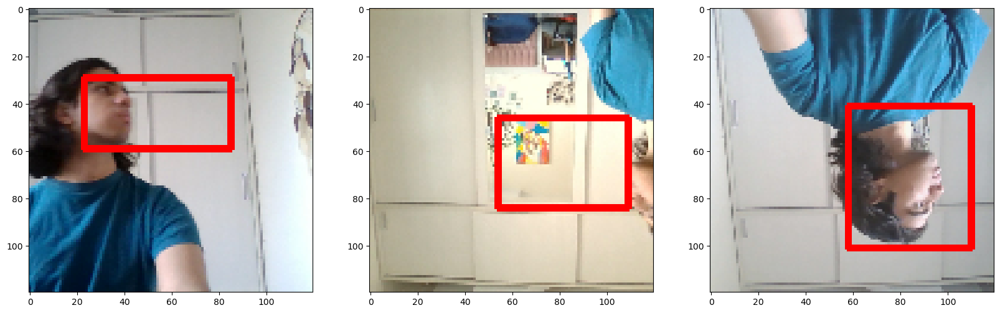

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99992305],
       [0.9999978 ],
       [0.9999983 ],
       [0.9999989 ],
       [0.99958915],
       [0.999972  ],
       [0.999965  ],
       [0.9999926 ]], dtype=float32), array([[0.22376123, 0.38212952, 0.82324016, 0.65902174],
       [0.07957183, 0.38775554, 0.5556992 , 0.7945046 ],
       [0.4961353 , 0.33887777, 0.9356788 , 0.8493695 ],
       [0.2005772 , 0.12867223, 0.66266966, 0.5985441 ],
       [0.41566256, 0.3470154 , 0.9341153 , 0.62760544],
       [0.36773926, 0.28864676, 0.8245727 , 0.55861163],
       [0.44028458, 0.3840916 , 0.9318853 , 0.7922558 ],
       [0.33521265, 0.4145746 , 0.91268206, 0.8157447 ]], dtype=float32)]


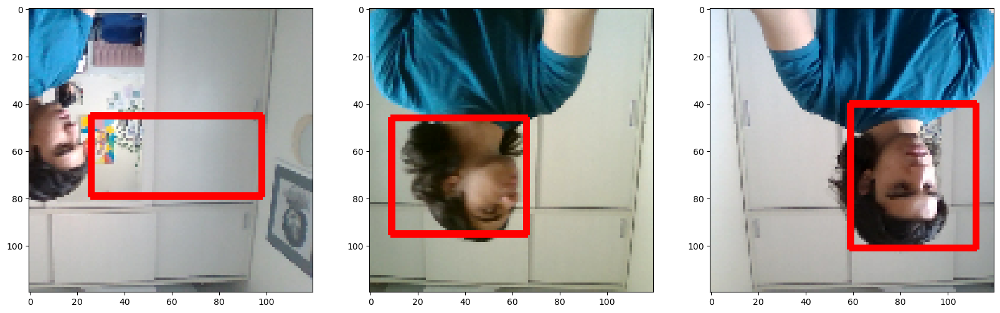

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99826306],
       [0.9991263 ],
       [0.99999726],
       [0.99999297],
       [0.9998946 ],
       [0.9999941 ],
       [0.9999823 ],
       [0.9992582 ]], dtype=float32), array([[0.4398198 , 0.39511013, 0.8822106 , 0.6099781 ],
       [0.37404945, 0.39619333, 0.84829956, 0.6203644 ],
       [0.13188557, 0.43594298, 0.61067116, 0.8248044 ],
       [0.27659798, 0.38566855, 0.7383063 , 0.8036093 ],
       [0.43216258, 0.31534627, 0.92836875, 0.7394109 ],
       [0.27259865, 0.47630334, 0.80473197, 0.7708765 ],
       [0.52598906, 0.376339  , 0.95805514, 0.8277627 ],
       [0.44289908, 0.3429312 , 0.92687356, 0.6076479 ]], dtype=float32)]


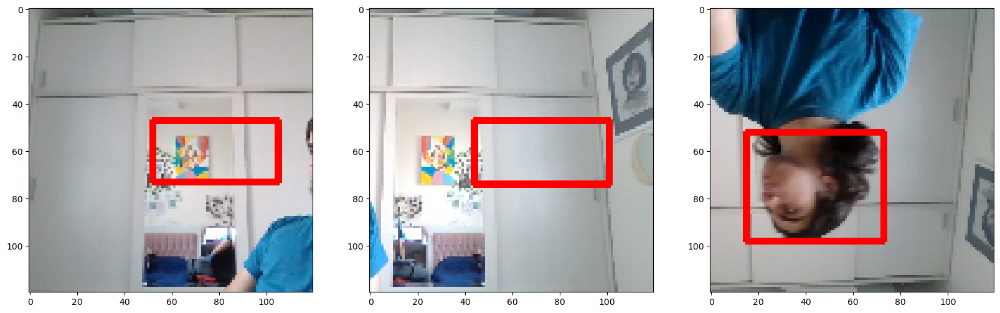

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999994],
       [0.9999994 ],
       [0.99981606],
       [0.99999994],
       [0.99999917],
       [0.9999962 ],
       [0.9999985 ],
       [0.9999928 ]], dtype=float32), array([[0.13460778, 0.24777514, 0.62782365, 0.5159645 ],
       [0.12026403, 0.5268266 , 0.5993482 , 0.80507374],
       [0.57949865, 0.38836873, 0.9441862 , 0.7122904 ],
       [0.03038866, 0.46184158, 0.51791835, 0.8201056 ],
       [0.2523686 , 0.10219315, 0.7186507 , 0.60166097],
       [0.2031298 , 0.38913995, 0.7716266 , 0.8507199 ],
       [0.63293886, 0.43295652, 0.9845059 , 0.85654306],
       [0.50481117, 0.24070045, 0.90355504, 0.6212084 ]], dtype=float32)]


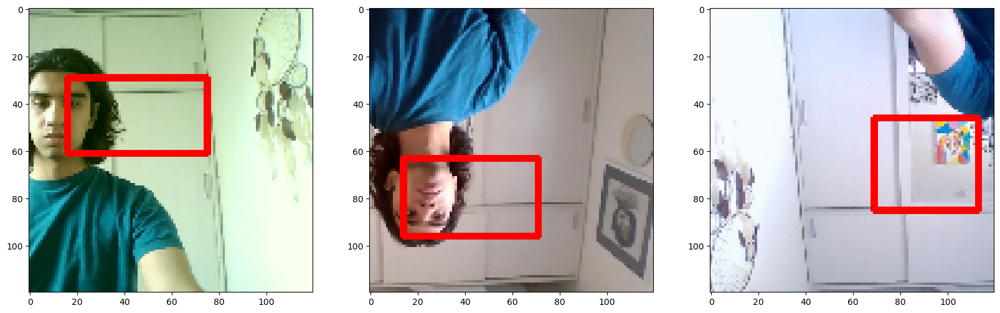

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99998695],
       [0.999985  ],
       [0.9999944 ],
       [0.99999917],
       [0.9999967 ],
       [0.9999994 ],
       [0.9999979 ],
       [0.9999992 ]], dtype=float32), array([[0.2357235 , 0.40391836, 0.7485869 , 0.69095826],
       [0.41077784, 0.3858231 , 0.92143273, 0.80798155],
       [0.277261  , 0.37059033, 0.8209001 , 0.7897452 ],
       [0.10763112, 0.14427146, 0.50473976, 0.5871885 ],
       [0.26749665, 0.37991187, 0.8555331 , 0.8145574 ],
       [0.32062972, 0.14067945, 0.79021454, 0.57869196],
       [0.22528704, 0.46660936, 0.72877455, 0.76410913],
       [0.06892637, 0.4034264 , 0.47063   , 0.81236315]], dtype=float32)]


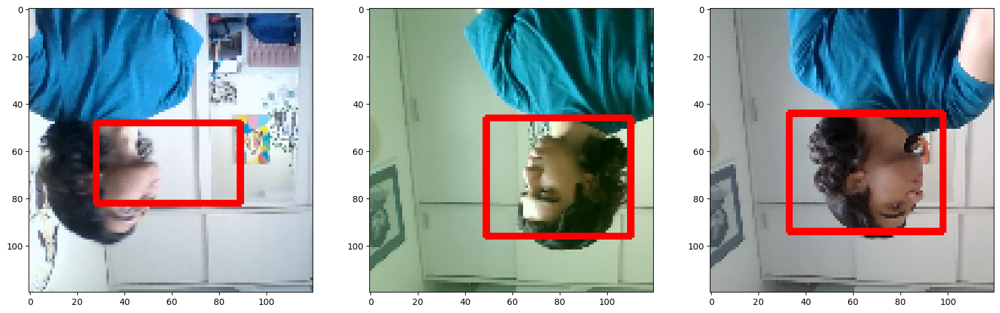

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999445 ],
       [0.9999999 ],
       [0.9999974 ],
       [0.99999875],
       [0.99999976],
       [0.9999973 ],
       [0.99999803],
       [0.99999964]], dtype=float32), array([[0.46908528, 0.37332985, 0.9380919 , 0.7773249 ],
       [0.2878119 , 0.11623657, 0.7445117 , 0.65456486],
       [0.29669183, 0.14511563, 0.7731699 , 0.5751748 ],
       [0.17239735, 0.16312505, 0.64039433, 0.5558362 ],
       [0.04619258, 0.41439378, 0.4668509 , 0.8479116 ],
       [0.27903527, 0.15076053, 0.72318995, 0.56923276],
       [0.17479627, 0.43451092, 0.5982958 , 0.8221202 ],
       [0.05636409, 0.36853355, 0.41352662, 0.8531693 ]], dtype=float32)]


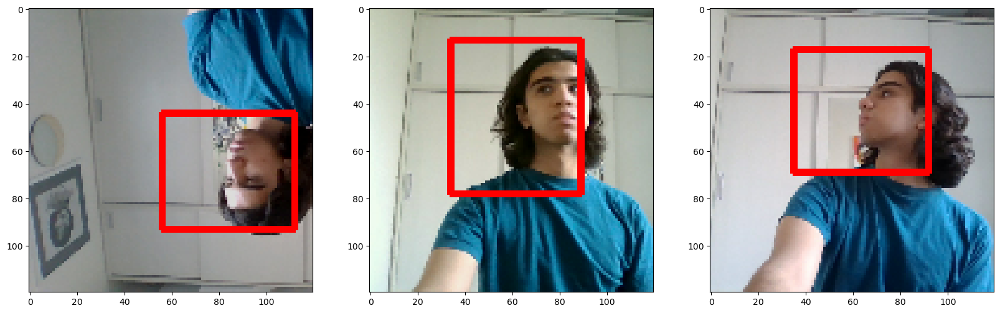

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999982 ],
       [0.9999968 ],
       [0.99972624],
       [0.999999  ],
       [0.99999696],
       [0.9999985 ],
       [0.999987  ],
       [0.99999666]], dtype=float32), array([[0.20633504, 0.17902343, 0.6963433 , 0.5193552 ],
       [0.13169749, 0.20378813, 0.5739751 , 0.5426875 ],
       [0.3810973 , 0.38876504, 0.79459256, 0.6282089 ],
       [0.55241156, 0.4085972 , 0.9736144 , 0.8705388 ],
       [0.4248871 , 0.14561428, 0.8344801 , 0.56839955],
       [0.19347696, 0.15100372, 0.62370694, 0.58602965],
       [0.38355604, 0.42598158, 0.90681446, 0.81575334],
       [0.4206375 , 0.17338586, 0.8649418 , 0.5518404 ]], dtype=float32)]


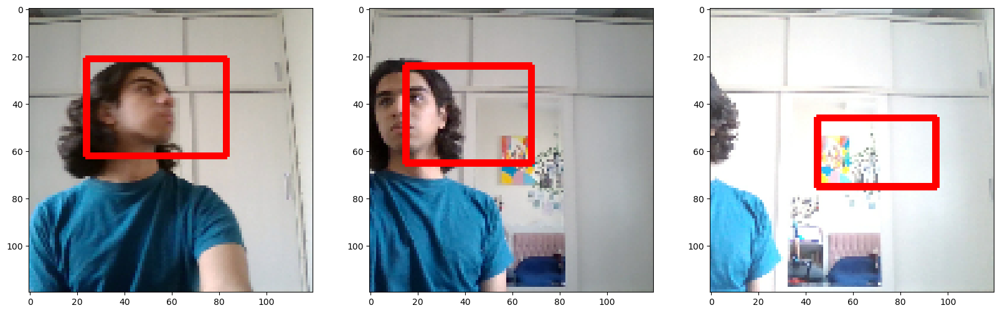

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999883 ],
       [0.99999887],
       [0.9999998 ],
       [0.9999998 ],
       [0.99999475],
       [0.99999833],
       [0.99999917],
       [0.9999997 ]], dtype=float32), array([[0.4258738 , 0.38804254, 0.9352056 , 0.8034576 ],
       [0.51023775, 0.14321683, 0.9519937 , 0.5848069 ],
       [0.11206856, 0.16893579, 0.54987574, 0.491911  ],
       [0.03069741, 0.41220766, 0.39292657, 0.8497312 ],
       [0.49202633, 0.22805268, 0.91199684, 0.6102116 ],
       [0.42601976, 0.37810647, 0.87139475, 0.8352303 ],
       [0.42469114, 0.3693674 , 0.9130454 , 0.8312233 ],
       [0.11239752, 0.09857509, 0.523036  , 0.53261584]], dtype=float32)]


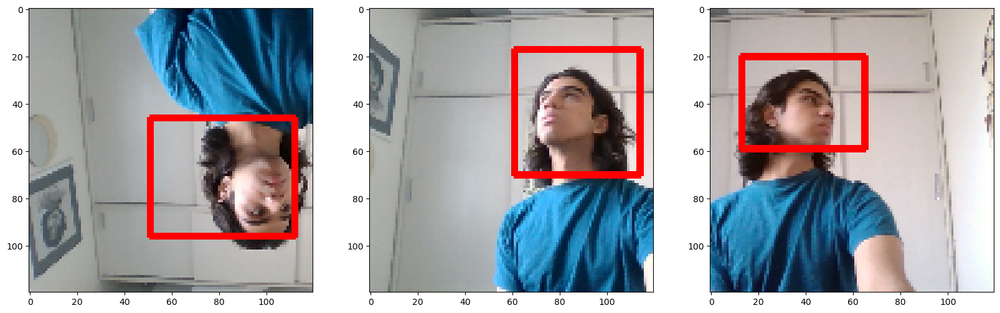

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999933 ],
       [0.9999996 ],
       [0.999999  ],
       [0.9999945 ],
       [0.999999  ],
       [0.99999887],
       [0.99995893],
       [0.99998933]], dtype=float32), array([[0.1475933 , 0.26261598, 0.67741406, 0.5195724 ],
       [0.37167114, 0.11282013, 0.8688785 , 0.61743784],
       [0.16542643, 0.1147197 , 0.5422765 , 0.5467628 ],
       [0.2620606 , 0.377309  , 0.7602978 , 0.74957883],
       [0.09121037, 0.39392975, 0.53470457, 0.8168782 ],
       [0.45292827, 0.1527018 , 0.94527316, 0.6002166 ],
       [0.45678633, 0.3781353 , 0.93829346, 0.7772365 ],
       [0.28733724, 0.20534867, 0.74415517, 0.5175602 ]], dtype=float32)]


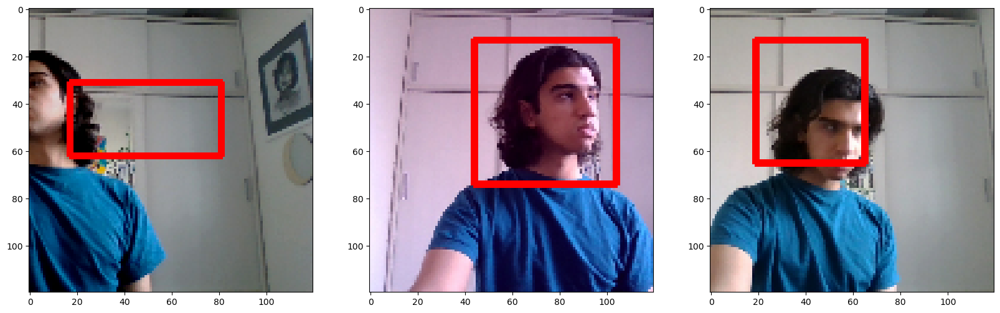

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999995 ],
       [0.9999992 ],
       [0.9999998 ],
       [0.99999946],
       [0.9999993 ],
       [0.9993601 ],
       [0.99999946],
       [0.9999991 ]], dtype=float32), array([[0.05560943, 0.39398798, 0.52464306, 0.82780397],
       [0.20980544, 0.11434556, 0.65499806, 0.5908277 ],
       [0.17603667, 0.10024481, 0.57679075, 0.5831981 ],
       [0.05033322, 0.39850375, 0.4499542 , 0.8436138 ],
       [0.411174  , 0.14403297, 0.9368887 , 0.6085806 ],
       [0.43718404, 0.34285358, 0.92638516, 0.59897983],
       [0.19003342, 0.1058604 , 0.5750739 , 0.58328354],
       [0.38083634, 0.12647684, 0.8671671 , 0.5752674 ]], dtype=float32)]


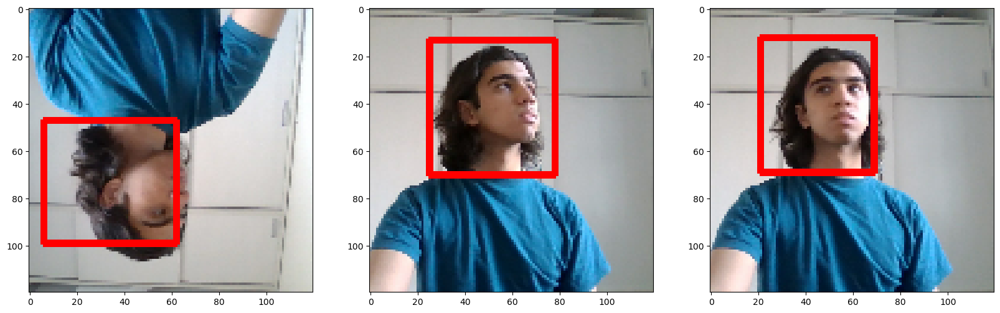

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999946],
       [0.9999874 ],
       [0.99999994],
       [0.999837  ],
       [0.9999931 ],
       [0.9999701 ],
       [0.99999845],
       [0.9999986 ]], dtype=float32), array([[0.39123994, 0.13247375, 0.9265413 , 0.61525786],
       [0.3924044 , 0.38787353, 0.9190645 , 0.8137232 ],
       [0.13454741, 0.19285138, 0.58213425, 0.54779637],
       [0.3467989 , 0.31087488, 0.76314235, 0.6121162 ],
       [0.5209827 , 0.22775662, 0.9262281 , 0.62145185],
       [0.5316559 , 0.26088026, 0.93636405, 0.6283248 ],
       [0.13715404, 0.16234662, 0.5634368 , 0.52273345],
       [0.27624738, 0.37042242, 0.75083   , 0.8128854 ]], dtype=float32)]


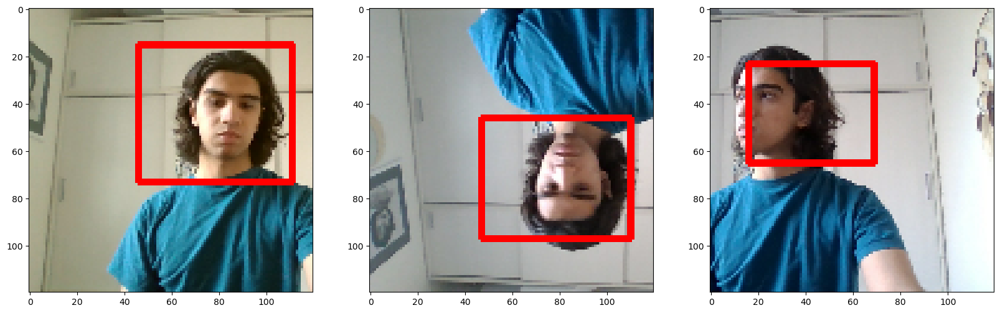

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
[array([[0.9999989 ],
       [0.99999535],
       [0.99999976],
       [0.99999094],
       [0.9996594 ],
       [0.99999994],
       [0.9999975 ],
       [0.9994791 ]], dtype=float32), array([[0.3858978 , 0.36871707, 0.8399736 , 0.82607245],
       [0.29784185, 0.35135934, 0.7879275 , 0.80706125],
       [0.03602453, 0.43516904, 0.40976906, 0.843881  ],
       [0.45003152, 0.3915975 , 0.93197465, 0.842971  ],
       [0.4718586 , 0.39851782, 0.9157245 , 0.68048584],
       [0.02726448, 0.4367576 , 0.50616765, 0.84418744],
       [0.4817152 , 0.16621834, 0.9650675 , 0.6110513 ],
       [0.49563923, 0.3857462 , 0.929842  , 0.69648415]], dtype=float32)]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


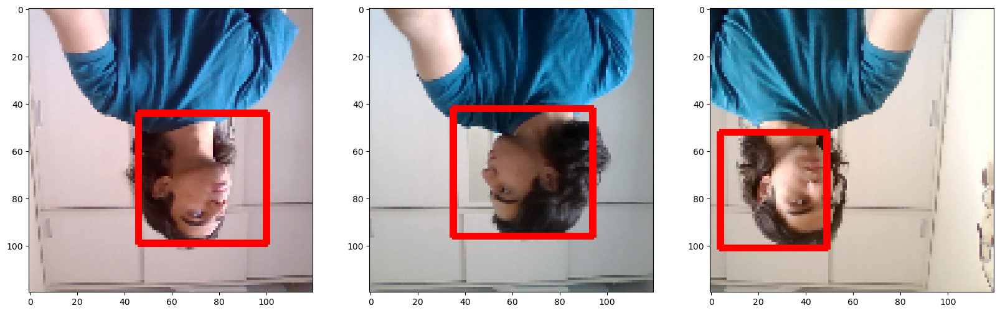

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99998766],
       [0.9999991 ],
       [0.9999996 ],
       [0.99999946],
       [0.999999  ],
       [1.        ],
       [0.99999607],
       [0.9992757 ]], dtype=float32), array([[0.34105384, 0.36797386, 0.8544254 , 0.72464347],
       [0.09250972, 0.49697858, 0.5361209 , 0.8176153 ],
       [0.27302718, 0.1407794 , 0.78368884, 0.6058511 ],
       [0.50741434, 0.13339783, 0.9186376 , 0.60269326],
       [0.11347841, 0.4561142 , 0.60306597, 0.8546213 ],
       [0.09580228, 0.19177862, 0.6093663 , 0.5124763 ],
       [0.35205826, 0.15650813, 0.7778151 , 0.5749841 ],
       [0.43190598, 0.38008726, 0.9175229 , 0.71697986]], dtype=float32)]


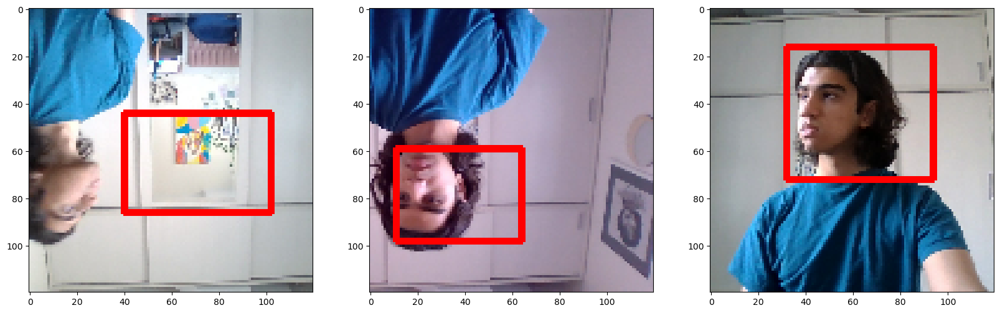

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999973 ],
       [0.99999475],
       [0.99999475],
       [0.9999949 ],
       [0.9999983 ],
       [0.99999875],
       [0.9996858 ],
       [0.99999857]], dtype=float32), array([[0.19981661, 0.16236468, 0.65053964, 0.53508765],
       [0.21421671, 0.38581008, 0.7295581 , 0.69957983],
       [0.26849425, 0.37677622, 0.7248702 , 0.78305805],
       [0.3418204 , 0.35479578, 0.8092493 , 0.8113513 ],
       [0.18732332, 0.31189394, 0.7282424 , 0.51560587],
       [0.42906132, 0.11878057, 0.9093156 , 0.59434056],
       [0.3850706 , 0.3100948 , 0.8974496 , 0.5357996 ],
       [0.18667433, 0.12523688, 0.5832418 , 0.5514425 ]], dtype=float32)]


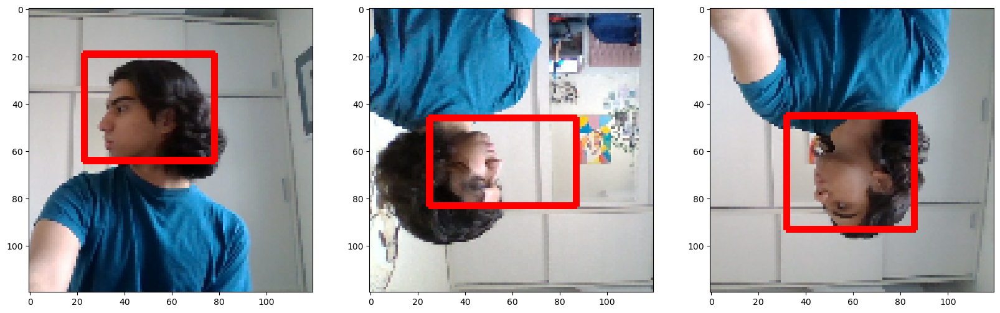

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999983 ],
       [0.99980307],
       [0.9996536 ],
       [0.9999715 ],
       [0.99932796],
       [0.99999815],
       [0.9999987 ],
       [0.9986022 ]], dtype=float32), array([[0.12482404, 0.4582207 , 0.6283151 , 0.84706956],
       [0.30017152, 0.32567465, 0.78896827, 0.5625385 ],
       [0.34876627, 0.3673447 , 0.7864851 , 0.5897019 ],
       [0.51162976, 0.25145572, 0.96187305, 0.62139404],
       [0.48421705, 0.3605839 , 0.9292859 , 0.7012108 ],
       [0.12298243, 0.4987257 , 0.60192776, 0.8310535 ],
       [0.18300873, 0.43124446, 0.5890932 , 0.84179795],
       [0.41853297, 0.41395578, 0.87218416, 0.553072  ]], dtype=float32)]


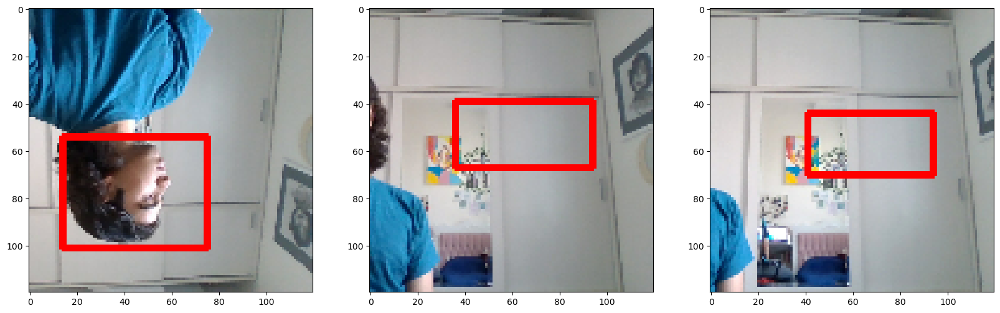

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.999999  ],
       [0.99999654],
       [0.99999607],
       [0.99991906],
       [0.9999964 ],
       [0.9999991 ],
       [0.99999917],
       [0.99999887]], dtype=float32), array([[0.13611396, 0.12621102, 0.47666574, 0.54073036],
       [0.25722638, 0.38203952, 0.84355646, 0.8684181 ],
       [0.17975445, 0.16456278, 0.54780126, 0.56209135],
       [0.3990288 , 0.34538946, 0.91747606, 0.72874546],
       [0.17085786, 0.4624935 , 0.6810468 , 0.72237265],
       [0.11081316, 0.45818245, 0.6162587 , 0.84753656],
       [0.11560367, 0.22129114, 0.53093886, 0.537017  ],
       [0.13057607, 0.39547145, 0.61999005, 0.87632895]], dtype=float32)]


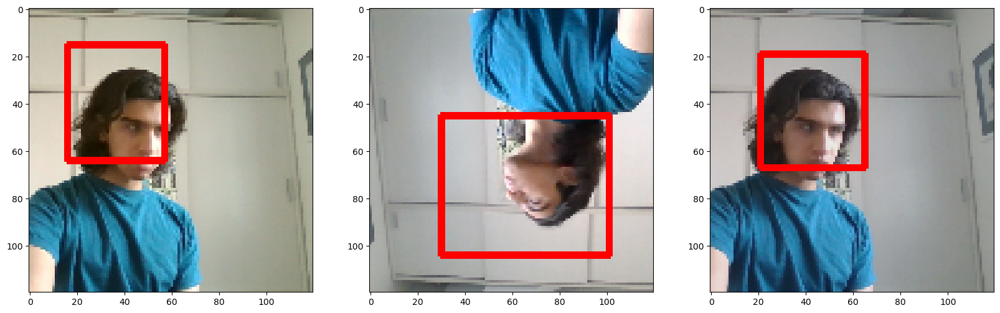

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999845],
       [0.9999996 ],
       [0.9999269 ],
       [0.9999786 ],
       [0.99999964],
       [0.999999  ],
       [0.9999998 ],
       [0.99999917]], dtype=float32), array([[0.23540272, 0.16025159, 0.7263242 , 0.5559288 ],
       [0.21170437, 0.28303102, 0.7839695 , 0.5554025 ],
       [0.4931866 , 0.33324608, 0.91783917, 0.60877264],
       [0.44066626, 0.38197994, 0.9345674 , 0.80042386],
       [0.07482424, 0.4048604 , 0.49965605, 0.8263566 ],
       [0.4701848 , 0.16988182, 0.8931981 , 0.5937949 ],
       [0.1590408 , 0.17173818, 0.6465751 , 0.57400656],
       [0.1713069 , 0.24950227, 0.6541926 , 0.5368693 ]], dtype=float32)]


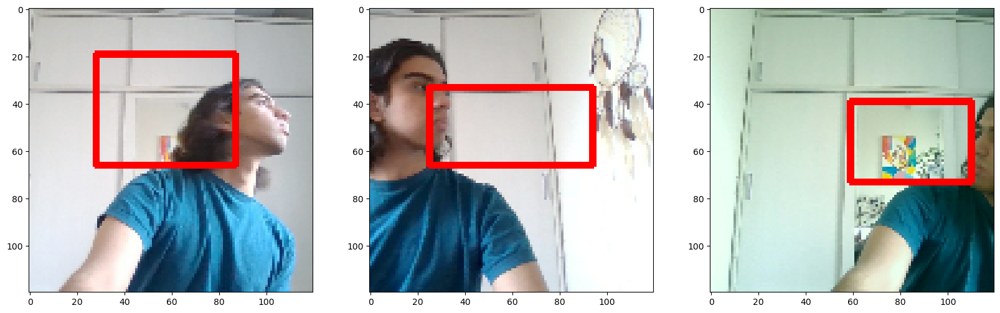

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999981 ],
       [0.99999887],
       [0.9999987 ],
       [0.9996401 ],
       [0.9999993 ],
       [0.9999812 ],
       [0.9999994 ],
       [0.99999994]], dtype=float32), array([[0.21200629, 0.3537415 , 0.79960966, 0.7298368 ],
       [0.26002014, 0.38405976, 0.75226676, 0.8215966 ],
       [0.35461974, 0.18005246, 0.8249528 , 0.5681814 ],
       [0.37752956, 0.36001945, 0.8241054 , 0.5944192 ],
       [0.19769193, 0.14333956, 0.76867557, 0.5196154 ],
       [0.19676413, 0.3306733 , 0.77668273, 0.7028333 ],
       [0.09599951, 0.38163686, 0.5584937 , 0.8352859 ],
       [0.04019015, 0.46345872, 0.5933391 , 0.8256046 ]], dtype=float32)]


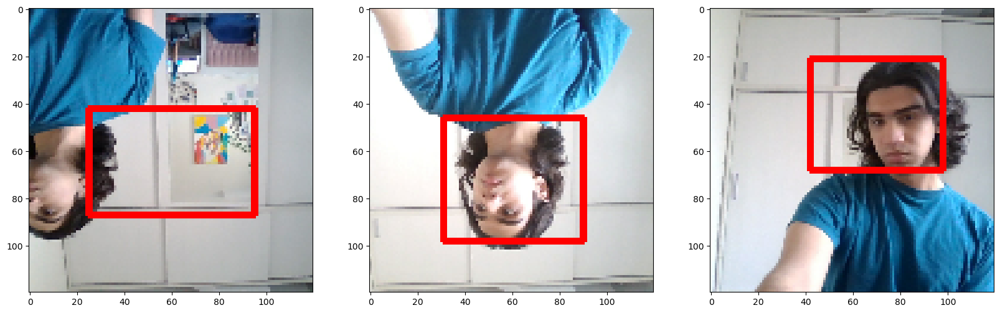

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.999995  ],
       [0.9999995 ],
       [0.9994922 ],
       [0.99998957],
       [0.9999995 ],
       [0.9999891 ],
       [0.99992585],
       [0.9991793 ]], dtype=float32), array([[0.6015433 , 0.40352502, 0.9700782 , 0.84672713],
       [0.17441638, 0.12215941, 0.551661  , 0.583642  ],
       [0.43328476, 0.35837317, 0.90980047, 0.7216666 ],
       [0.21016777, 0.39709052, 0.7602695 , 0.67984176],
       [0.07882629, 0.39432386, 0.4863219 , 0.8372787 ],
       [0.40965858, 0.4154862 , 0.877799  , 0.8116839 ],
       [0.425146  , 0.331621  , 0.9251287 , 0.7319648 ],
       [0.4923916 , 0.3371456 , 0.9287957 , 0.61068916]], dtype=float32)]


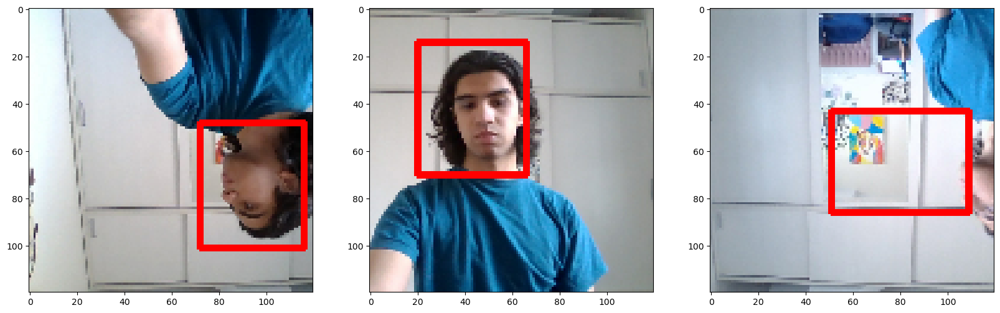

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.999999  ],
       [0.9999984 ],
       [0.99993193],
       [0.9999989 ],
       [0.99999833],
       [0.9999971 ],
       [0.9994854 ],
       [0.9999772 ]], dtype=float32), array([[0.45210803, 0.331181  , 0.9276061 , 0.8411765 ],
       [0.428371  , 0.1714946 , 0.9162141 , 0.62215316],
       [0.34681585, 0.34765753, 0.8542284 , 0.71357363],
       [0.1369272 , 0.1933386 , 0.51926553, 0.5405096 ],
       [0.15996504, 0.19243412, 0.61606556, 0.55010515],
       [0.16771996, 0.47520778, 0.707335  , 0.7683048 ],
       [0.47608957, 0.35430807, 0.9332922 , 0.70697355],
       [0.5422752 , 0.269622  , 0.96318555, 0.60498214]], dtype=float32)]


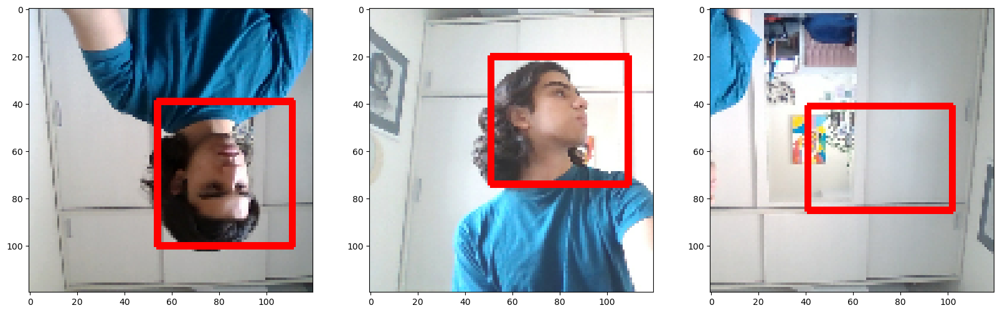

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999982 ],
       [0.9999991 ],
       [0.9999877 ],
       [0.9999673 ],
       [0.9999987 ],
       [0.99999297],
       [0.9999986 ],
       [0.99999666]], dtype=float32), array([[0.3350707 , 0.35722518, 0.8006856 , 0.8304375 ],
       [0.5061742 , 0.1683065 , 0.90961725, 0.6243535 ],
       [0.28466055, 0.39045873, 0.82873136, 0.7122266 ],
       [0.2861927 , 0.26614746, 0.7293123 , 0.5602844 ],
       [0.13354968, 0.46313423, 0.54588425, 0.85364646],
       [0.4884514 , 0.17230576, 0.9459206 , 0.57738096],
       [0.16593318, 0.4725009 , 0.6623676 , 0.83916813],
       [0.1768876 , 0.19445515, 0.56989324, 0.5811286 ]], dtype=float32)]


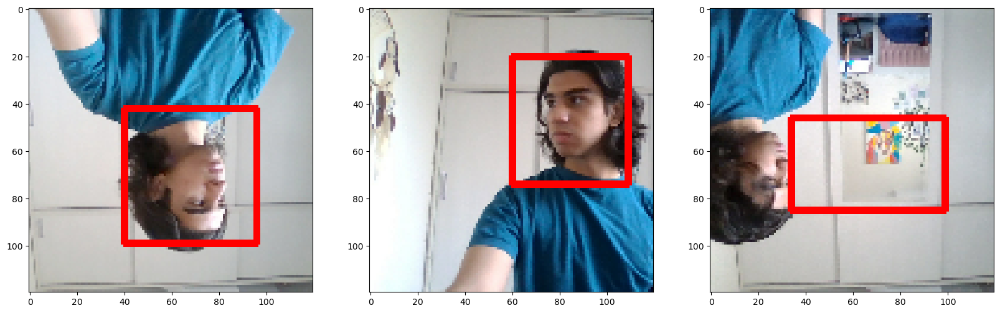

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9995788 ],
       [0.99998915],
       [0.99999946],
       [0.9999687 ],
       [0.99999905],
       [0.99999887],
       [0.99999446],
       [0.9999996 ]], dtype=float32), array([[0.4892993 , 0.3709891 , 0.9322592 , 0.7041416 ],
       [0.58298767, 0.3901089 , 0.9678928 , 0.8275726 ],
       [0.07344712, 0.38458908, 0.48967424, 0.8413599 ],
       [0.35765225, 0.31831387, 0.9022421 , 0.70913297],
       [0.4313218 , 0.14709982, 0.9414286 , 0.6012101 ],
       [0.51591635, 0.35376638, 0.93261606, 0.8541642 ],
       [0.34091073, 0.39847037, 0.8938989 , 0.8264925 ],
       [0.11928619, 0.10326434, 0.4758797 , 0.5651736 ]], dtype=float32)]


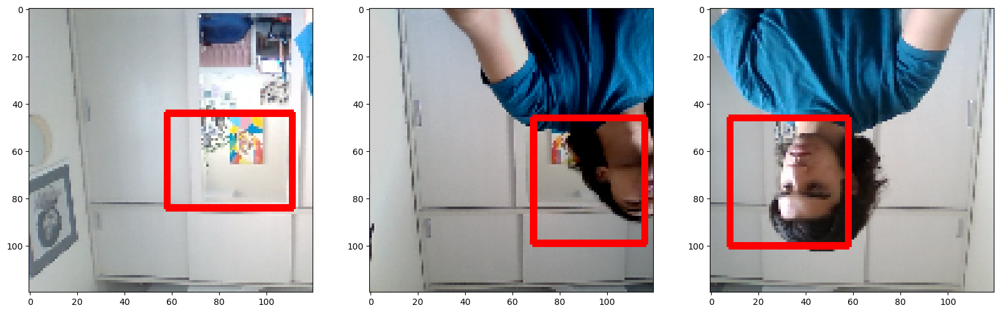

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999273 ],
       [0.99929225],
       [0.9993673 ],
       [0.999999  ],
       [0.99999636],
       [0.9999993 ],
       [0.9999684 ],
       [0.9999985 ]], dtype=float32), array([[0.22295341, 0.39516014, 0.82234985, 0.6571333 ],
       [0.38322368, 0.43921435, 0.87886477, 0.69353956],
       [0.43384486, 0.3433921 , 0.9269025 , 0.61727995],
       [0.45388594, 0.352222  , 0.90996873, 0.85135823],
       [0.12666504, 0.38458672, 0.6481645 , 0.7393879 ],
       [0.10797323, 0.17964424, 0.5913576 , 0.5801248 ],
       [0.47701722, 0.36904177, 0.944085  , 0.79077107],
       [0.1702534 , 0.41578054, 0.65360725, 0.7734254 ]], dtype=float32)]


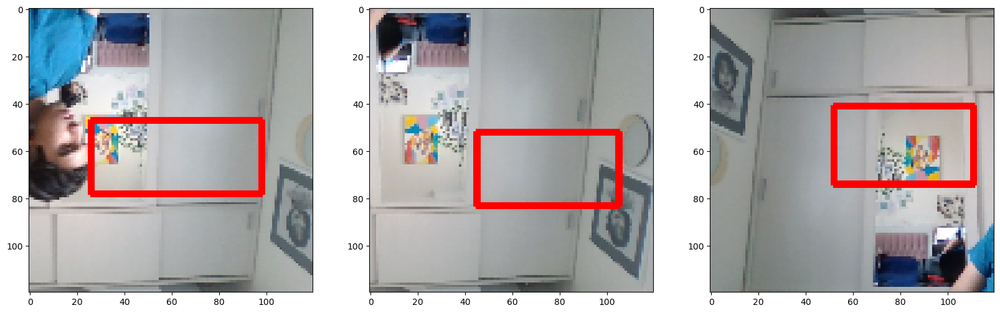

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999994],
       [0.9999984 ],
       [0.99992436],
       [0.9999996 ],
       [0.99999964],
       [0.9999862 ],
       [0.9999879 ],
       [0.9993804 ]], dtype=float32), array([[0.07753015, 0.18719289, 0.4767239 , 0.55729854],
       [0.13516265, 0.44054857, 0.55703264, 0.8560276 ],
       [0.4069664 , 0.34201348, 0.92173654, 0.72674215],
       [0.19188248, 0.10430989, 0.58533263, 0.57905954],
       [0.24281573, 0.14571124, 0.75293404, 0.5810418 ],
       [0.38620436, 0.38777387, 0.86030823, 0.81330967],
       [0.14986053, 0.33819795, 0.7180446 , 0.7318009 ],
       [0.48205224, 0.3674621 , 0.93266934, 0.7037515 ]], dtype=float32)]


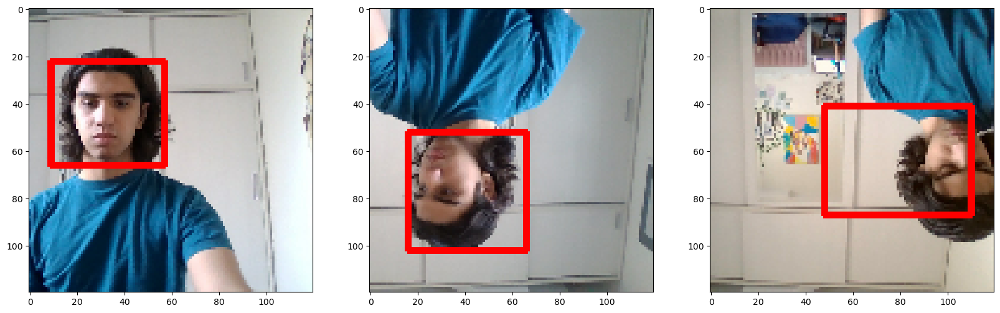

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999917],
       [0.99998575],
       [0.99877554],
       [0.9999949 ],
       [0.99978703],
       [0.9996974 ],
       [0.9999513 ],
       [0.99999946]], dtype=float32), array([[0.13771231, 0.50017595, 0.7461261 , 0.7622107 ],
       [0.55129457, 0.3841037 , 0.96807086, 0.82825243],
       [0.43226284, 0.42712036, 0.870546  , 0.55845594],
       [0.2907441 , 0.19438043, 0.78986895, 0.5701295 ],
       [0.58451337, 0.42315573, 0.9448902 , 0.72031987],
       [0.4665175 , 0.3963773 , 0.91497344, 0.67139053],
       [0.47265694, 0.37278664, 0.9413231 , 0.76303625],
       [0.19822502, 0.10558408, 0.6228329 , 0.5932936 ]], dtype=float32)]


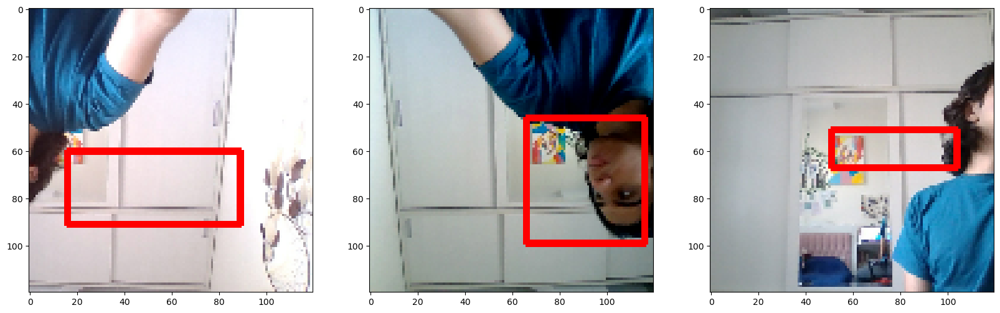

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999927 ],
       [0.99999994],
       [0.9999687 ],
       [0.99999917],
       [0.999999  ],
       [0.9999943 ],
       [0.99999833],
       [0.9999998 ]], dtype=float32), array([[0.18911706, 0.21895984, 0.73437375, 0.5588105 ],
       [0.09393125, 0.19039103, 0.49715236, 0.4807824 ],
       [0.3348349 , 0.3457833 , 0.89166963, 0.73484963],
       [0.09316278, 0.37322965, 0.55691266, 0.8519009 ],
       [0.16608338, 0.13689737, 0.5921728 , 0.59216166],
       [0.15793586, 0.20966105, 0.63224685, 0.5303848 ],
       [0.15193379, 0.158918  , 0.5925565 , 0.5324278 ],
       [0.18003486, 0.15267992, 0.6885443 , 0.6173922 ]], dtype=float32)]


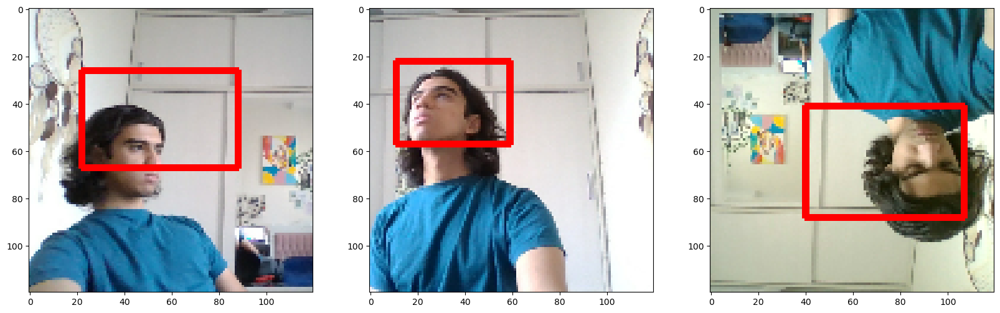

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999719 ],
       [0.9999997 ],
       [0.99925095],
       [0.99999505],
       [0.99999934],
       [0.9999996 ],
       [0.99999976],
       [1.        ]], dtype=float32), array([[0.65515435, 0.38948086, 0.97335744, 0.81825584],
       [0.31871587, 0.13414522, 0.7887988 , 0.60981715],
       [0.4308659 , 0.3629964 , 0.9112339 , 0.6965202 ],
       [0.47569737, 0.20629808, 0.96211445, 0.6157311 ],
       [0.37025133, 0.14314573, 0.8405745 , 0.54429394],
       [0.17238131, 0.14004162, 0.72550666, 0.5337105 ],
       [0.10795572, 0.20367211, 0.5421674 , 0.562901  ],
       [0.08575834, 0.18741952, 0.569203  , 0.5344995 ]], dtype=float32)]


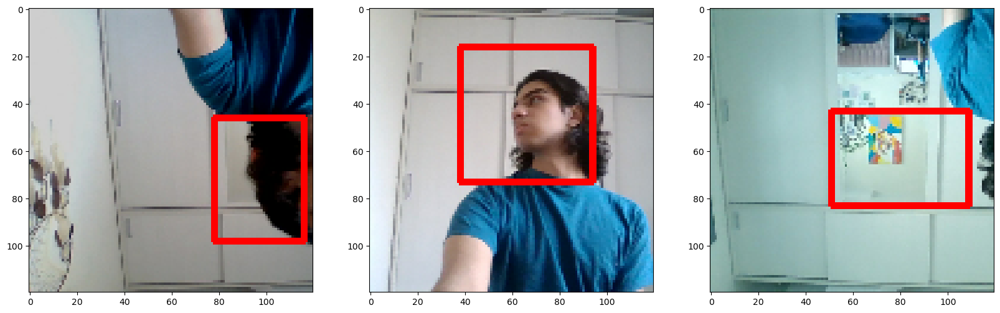

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99998367],
       [0.99999535],
       [0.99999934],
       [0.999999  ],
       [0.9999988 ],
       [0.9999998 ],
       [0.99999976],
       [0.9999995 ]], dtype=float32), array([[0.3807268 , 0.3843119 , 0.91482407, 0.7569252 ],
       [0.36901215, 0.3647994 , 0.8609147 , 0.80480427],
       [0.10579366, 0.4950006 , 0.5890583 , 0.7873966 ],
       [0.12131044, 0.35336944, 0.6693476 , 0.8481302 ],
       [0.56330395, 0.4022729 , 0.97467184, 0.8738672 ],
       [0.02761201, 0.44079888, 0.35850263, 0.84057474],
       [0.08728797, 0.15331692, 0.568342  , 0.58733547],
       [0.04255062, 0.4024865 , 0.40412307, 0.8170626 ]], dtype=float32)]


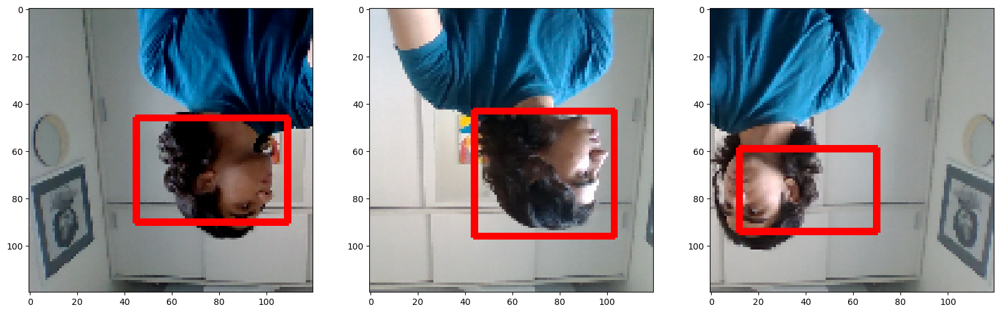

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99995315],
       [0.9999985 ],
       [0.99999976],
       [0.9999997 ],
       [0.9999986 ],
       [0.99991727],
       [0.9999951 ],
       [0.999993  ]], dtype=float32), array([[0.22934276, 0.25075898, 0.7466505 , 0.6296323 ],
       [0.28188834, 0.37746164, 0.7456    , 0.8284749 ],
       [0.24743529, 0.12601872, 0.7725119 , 0.58454645],
       [0.0657048 , 0.37911126, 0.48453403, 0.8521408 ],
       [0.13229884, 0.17104836, 0.60482526, 0.5660838 ],
       [0.57862   , 0.35339049, 0.9595852 , 0.76394427],
       [0.16839151, 0.39621636, 0.6480999 , 0.7216002 ],
       [0.29937023, 0.3714832 , 0.87830555, 0.75992787]], dtype=float32)]


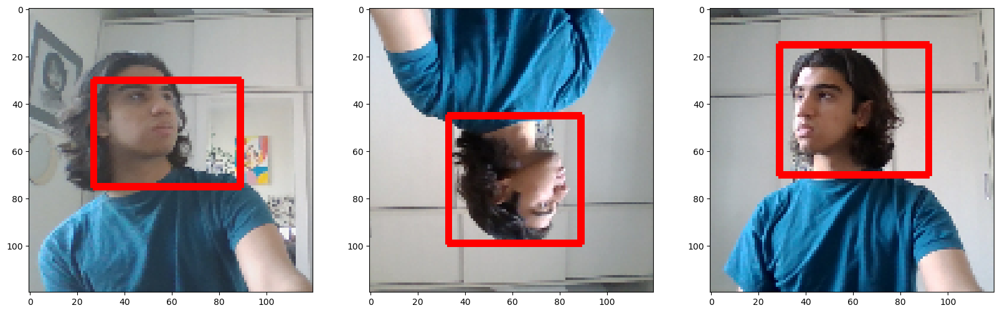

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999976],
       [0.9999997 ],
       [0.9999984 ],
       [0.99999887],
       [0.99999934],
       [0.99999684],
       [0.9999279 ],
       [0.9999989 ]], dtype=float32), array([[0.15984884, 0.28000554, 0.65670717, 0.4600864 ],
       [0.03962199, 0.38935304, 0.39645737, 0.83902043],
       [0.27017424, 0.39014265, 0.7390543 , 0.8245573 ],
       [0.1292737 , 0.14013931, 0.57633513, 0.5434272 ],
       [0.34525582, 0.11548652, 0.8485539 , 0.57841754],
       [0.15203635, 0.36563352, 0.6738138 , 0.82824695],
       [0.44105008, 0.39269945, 0.9330616 , 0.7693208 ],
       [0.1530075 , 0.18944877, 0.65105355, 0.5366322 ]], dtype=float32)]


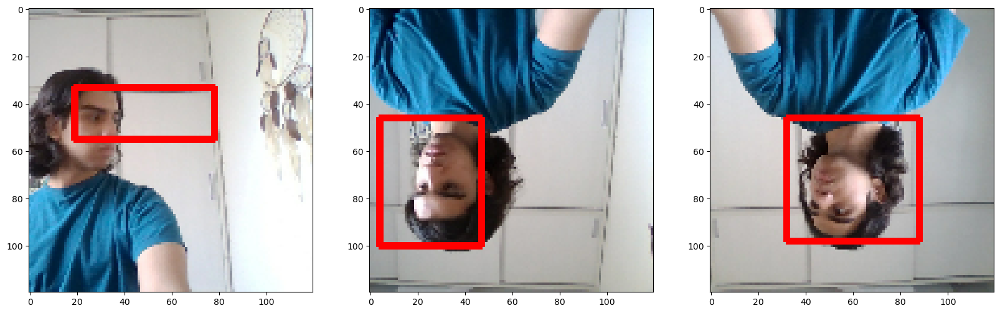

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999865 ],
       [0.999999  ],
       [0.9995274 ],
       [0.9999999 ],
       [0.9999988 ],
       [0.9999798 ],
       [0.9999988 ],
       [0.99999756]], dtype=float32), array([[0.45342782, 0.42908257, 0.9273638 , 0.76241946],
       [0.15128958, 0.16309349, 0.6393894 , 0.53719115],
       [0.423615  , 0.3389973 , 0.9322176 , 0.62411594],
       [0.16204396, 0.18194681, 0.6679348 , 0.5116217 ],
       [0.24880254, 0.39656776, 0.7233257 , 0.83521855],
       [0.21900935, 0.34670314, 0.777667  , 0.7602709 ],
       [0.10997331, 0.39512652, 0.58325034, 0.827088  ],
       [0.5482185 , 0.37033266, 0.9488314 , 0.844527  ]], dtype=float32)]


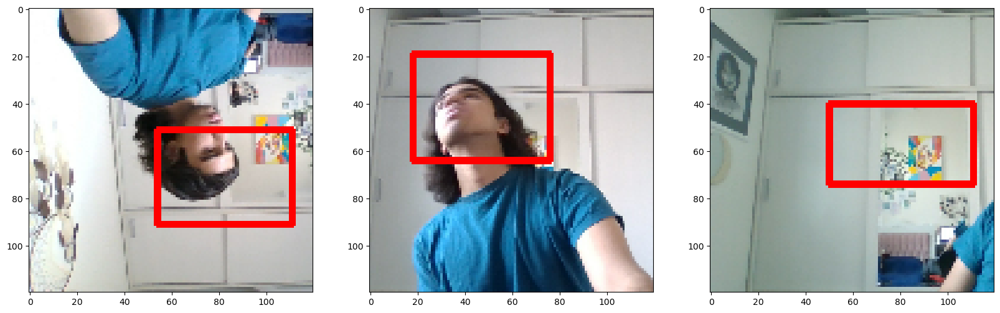

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999986 ],
       [0.9999999 ],
       [0.999991  ],
       [0.99999976],
       [0.99964815],
       [0.99997354],
       [0.9999994 ],
       [0.99926484]], dtype=float32), array([[0.11789321, 0.1941697 , 0.5830023 , 0.6016126 ],
       [0.36178166, 0.09467008, 0.9050356 , 0.61122155],
       [0.3833436 , 0.41581887, 0.92083853, 0.7920653 ],
       [0.21105061, 0.13814342, 0.7037635 , 0.563543  ],
       [0.34788093, 0.39973193, 0.8709766 , 0.70016927],
       [0.2724493 , 0.50653505, 0.8300331 , 0.7153741 ],
       [0.07701761, 0.3896673 , 0.51905525, 0.82908493],
       [0.4552422 , 0.3716753 , 0.89132994, 0.56642056]], dtype=float32)]


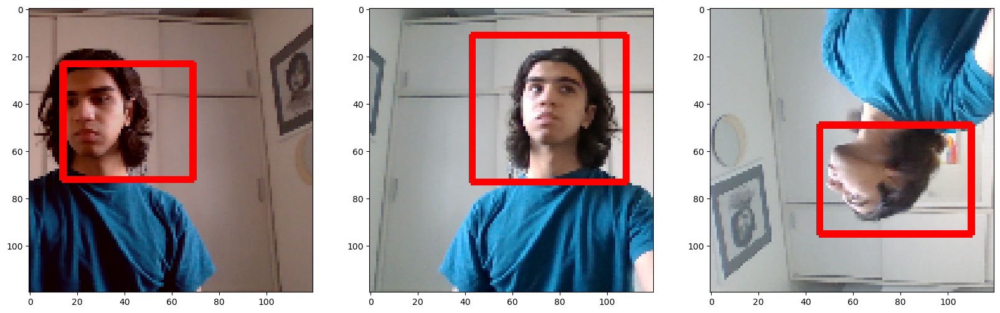

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999985 ],
       [0.9999987 ],
       [0.99865884],
       [0.9999996 ],
       [0.99998766],
       [0.99998486],
       [0.9999997 ],
       [0.9999992 ]], dtype=float32), array([[0.14015062, 0.37582573, 0.6436012 , 0.8240632 ],
       [0.18949264, 0.2174769 , 0.68869126, 0.50702953],
       [0.46271944, 0.4387172 , 0.8879849 , 0.59699893],
       [0.07870868, 0.38789457, 0.5711825 , 0.8525216 ],
       [0.45095426, 0.38423046, 0.94059825, 0.7670733 ],
       [0.2760062 , 0.37461963, 0.6844413 , 0.7554378 ],
       [0.2834484 , 0.13547184, 0.78785515, 0.6024315 ],
       [0.20069624, 0.13186145, 0.67272294, 0.5366171 ]], dtype=float32)]


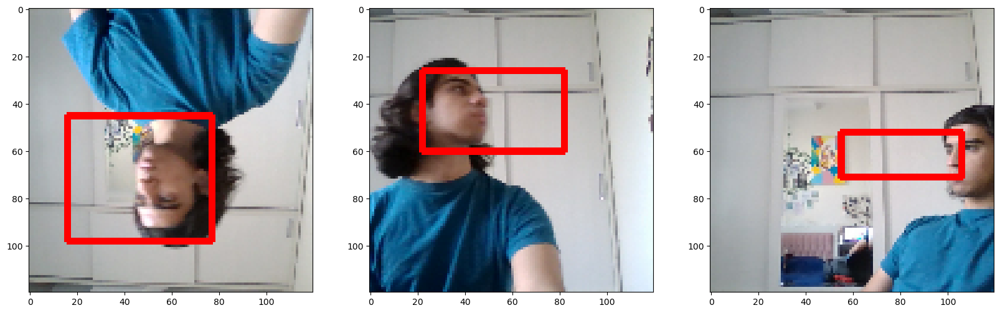

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999964],
       [0.99999857],
       [0.99999374],
       [0.9999851 ],
       [0.9999798 ],
       [0.99999976],
       [0.99999887],
       [0.9999997 ]], dtype=float32), array([[0.26125786, 0.12010641, 0.7761058 , 0.5831437 ],
       [0.23717149, 0.4124164 , 0.72338176, 0.83242995],
       [0.64960694, 0.39339134, 0.9782871 , 0.85553575],
       [0.41377187, 0.38721412, 0.9307008 , 0.783483  ],
       [0.26579073, 0.41971874, 0.83286214, 0.7377851 ],
       [0.25326252, 0.12477646, 0.7767423 , 0.57447696],
       [0.65485287, 0.4120438 , 0.98503613, 0.8599508 ],
       [0.24596155, 0.13138276, 0.754076  , 0.5919156 ]], dtype=float32)]


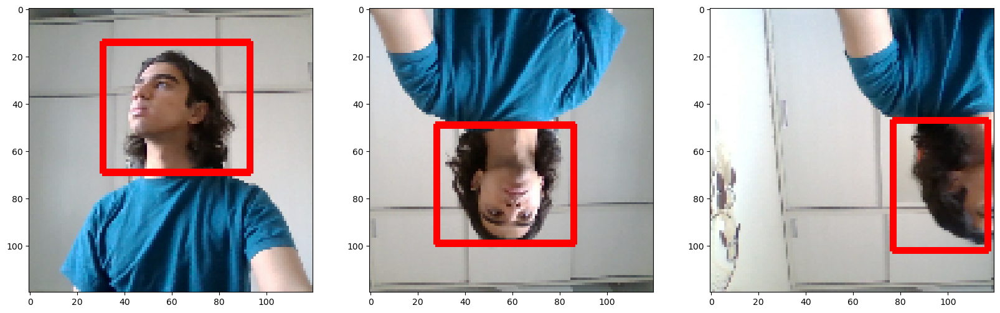

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9984696 ],
       [0.9999995 ],
       [0.9999987 ],
       [0.99997795],
       [0.9999983 ],
       [0.99999416],
       [0.9999913 ],
       [0.9999362 ]], dtype=float32), array([[0.4389994 , 0.4121153 , 0.8739282 , 0.56280833],
       [0.43107736, 0.12461493, 0.8528104 , 0.6014999 ],
       [0.2612948 , 0.12786183, 0.6769891 , 0.61157   ],
       [0.40331346, 0.3716079 , 0.91800934, 0.8003664 ],
       [0.17447615, 0.471208  , 0.77092075, 0.75117284],
       [0.30518317, 0.41284844, 0.8566316 , 0.7814466 ],
       [0.15966901, 0.45881253, 0.66514015, 0.77126765],
       [0.3508733 , 0.36008504, 0.8561436 , 0.7089464 ]], dtype=float32)]


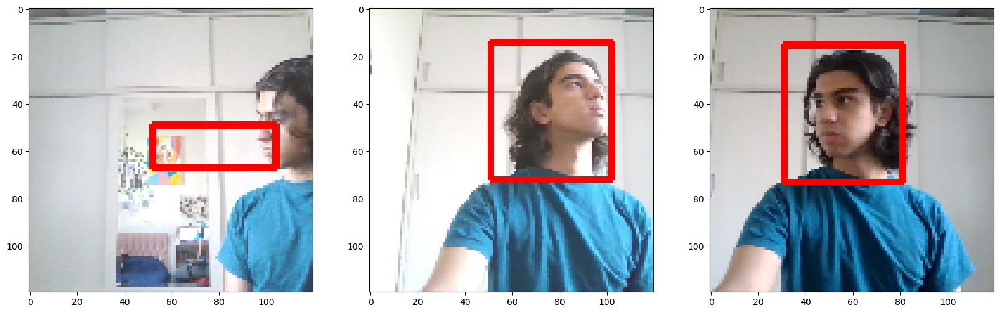

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 154ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9998028],
       [0.9999725],
       [0.9999978],
       [0.9999965],
       [0.9999983],
       [0.9999969],
       [0.9999997],
       [0.9999991]], dtype=float32), array([[0.37673378, 0.29037794, 0.8771572 , 0.51336133],
       [0.2234715 , 0.34313518, 0.8025065 , 0.7311055 ],
       [0.57994473, 0.4362091 , 0.9627226 , 0.86582243],
       [0.28999794, 0.19619462, 0.8102428 , 0.5411726 ],
       [0.17025344, 0.21070611, 0.6724546 , 0.5402545 ],
       [0.11787972, 0.36405224, 0.64675295, 0.77684754],
       [0.23967394, 0.12600699, 0.7505524 , 0.5820062 ],
       [0.16331069, 0.15543342, 0.7266518 , 0.55068064]], dtype=float32)]


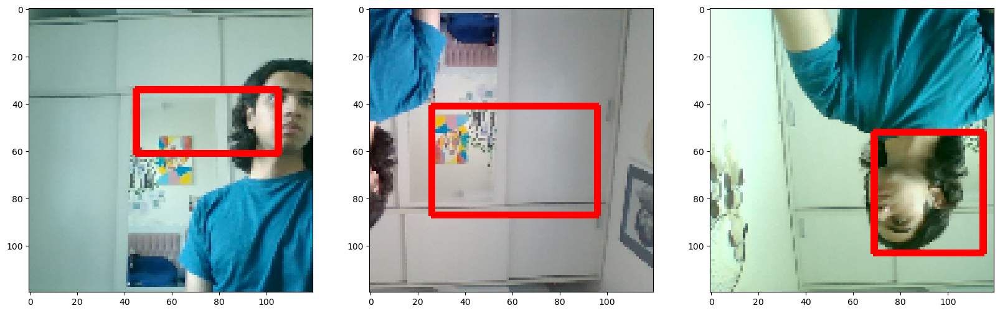

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999994],
       [0.99999833],
       [0.9999995 ],
       [0.99999905],
       [0.99997914],
       [0.99999213],
       [0.9999989 ],
       [0.99999994]], dtype=float32), array([[0.16595353, 0.23627368, 0.7038398 , 0.5239922 ],
       [0.13379657, 0.35596085, 0.665066  , 0.83666   ],
       [0.1239441 , 0.49128872, 0.59985363, 0.7881789 ],
       [0.17288989, 0.42898884, 0.55716586, 0.85759103],
       [0.4108265 , 0.39367115, 0.923534  , 0.81295836],
       [0.35529485, 0.41166776, 0.907818  , 0.785761  ],
       [0.39565685, 0.13286895, 0.9023776 , 0.5970532 ],
       [0.13457786, 0.18855636, 0.5810994 , 0.5498281 ]], dtype=float32)]


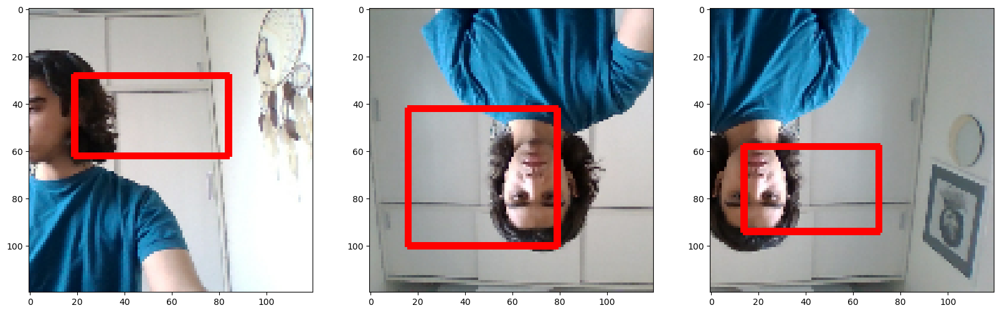

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999979 ],
       [0.99972373],
       [0.99999636],
       [0.9999736 ],
       [0.99999803],
       [0.9999633 ],
       [0.99949497],
       [0.9999995 ]], dtype=float32), array([[0.6575193 , 0.41720393, 0.98441094, 0.84286785],
       [0.5197329 , 0.39617783, 0.92662007, 0.6785232 ],
       [0.32587886, 0.14908502, 0.7767343 , 0.55566823],
       [0.47669205, 0.38581672, 0.9412229 , 0.8062906 ],
       [0.28344867, 0.38031054, 0.76186556, 0.8281051 ],
       [0.53260016, 0.25742012, 0.93280095, 0.63540924],
       [0.4496071 , 0.3467197 , 0.9268153 , 0.71439004],
       [0.13166088, 0.49994093, 0.738866  , 0.80384   ]], dtype=float32)]


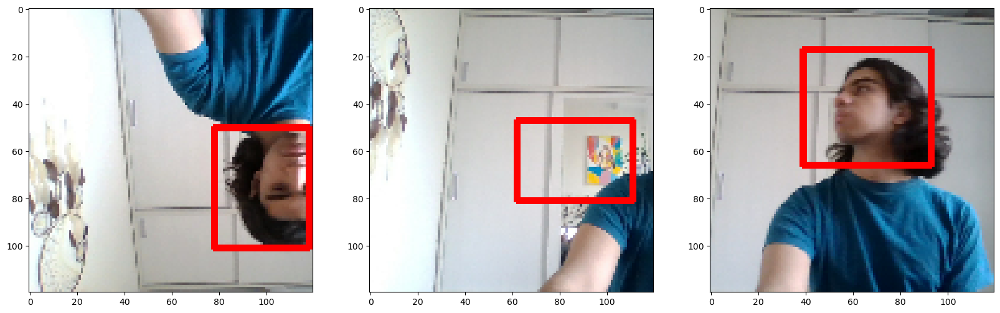

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99997497],
       [0.9999997 ],
       [0.99999833],
       [0.9999987 ],
       [0.99999994],
       [0.9999999 ],
       [0.99999493],
       [0.9999993 ]], dtype=float32), array([[0.20521232, 0.24200529, 0.6756113 , 0.56009245],
       [0.17732228, 0.29801953, 0.6883752 , 0.4962628 ],
       [0.12478028, 0.14455348, 0.49877167, 0.5152105 ],
       [0.62245834, 0.42515782, 0.9840909 , 0.8533848 ],
       [0.03104811, 0.4425525 , 0.5294764 , 0.8070165 ],
       [0.13125405, 0.26101965, 0.59094477, 0.48631975],
       [0.16857739, 0.23896497, 0.6597594 , 0.53982306],
       [0.07656677, 0.4471275 , 0.63065886, 0.7428764 ]], dtype=float32)]


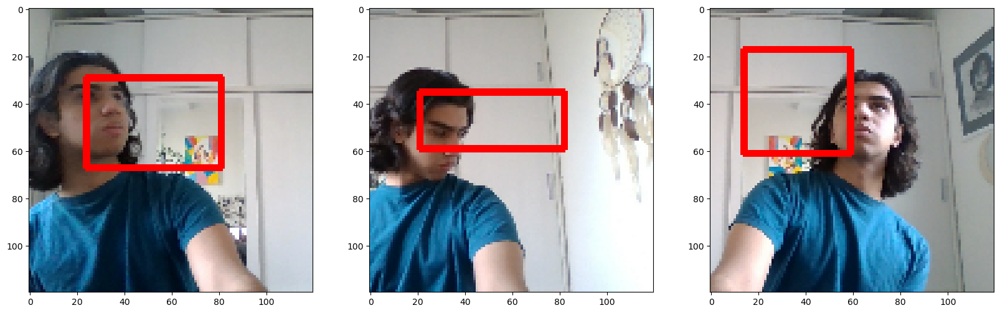

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999905],
       [0.9999981 ],
       [0.9999926 ],
       [0.9999899 ],
       [0.99999666],
       [0.9999947 ],
       [0.9997987 ],
       [0.9999998 ]], dtype=float32), array([[0.22316536, 0.10287323, 0.6742983 , 0.58631885],
       [0.6211617 , 0.38431126, 0.9794491 , 0.8619001 ],
       [0.32422522, 0.37321255, 0.8809791 , 0.77045816],
       [0.2156023 , 0.43588594, 0.7640746 , 0.7389108 ],
       [0.23160814, 0.22103323, 0.68669367, 0.55667096],
       [0.2751502 , 0.39999586, 0.82862526, 0.82277274],
       [0.46506035, 0.32332456, 0.9289837 , 0.7628527 ],
       [0.15609626, 0.17162925, 0.6577467 , 0.52062464]], dtype=float32)]


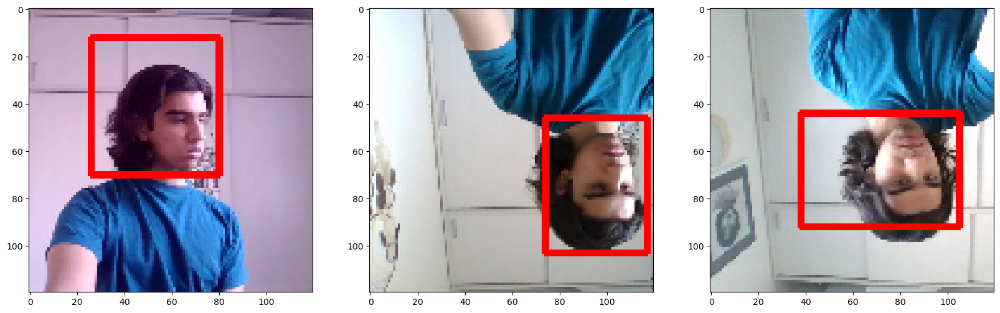

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999739 ],
       [0.9999993 ],
       [0.99998116],
       [0.9999994 ],
       [0.9999955 ],
       [0.99999917],
       [0.9999984 ],
       [0.99999946]], dtype=float32), array([[0.4298452 , 0.37889954, 0.9317981 , 0.79560685],
       [0.16217034, 0.12759833, 0.592716  , 0.5623789 ],
       [0.48055333, 0.39160278, 0.9494716 , 0.81499654],
       [0.3564374 , 0.11238951, 0.82807666, 0.5769353 ],
       [0.2376888 , 0.37894282, 0.7884895 , 0.72210956],
       [0.5261313 , 0.37066224, 0.9394832 , 0.865245  ],
       [0.12215383, 0.18096825, 0.48830235, 0.53664935],
       [0.5108025 , 0.13017784, 0.9201161 , 0.59438294]], dtype=float32)]


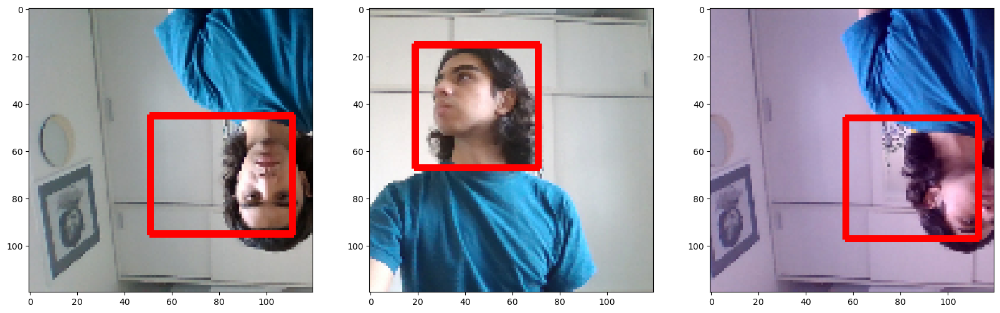

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999818 ],
       [0.99999976],
       [0.9999997 ],
       [0.99999255],
       [0.9999997 ],
       [0.9999805 ],
       [0.99999964],
       [0.99991727]], dtype=float32), array([[0.20866022, 0.42823702, 0.80808496, 0.66877204],
       [0.28374514, 0.11496054, 0.80964077, 0.5796616 ],
       [0.23414674, 0.12589951, 0.799705  , 0.56873256],
       [0.3467136 , 0.38810995, 0.89421535, 0.8232676 ],
       [0.28961608, 0.13784198, 0.7961961 , 0.58959925],
       [0.29625714, 0.39838526, 0.8525193 , 0.73264027],
       [0.10397703, 0.21479101, 0.62630177, 0.45283657],
       [0.2547046 , 0.32171136, 0.71329355, 0.5570651 ]], dtype=float32)]


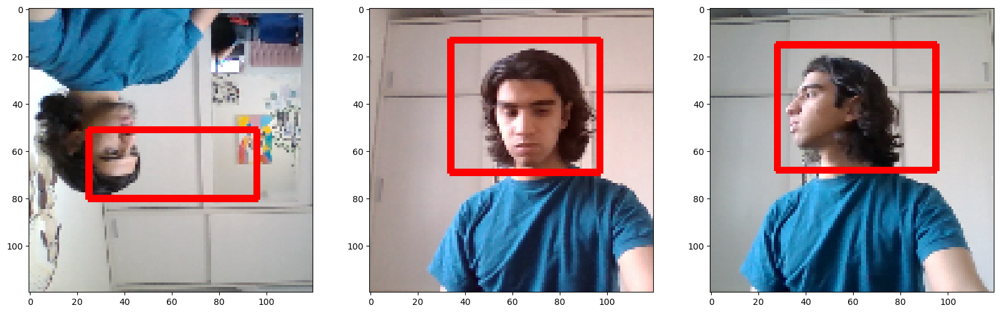

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999934],
       [0.99997866],
       [0.9999982 ],
       [0.9999992 ],
       [0.9999995 ],
       [0.99999344],
       [0.9999976 ],
       [0.9999995 ]], dtype=float32), array([[0.5348701 , 0.15520516, 0.9131402 , 0.627101  ],
       [0.2168619 , 0.39419517, 0.7475827 , 0.7057823 ],
       [0.29808357, 0.3740563 , 0.7489948 , 0.82678   ],
       [0.21092719, 0.11713134, 0.6669376 , 0.6111454 ],
       [0.1856297 , 0.14189142, 0.6791549 , 0.529432  ],
       [0.21129513, 0.36670312, 0.61243176, 0.77733463],
       [0.2806491 , 0.38590783, 0.8536143 , 0.8465293 ],
       [0.44800937, 0.15266494, 0.8470897 , 0.594802  ]], dtype=float32)]


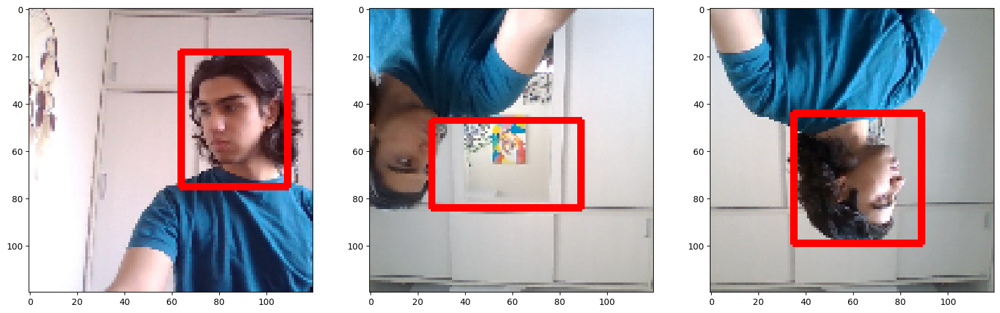

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999815 ],
       [0.9999995 ],
       [0.99999666],
       [0.99947494],
       [0.9999996 ],
       [0.99999946],
       [0.9999908 ],
       [0.99999994]], dtype=float32), array([[0.6437293 , 0.43830416, 0.97994375, 0.83792293],
       [0.1216981 , 0.43295416, 0.6132584 , 0.85412043],
       [0.40198272, 0.18784401, 0.89662397, 0.6297042 ],
       [0.43245864, 0.3378574 , 0.91983396, 0.7159823 ],
       [0.43519163, 0.14633109, 0.87721986, 0.6261411 ],
       [0.39835578, 0.11523257, 0.89494115, 0.5672748 ],
       [0.65515643, 0.35411876, 0.9785045 , 0.86301816],
       [0.01881451, 0.42161664, 0.37559092, 0.852932  ]], dtype=float32)]


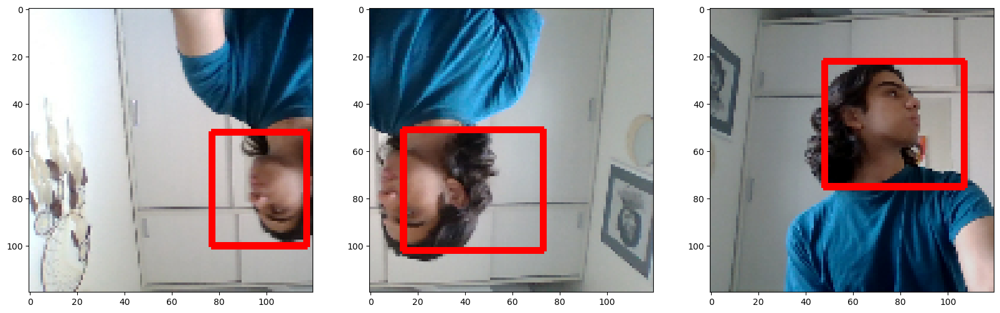

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999845],
       [0.99999654],
       [0.99999976],
       [0.9999969 ],
       [0.9999988 ],
       [0.9984603 ],
       [0.99999905],
       [0.9999993 ]], dtype=float32), array([[0.10025489, 0.3995108 , 0.5494667 , 0.7918491 ],
       [0.25360325, 0.39930508, 0.81147414, 0.80270034],
       [0.29908258, 0.12732045, 0.7636478 , 0.64431024],
       [0.4301377 , 0.18113153, 0.87068915, 0.58373857],
       [0.45462963, 0.3270626 , 0.9260714 , 0.842448  ],
       [0.45861572, 0.4178018 , 0.88414484, 0.63555765],
       [0.44508326, 0.3663997 , 0.8864676 , 0.8377621 ],
       [0.13115488, 0.25080684, 0.60901403, 0.47936305]], dtype=float32)]


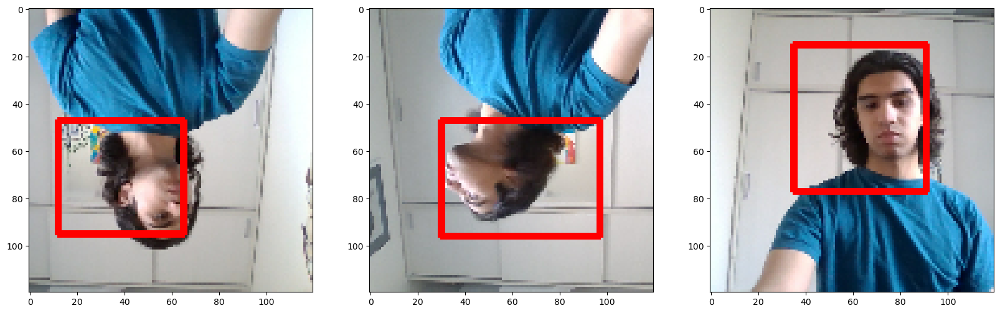

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999998 ],
       [0.99997616],
       [0.9999995 ],
       [0.99870646],
       [0.99999887],
       [0.9999547 ],
       [0.99999136],
       [0.99986607]], dtype=float32), array([[0.25731248, 0.11209298, 0.7511586 , 0.5934027 ],
       [0.24806668, 0.23062855, 0.74490243, 0.57990474],
       [0.11781287, 0.11150002, 0.47517154, 0.5588148 ],
       [0.42181653, 0.41660348, 0.86493516, 0.5567066 ],
       [0.19839941, 0.4043986 , 0.6046331 , 0.8468377 ],
       [0.39999402, 0.3391359 , 0.9218703 , 0.7320459 ],
       [0.46287537, 0.26197633, 0.90676916, 0.63237727],
       [0.5644549 , 0.34279013, 0.9463561 , 0.7539793 ]], dtype=float32)]


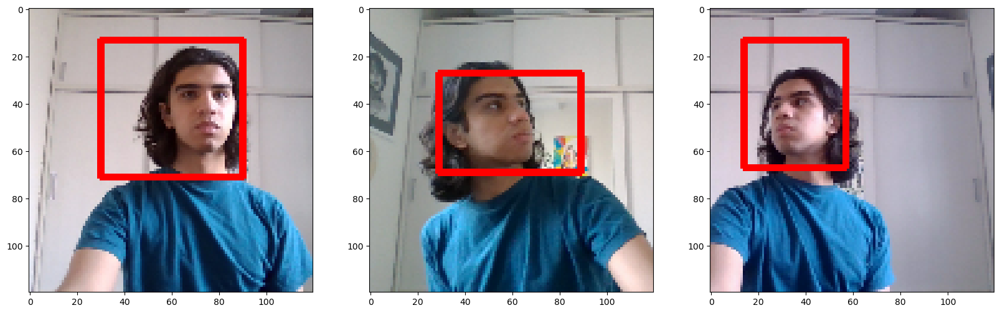

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999076],
       [0.9999999 ],
       [0.9999996 ],
       [0.9999992 ],
       [0.9999995 ],
       [0.9999955 ],
       [0.99999946],
       [0.99999565]], dtype=float32), array([[0.23593388, 0.47553104, 0.70948386, 0.7790579 ],
       [0.29285496, 0.11383662, 0.7418373 , 0.63865113],
       [0.04298654, 0.40545207, 0.42747867, 0.8370824 ],
       [0.29275706, 0.13330469, 0.7253615 , 0.57501495],
       [0.19293983, 0.11038709, 0.5777446 , 0.5816678 ],
       [0.2951279 , 0.21703254, 0.77543914, 0.49991956],
       [0.46742433, 0.17928356, 0.90121365, 0.61793816],
       [0.19857745, 0.2100102 , 0.5780399 , 0.5569954 ]], dtype=float32)]


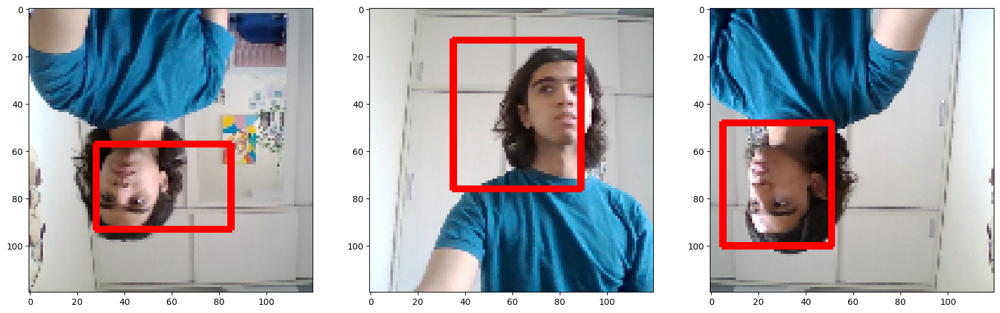

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999845],
       [0.99998903],
       [0.99999005],
       [0.9999996 ],
       [0.99999917],
       [1.        ],
       [0.9999983 ],
       [0.9999995 ]], dtype=float32), array([[0.15637603, 0.11202492, 0.5625118 , 0.5209812 ],
       [0.25830352, 0.37780434, 0.84998053, 0.74030644],
       [0.37254447, 0.38865855, 0.8571326 , 0.82160854],
       [0.23485267, 0.2641295 , 0.78994507, 0.57137007],
       [0.53494656, 0.1757772 , 0.93317455, 0.62761074],
       [0.02146522, 0.4239796 , 0.47289163, 0.84251904],
       [0.12645325, 0.3699133 , 0.6288254 , 0.77839226],
       [0.47921962, 0.11498459, 0.9470638 , 0.6010705 ]], dtype=float32)]


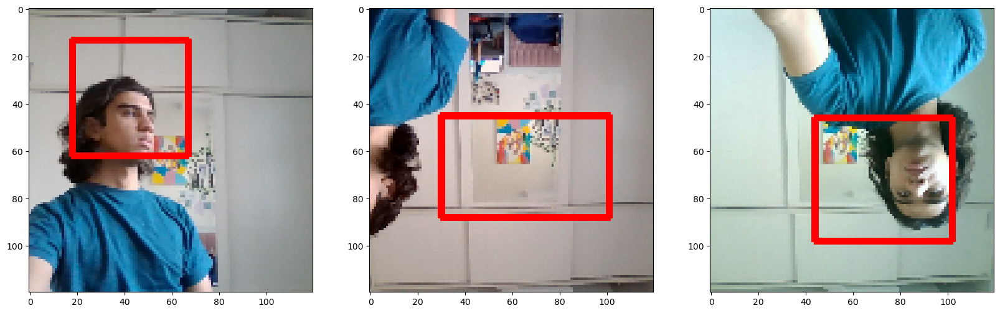

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999076],
       [0.99999696],
       [0.9999981 ],
       [0.99999934],
       [0.9999999 ],
       [0.9999996 ],
       [0.9999975 ],
       [0.9999983 ]], dtype=float32), array([[0.4514864 , 0.41473508, 0.9332594 , 0.8283725 ],
       [0.53848267, 0.16529548, 0.96788526, 0.5921472 ],
       [0.61232877, 0.40045944, 0.98153234, 0.8546541 ],
       [0.20519902, 0.11804479, 0.65792525, 0.59025216],
       [0.14033194, 0.1281805 , 0.6467911 , 0.6038499 ],
       [0.20079681, 0.10313416, 0.64438295, 0.58796215],
       [0.4494517 , 0.16449094, 0.8609237 , 0.5748177 ],
       [0.5572058 , 0.36304218, 0.9679098 , 0.84760654]], dtype=float32)]


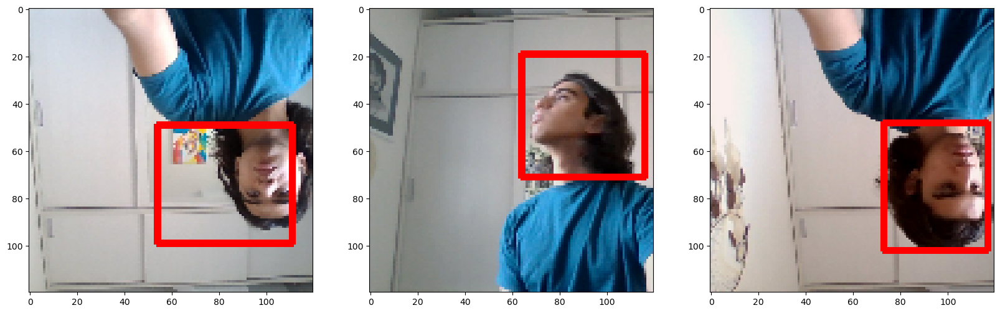

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999696],
       [0.9999678 ],
       [0.99998856],
       [0.9999994 ],
       [0.9999994 ],
       [0.9999991 ],
       [0.99948364],
       [0.9999956 ]], dtype=float32), array([[0.295662  , 0.21584497, 0.86375445, 0.54180574],
       [0.46527275, 0.41277257, 0.9266305 , 0.79212713],
       [0.63090944, 0.41787416, 0.977147  , 0.81995726],
       [0.35276377, 0.14246255, 0.7642775 , 0.6026238 ],
       [0.05228261, 0.43287992, 0.45694396, 0.8207161 ],
       [0.10291418, 0.37142125, 0.600297  , 0.85286117],
       [0.48086667, 0.339449  , 0.9216847 , 0.7165059 ],
       [0.18851787, 0.37917325, 0.69273776, 0.7690262 ]], dtype=float32)]


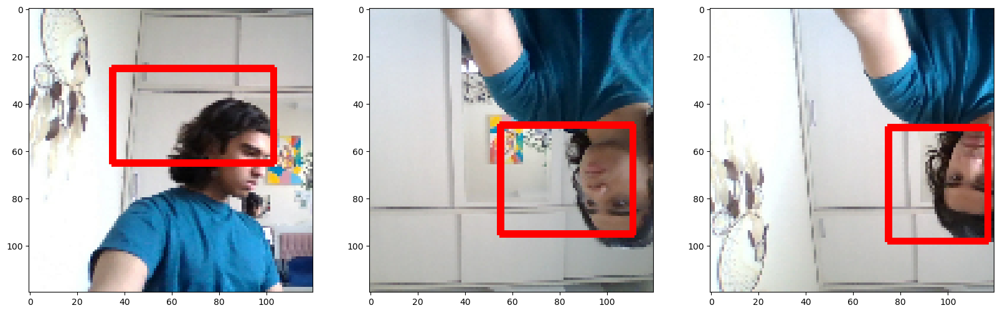

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999996 ],
       [0.9999842 ],
       [0.9999978 ],
       [0.9999995 ],
       [0.99999857],
       [0.9999999 ],
       [0.99999344],
       [0.99931693]], dtype=float32), array([[0.16915883, 0.11179228, 0.550359  , 0.5873548 ],
       [0.33322597, 0.2850416 , 0.801688  , 0.5483005 ],
       [0.13926794, 0.1844272 , 0.56723696, 0.5269806 ],
       [0.11786713, 0.21520208, 0.64307964, 0.4516724 ],
       [0.16618374, 0.21656671, 0.70743287, 0.5511664 ],
       [0.3605813 , 0.12945542, 0.84684384, 0.6125346 ],
       [0.4577469 , 0.42299816, 0.9498806 , 0.7816179 ],
       [0.35121614, 0.3972627 , 0.84008616, 0.6100662 ]], dtype=float32)]


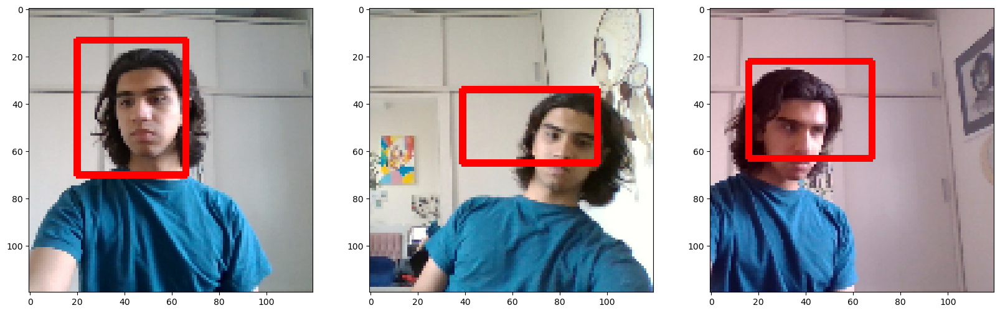

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999966 ],
       [0.99999124],
       [0.9999992 ],
       [0.99999946],
       [0.99999684],
       [0.99999934],
       [0.99999934],
       [0.9999999 ]], dtype=float32), array([[0.203593  , 0.38853663, 0.7085943 , 0.7609398 ],
       [0.49618605, 0.20134816, 0.9414179 , 0.6035399 ],
       [0.06803878, 0.3768775 , 0.4702952 , 0.8362471 ],
       [0.13832892, 0.5188712 , 0.6405026 , 0.78142744],
       [0.17487931, 0.2858617 , 0.65152323, 0.4958475 ],
       [0.2608459 , 0.09918563, 0.7450557 , 0.5809891 ],
       [0.10578413, 0.3746681 , 0.5839962 , 0.8459188 ],
       [0.15860277, 0.08117837, 0.5378634 , 0.5731083 ]], dtype=float32)]


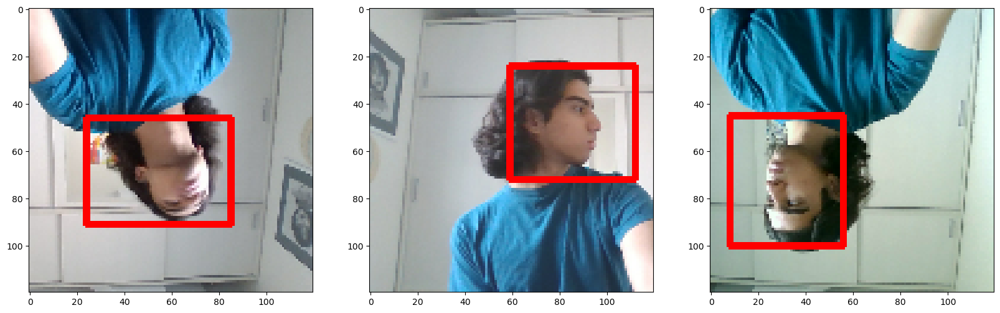

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999011 ],
       [0.9999998 ],
       [0.99999785],
       [0.9999642 ],
       [0.9999991 ],
       [1.        ],
       [0.99999994],
       [0.99999523]], dtype=float32), array([[0.25779176, 0.2824513 , 0.7872687 , 0.54812247],
       [0.21444477, 0.13296488, 0.73264253, 0.60350215],
       [0.5239056 , 0.1540786 , 0.9295876 , 0.6095653 ],
       [0.3207267 , 0.3954325 , 0.8835087 , 0.67481613],
       [0.60224116, 0.3812451 , 0.97604   , 0.8662065 ],
       [0.12960613, 0.22821158, 0.6449064 , 0.5159367 ],
       [0.01568998, 0.41714153, 0.35600504, 0.85496086],
       [0.47099978, 0.20702016, 0.896835  , 0.5900439 ]], dtype=float32)]


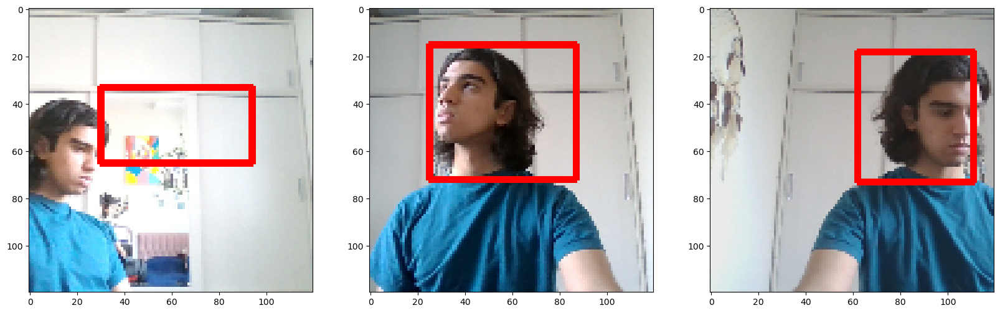

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99998903],
       [0.9999989 ],
       [0.9999995 ],
       [0.99992806],
       [0.99945194],
       [0.9999976 ],
       [0.9999996 ],
       [0.9999998 ]], dtype=float32), array([[0.31930682, 0.35153487, 0.8595871 , 0.7689148 ],
       [0.14902028, 0.19322869, 0.54105103, 0.49562657],
       [0.1165354 , 0.20605262, 0.5756177 , 0.49118125],
       [0.34872   , 0.37799644, 0.87806207, 0.71372676],
       [0.43062416, 0.33964172, 0.9288595 , 0.6116978 ],
       [0.27154046, 0.17824896, 0.7405282 , 0.5755508 ],
       [0.12808101, 0.46566683, 0.68118894, 0.7724446 ],
       [0.2735774 , 0.12599508, 0.76947206, 0.6080806 ]], dtype=float32)]


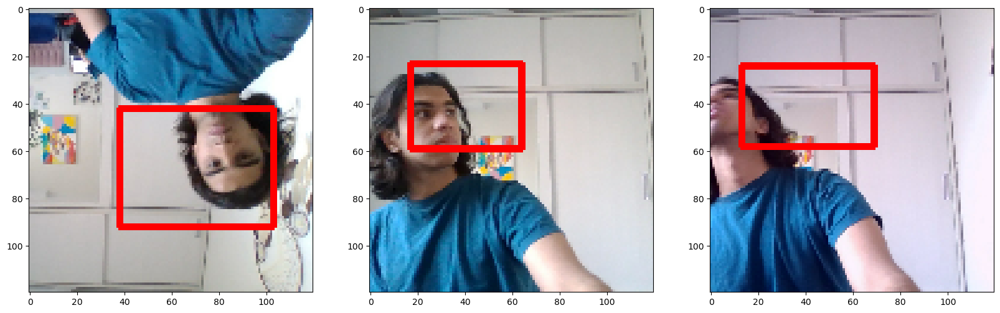

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9997289 ],
       [0.9993173 ],
       [0.99999934],
       [0.9983215 ],
       [0.99999905],
       [0.9999995 ],
       [0.99996513],
       [0.99999994]], dtype=float32), array([[0.46971464, 0.385628  , 0.9183104 , 0.66920984],
       [0.4227716 , 0.35237396, 0.9143126 , 0.71022475],
       [0.09525588, 0.20405272, 0.5413665 , 0.51560694],
       [0.43861443, 0.41718352, 0.87150514, 0.5785864 ],
       [0.13523434, 0.26411575, 0.61254895, 0.48931894],
       [0.13266768, 0.22505319, 0.6077144 , 0.5022172 ],
       [0.32864285, 0.3895671 , 0.8516898 , 0.71053565],
       [0.15423459, 0.24108851, 0.6909586 , 0.5483913 ]], dtype=float32)]


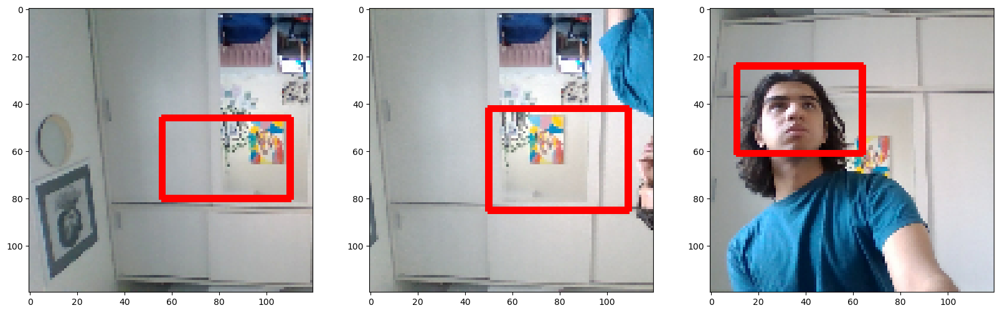

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999988 ],
       [0.99997777],
       [0.9999687 ],
       [0.9999985 ],
       [0.99997956],
       [0.9999987 ],
       [0.9999794 ],
       [0.9999989 ]], dtype=float32), array([[0.5041207 , 0.16176087, 0.91080225, 0.6213466 ],
       [0.45561993, 0.40725332, 0.92215717, 0.8064736 ],
       [0.2747418 , 0.29296044, 0.7652387 , 0.5944083 ],
       [0.61119324, 0.39351255, 0.9758403 , 0.8612067 ],
       [0.20949921, 0.44136524, 0.66837835, 0.767859  ],
       [0.14381525, 0.45361128, 0.5140039 , 0.8590374 ],
       [0.36738646, 0.33751348, 0.89384174, 0.76489496],
       [0.11725566, 0.23781912, 0.5509413 , 0.53041214]], dtype=float32)]


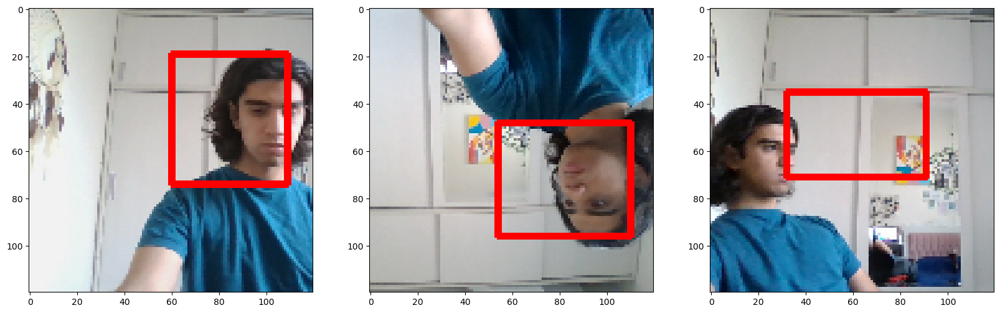

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999994],
       [0.9999977 ],
       [0.99999845],
       [0.9997617 ],
       [0.9999987 ],
       [0.99999994],
       [0.9999087 ],
       [0.99999595]], dtype=float32), array([[0.017427  , 0.42774794, 0.38176885, 0.85184926],
       [0.1453328 , 0.19286378, 0.65943736, 0.55745816],
       [0.13494383, 0.37430465, 0.62854433, 0.821833  ],
       [0.45971382, 0.35371888, 0.9336488 , 0.73792547],
       [0.43174833, 0.11972073, 0.9106954 , 0.5964843 ],
       [0.1627272 , 0.19892284, 0.66423833, 0.49877393],
       [0.3357963 , 0.36216277, 0.8678559 , 0.6879606 ],
       [0.21403778, 0.38266644, 0.69168496, 0.7841955 ]], dtype=float32)]


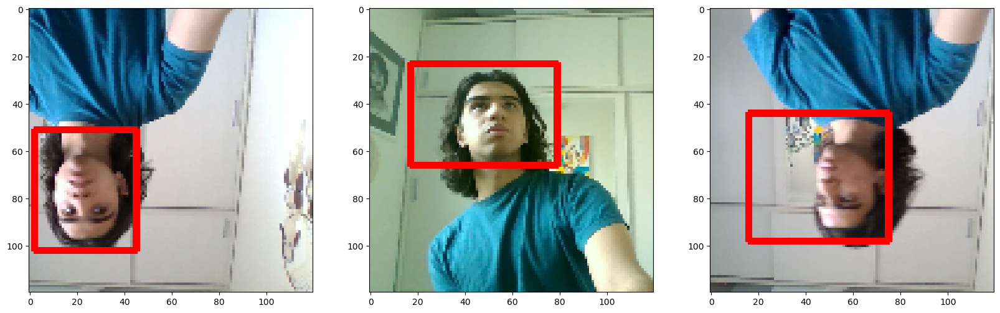

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999887],
       [0.9999999 ],
       [0.9998532 ],
       [0.9999997 ],
       [0.9999987 ],
       [0.9999698 ],
       [0.9999939 ],
       [0.9999994 ]], dtype=float32), array([[0.409313  , 0.33009648, 0.8658569 , 0.8387382 ],
       [0.20351958, 0.0958983 , 0.674986  , 0.58792806],
       [0.421183  , 0.4234978 , 0.8878419 , 0.7413543 ],
       [0.14853297, 0.15616883, 0.673652  , 0.5431169 ],
       [0.13913801, 0.27418083, 0.6234474 , 0.5064778 ],
       [0.34570143, 0.349896  , 0.89585155, 0.70652163],
       [0.48320445, 0.24967536, 0.93694   , 0.6546462 ],
       [0.52551126, 0.3735628 , 0.9588685 , 0.85871434]], dtype=float32)]


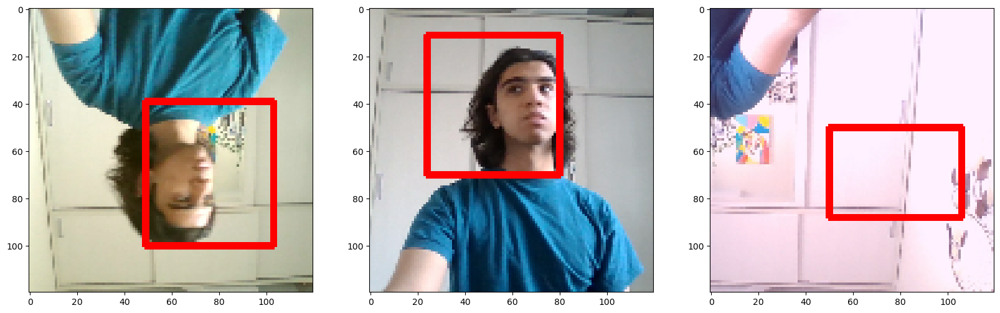

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999785],
       [0.99999756],
       [0.99999696],
       [0.99996763],
       [0.99998224],
       [0.99999994],
       [0.99999934],
       [0.9999994 ]], dtype=float32), array([[0.19850658, 0.17280948, 0.67773676, 0.568397  ],
       [0.14035563, 0.33668718, 0.6763598 , 0.8429469 ],
       [0.6637801 , 0.4373231 , 0.9860527 , 0.8606063 ],
       [0.47042468, 0.4125357 , 0.9304422 , 0.7950671 ],
       [0.5559546 , 0.23011589, 0.9633031 , 0.61689734],
       [0.02476808, 0.41830385, 0.4460569 , 0.84323406],
       [0.22258867, 0.12179004, 0.7179491 , 0.5139009 ],
       [0.12357479, 0.18151914, 0.591283  , 0.49943796]], dtype=float32)]


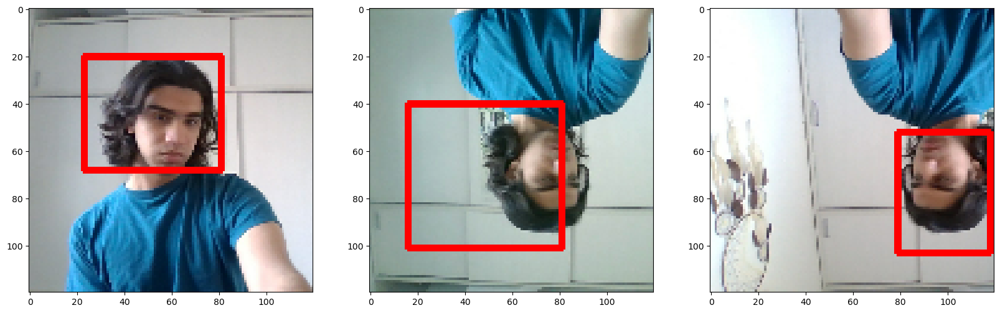

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999984 ],
       [0.9999976 ],
       [0.9999998 ],
       [0.99989235],
       [0.99999696],
       [0.99999964],
       [0.9999984 ],
       [0.9999879 ]], dtype=float32), array([[0.1692375 , 0.17666714, 0.5443281 , 0.5533779 ],
       [0.15570435, 0.20133938, 0.56179297, 0.5695398 ],
       [0.12092263, 0.23867112, 0.5989343 , 0.49733204],
       [0.5150012 , 0.2886504 , 0.95386255, 0.5634464 ],
       [0.2786149 , 0.3990154 , 0.7626461 , 0.822124  ],
       [0.04309408, 0.43166202, 0.52968836, 0.8384176 ],
       [0.10139804, 0.3930001 , 0.5368764 , 0.808553  ],
       [0.33469573, 0.37205955, 0.900204  , 0.7597802 ]], dtype=float32)]


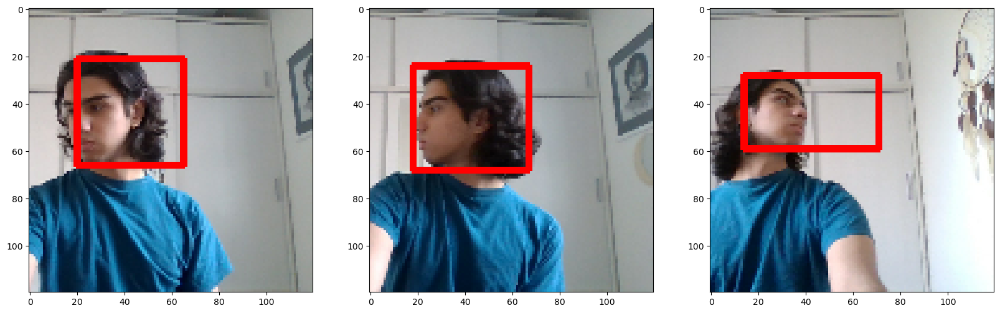

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999979 ],
       [0.9999516 ],
       [0.9993054 ],
       [0.9999837 ],
       [0.9999991 ],
       [0.99999696],
       [0.9990144 ],
       [0.99999815]], dtype=float32), array([[0.62887096, 0.44508138, 0.9823025 , 0.8582918 ],
       [0.25026026, 0.31854367, 0.6853739 , 0.5618094 ],
       [0.4395319 , 0.35962915, 0.91108817, 0.71266526],
       [0.24768515, 0.44432154, 0.8298541 , 0.7437242 ],
       [0.06484148, 0.4177786 , 0.56478083, 0.779362  ],
       [0.504875  , 0.16106993, 0.96895224, 0.60285056],
       [0.41575125, 0.39392263, 0.8708854 , 0.61040103],
       [0.10597467, 0.3838454 , 0.54852915, 0.8367511 ]], dtype=float32)]


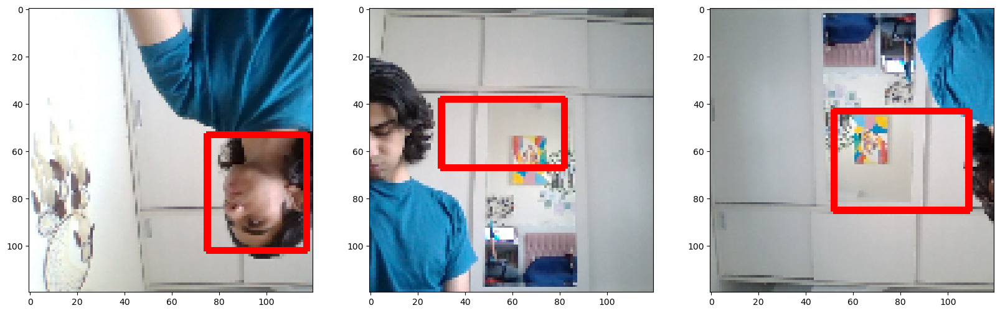

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.999989  ],
       [0.9999986 ],
       [0.99999934],
       [0.9999902 ],
       [0.99999714],
       [0.9999928 ],
       [0.9999865 ],
       [0.99999934]], dtype=float32), array([[0.22836189, 0.41431412, 0.69617844, 0.7105162 ],
       [0.6495545 , 0.42023885, 0.98401815, 0.8548667 ],
       [0.46255222, 0.15282351, 0.89210653, 0.6310094 ],
       [0.4424568 , 0.3875705 , 0.9243455 , 0.840067  ],
       [0.31157503, 0.20362417, 0.8753989 , 0.53564084],
       [0.37608218, 0.4034396 , 0.9140859 , 0.80545557],
       [0.28400034, 0.18697228, 0.7832248 , 0.5344558 ],
       [0.07620726, 0.3804139 , 0.4740334 , 0.83867157]], dtype=float32)]


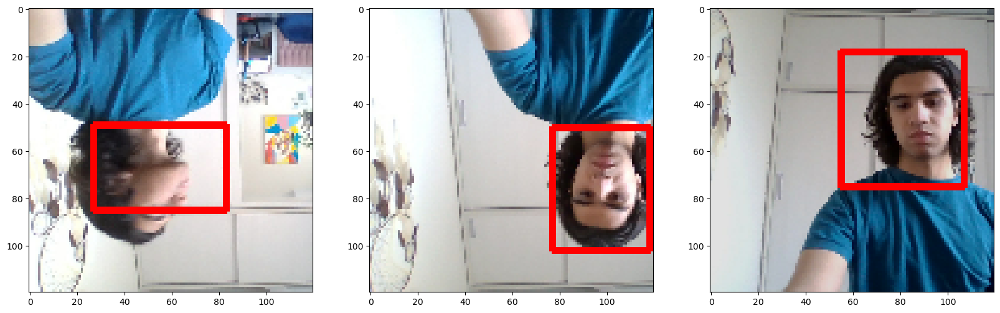

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999087 ],
       [0.9999993 ],
       [0.9990762 ],
       [0.99999803],
       [1.        ],
       [0.9999995 ],
       [0.9999991 ],
       [0.9999989 ]], dtype=float32), array([[0.40945396, 0.33669662, 0.9182437 , 0.723379  ],
       [0.27501187, 0.13306382, 0.78807074, 0.57937527],
       [0.3795552 , 0.39913854, 0.84900385, 0.6251472 ],
       [0.17104228, 0.19083805, 0.6956669 , 0.55168116],
       [0.08156068, 0.17797281, 0.51240027, 0.54224104],
       [0.14787492, 0.46273538, 0.6414535 , 0.7908162 ],
       [0.4986896 , 0.14023016, 0.9203166 , 0.61057305],
       [0.20770006, 0.37925133, 0.6731272 , 0.85667896]], dtype=float32)]


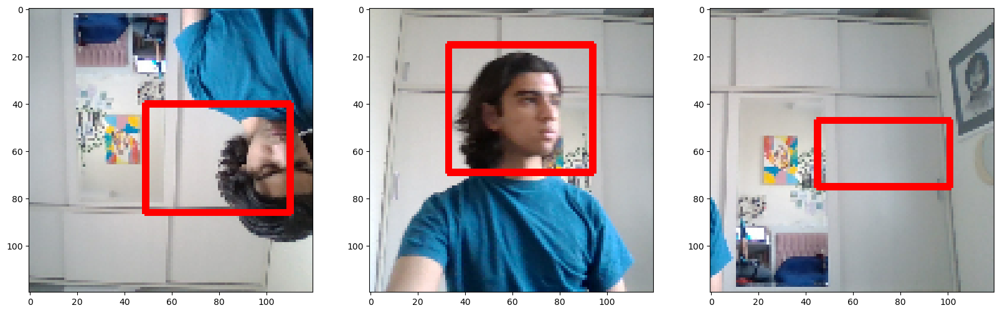

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999986 ],
       [0.9999405 ],
       [0.99998534],
       [0.9999981 ],
       [0.9999981 ],
       [0.9993058 ],
       [0.9999999 ],
       [0.9999943 ]], dtype=float32), array([[0.15148008, 0.48350492, 0.6709201 , 0.74423766],
       [0.5055233 , 0.3850566 , 0.94637805, 0.76693285],
       [0.2608701 , 0.40682754, 0.83738756, 0.7581355 ],
       [0.17865378, 0.48554212, 0.6668204 , 0.7625265 ],
       [0.39850736, 0.13900116, 0.8964621 , 0.5560318 ],
       [0.4393961 , 0.34287733, 0.92639714, 0.60521466],
       [0.15526026, 0.27005604, 0.645862  , 0.5169688 ],
       [0.2536862 , 0.43596157, 0.71817243, 0.83528507]], dtype=float32)]


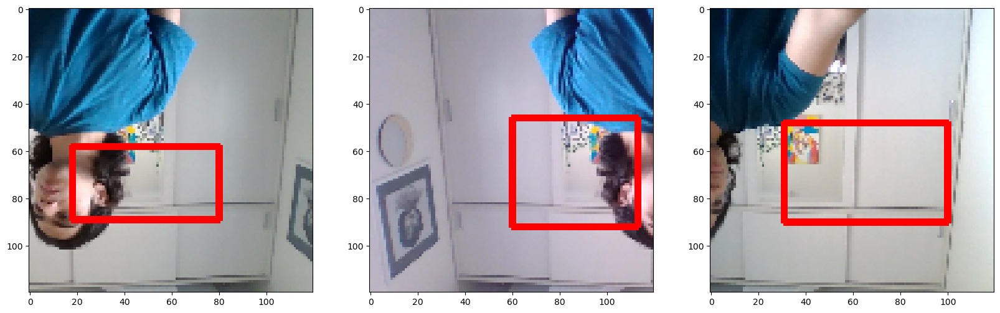

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999995 ],
       [0.9999776 ],
       [0.999998  ],
       [0.9999983 ],
       [0.9999943 ],
       [1.        ],
       [0.99995077],
       [0.99999875]], dtype=float32), array([[0.05666463, 0.3969518 , 0.42645058, 0.8431953 ],
       [0.46715805, 0.3994908 , 0.9421436 , 0.80108076],
       [0.27511063, 0.35104734, 0.71826327, 0.8204678 ],
       [0.14010383, 0.41675743, 0.59828615, 0.8264761 ],
       [0.15793586, 0.20966105, 0.63224685, 0.5303848 ],
       [0.09887274, 0.1976662 , 0.5010694 , 0.51881695],
       [0.2331675 , 0.23521705, 0.75048333, 0.55061364],
       [0.13029556, 0.43421358, 0.5808778 , 0.85706466]], dtype=float32)]


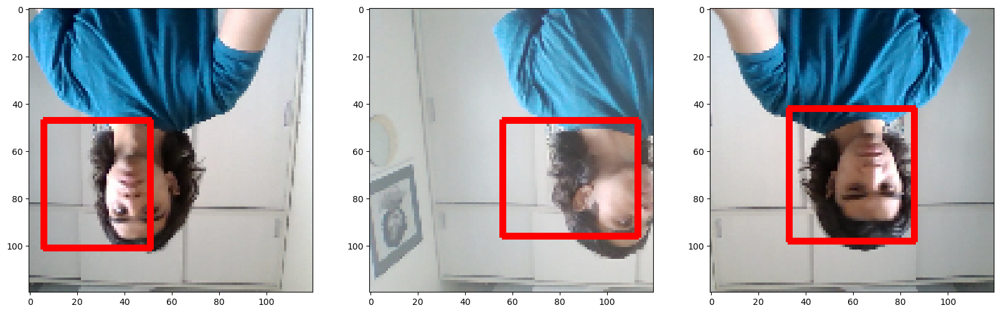

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999238 ],
       [0.9999968 ],
       [0.99999976],
       [0.9999997 ],
       [0.9999949 ],
       [0.99999803],
       [0.99994105],
       [0.9999974 ]], dtype=float32), array([[0.19884369, 0.23797126, 0.78719777, 0.51708233],
       [0.2009983 , 0.38700464, 0.7352562 , 0.83571583],
       [0.15150167, 0.27407062, 0.63388944, 0.49801534],
       [0.4166278 , 0.10988532, 0.93324804, 0.6103285 ],
       [0.6250117 , 0.40258378, 0.9772835 , 0.82698125],
       [0.19058293, 0.16913466, 0.6544732 , 0.570397  ],
       [0.33809823, 0.3486141 , 0.8644225 , 0.68857855],
       [0.12257537, 0.37504974, 0.6256099 , 0.7875069 ]], dtype=float32)]


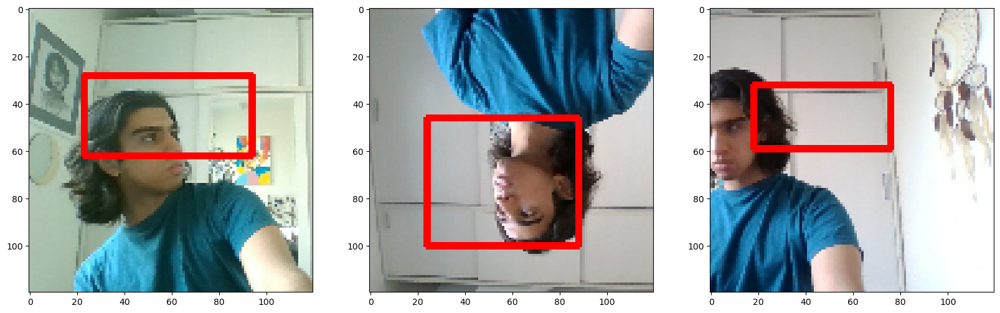

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999997 ],
       [0.9999955 ],
       [0.9999995 ],
       [0.9999989 ],
       [0.9999927 ],
       [0.99999905],
       [0.99999976],
       [0.99999994]], dtype=float32), array([[0.08777966, 0.15741944, 0.53667593, 0.53608084],
       [0.098651  , 0.4542424 , 0.5658294 , 0.7634351 ],
       [0.15663332, 0.17362237, 0.61128604, 0.6064731 ],
       [0.6351987 , 0.41642585, 0.9850608 , 0.8546499 ],
       [0.22574267, 0.4194029 , 0.77208436, 0.68281865],
       [0.18376994, 0.44904295, 0.63993865, 0.86794823],
       [0.40191984, 0.09919526, 0.91598743, 0.6018187 ],
       [0.0922938 , 0.15236247, 0.51677406, 0.5756484 ]], dtype=float32)]


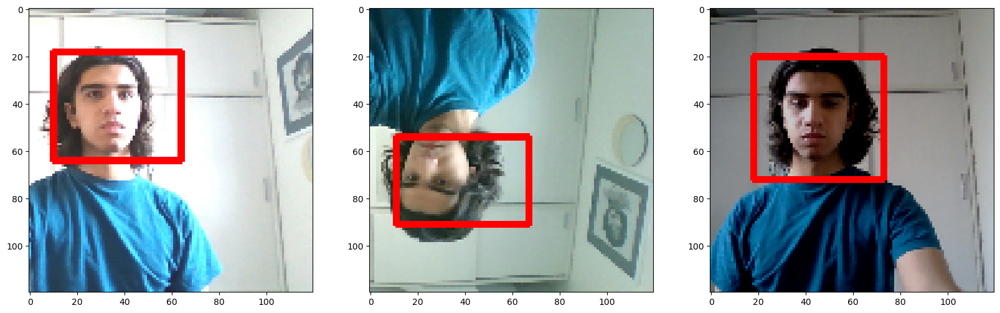

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999531 ],
       [0.9999965 ],
       [0.9998907 ],
       [0.99998343],
       [0.99998426],
       [0.9999992 ],
       [0.999999  ],
       [0.9999991 ]], dtype=float32), array([[0.35249498, 0.38243034, 0.8897625 , 0.6981193 ],
       [0.2606924 , 0.1542856 , 0.6932062 , 0.5655651 ],
       [0.29125333, 0.33798754, 0.8566851 , 0.71265006],
       [0.54278755, 0.37955365, 0.9567714 , 0.83914834],
       [0.15919591, 0.3512338 , 0.7523481 , 0.74376476],
       [0.25153723, 0.11827682, 0.7580332 , 0.57183325],
       [0.08891862, 0.380212  , 0.51333475, 0.8282119 ],
       [0.13827664, 0.44686994, 0.6031828 , 0.8641752 ]], dtype=float32)]


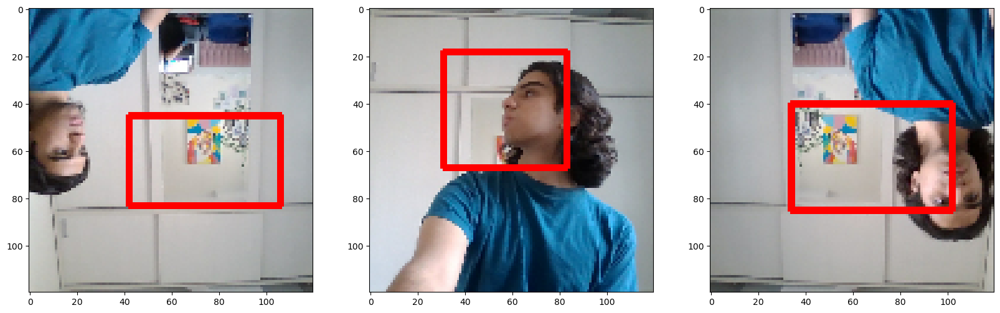

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999875],
       [0.9998894 ],
       [0.9999806 ],
       [0.9999999 ],
       [0.9999979 ],
       [0.9999983 ],
       [0.9985775 ],
       [0.9999995 ]], dtype=float32), array([[0.11180146, 0.3606116 , 0.6034188 , 0.8239336 ],
       [0.33036426, 0.30487788, 0.7445678 , 0.5945858 ],
       [0.47104627, 0.4121431 , 0.94188964, 0.8149107 ],
       [0.18233137, 0.24195428, 0.73776233, 0.54720753],
       [0.31589007, 0.3642226 , 0.772677  , 0.81927305],
       [0.13305204, 0.3992712 , 0.6199348 , 0.78366864],
       [0.44278014, 0.42114806, 0.8707367 , 0.5657121 ],
       [0.25580317, 0.14996031, 0.71601003, 0.5826018 ]], dtype=float32)]


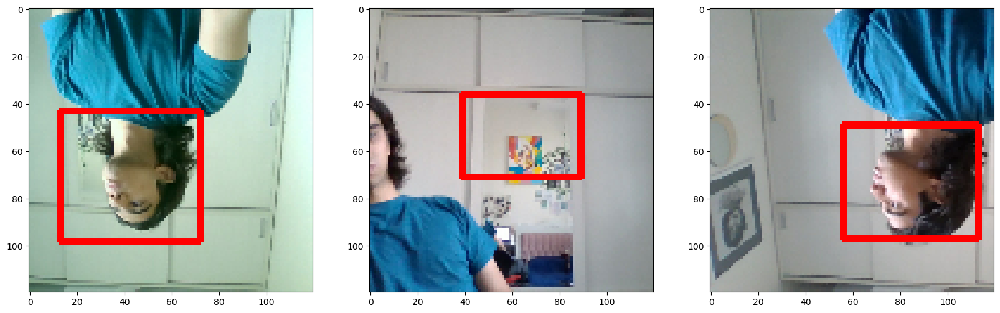

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999744],
       [0.99999994],
       [0.99999994],
       [0.9999992 ],
       [0.9999984 ],
       [0.99999964],
       [0.99999475],
       [0.9990427 ]], dtype=float32), array([[0.13887502, 0.22478473, 0.5206955 , 0.5331129 ],
       [0.01501241, 0.41998398, 0.37125474, 0.85350436],
       [0.04367788, 0.4536631 , 0.61021125, 0.7958502 ],
       [0.07672963, 0.43328166, 0.624897  , 0.7547404 ],
       [0.2676245 , 0.11952475, 0.69918954, 0.6228883 ],
       [0.2831518 , 0.11903253, 0.78944176, 0.5748483 ],
       [0.40675998, 0.3805818 , 0.8522872 , 0.81527406],
       [0.43031535, 0.40582478, 0.8797625 , 0.5565039 ]], dtype=float32)]


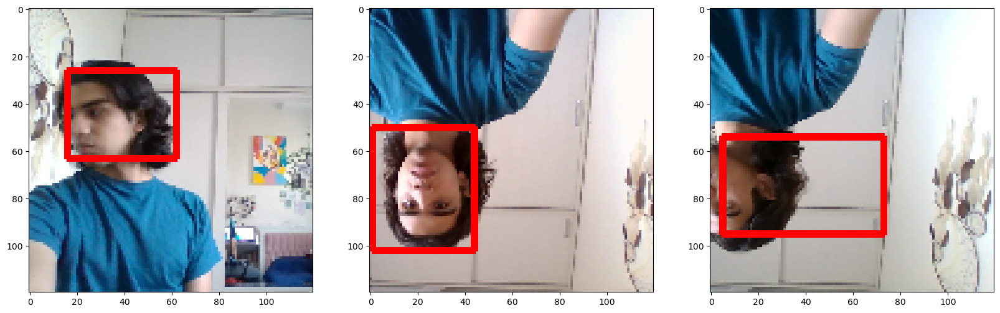

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999946],
       [0.99999976],
       [0.9999997 ],
       [0.9999992 ],
       [0.9999854 ],
       [0.999989  ],
       [0.9999952 ],
       [0.9999995 ]], dtype=float32), array([[0.12716065, 0.26143727, 0.6124264 , 0.4780054 ],
       [0.4122427 , 0.13564736, 0.88099277, 0.6223606 ],
       [0.14390142, 0.447483  , 0.66735935, 0.78980935],
       [0.06291386, 0.40472597, 0.5594963 , 0.78604734],
       [0.29834694, 0.21141852, 0.73175365, 0.56702   ],
       [0.37494478, 0.40859845, 0.90428257, 0.8137082 ],
       [0.16264923, 0.21342774, 0.63376874, 0.54668075],
       [0.32088372, 0.11787508, 0.79209036, 0.5791831 ]], dtype=float32)]


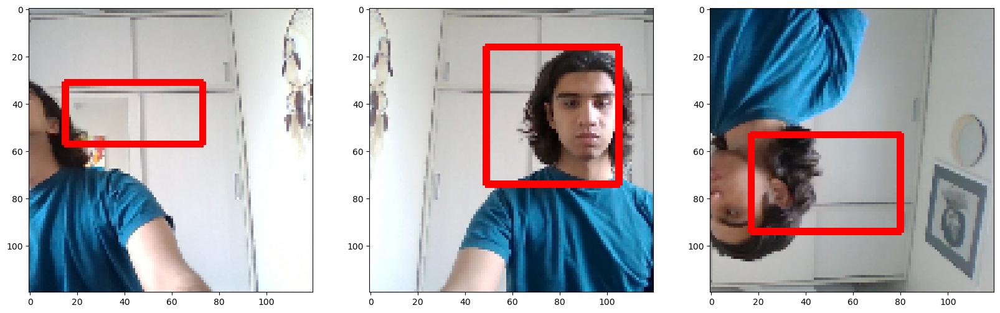

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999416],
       [0.99999845],
       [0.99999297],
       [0.9999999 ],
       [0.9999996 ],
       [0.9999973 ],
       [0.9999979 ],
       [0.99992365]], dtype=float32), array([[0.20183685, 0.3973035 , 0.76353025, 0.8202393 ],
       [0.6133698 , 0.4219822 , 0.9834238 , 0.84400636],
       [0.17640987, 0.36762455, 0.707931  , 0.797514  ],
       [0.3591381 , 0.12721854, 0.7760706 , 0.5862714 ],
       [0.12683858, 0.20343749, 0.658466  , 0.49465552],
       [0.22503191, 0.1412678 , 0.7489705 , 0.5873306 ],
       [0.267246  , 0.3546516 , 0.7147939 , 0.8230538 ],
       [0.34076738, 0.34284222, 0.8462824 , 0.69780076]], dtype=float32)]


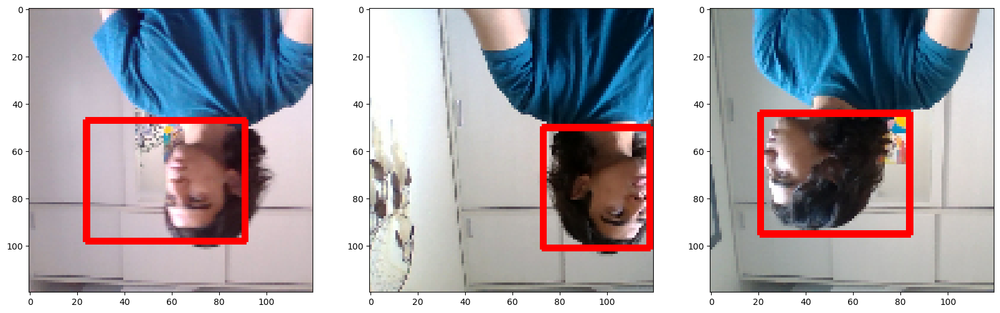

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999934],
       [0.99999857],
       [0.9999772 ],
       [0.99999934],
       [0.99999595],
       [0.99999917],
       [0.99999964],
       [0.99999994]], dtype=float32), array([[0.3561915 , 0.14099331, 0.8312028 , 0.61175835],
       [0.11859873, 0.46599093, 0.61057127, 0.84824854],
       [0.1847551 , 0.23644313, 0.66756535, 0.5623249 ],
       [0.19347602, 0.11229807, 0.6132127 , 0.594077  ],
       [0.59879863, 0.16034335, 0.9739886 , 0.5691971 ],
       [0.48473254, 0.35528013, 0.92729473, 0.86084867],
       [0.11687923, 0.10168295, 0.5053475 , 0.53706515],
       [0.17243282, 0.11903902, 0.63899076, 0.5886229 ]], dtype=float32)]


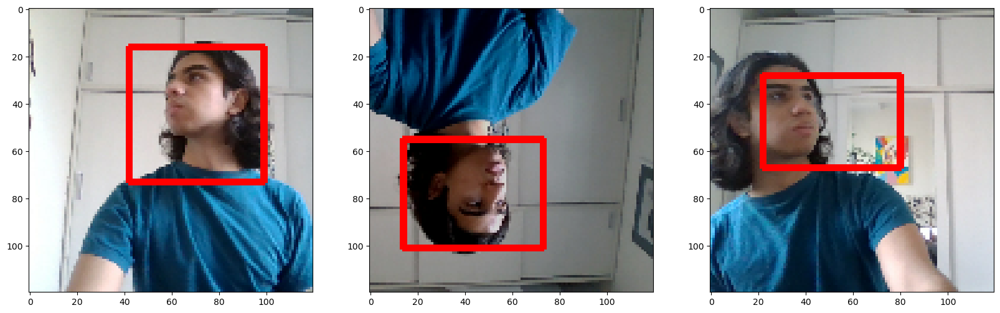

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999959 ],
       [0.9999997 ],
       [0.99999964],
       [0.9999935 ],
       [0.99999994],
       [0.99999917],
       [0.99999505],
       [0.9999998 ]], dtype=float32), array([[0.24077305, 0.15917528, 0.6636615 , 0.549265  ],
       [0.13576941, 0.09944198, 0.55130005, 0.537547  ],
       [0.24428926, 0.13778879, 0.7811191 , 0.58601797],
       [0.34412304, 0.3996237 , 0.89104307, 0.8256527 ],
       [0.16932522, 0.23697443, 0.7215368 , 0.54834723],
       [0.10424237, 0.18971904, 0.540447  , 0.579664  ],
       [0.22776806, 0.15150286, 0.6262361 , 0.573454  ],
       [0.02623129, 0.43149254, 0.41987765, 0.84705347]], dtype=float32)]


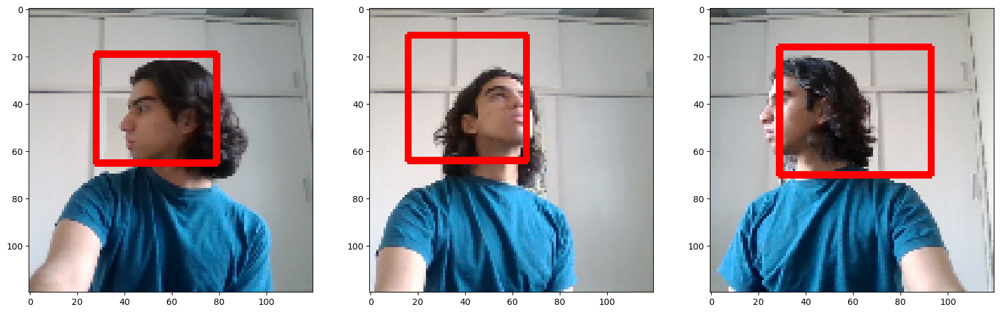

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99998087],
       [0.99967635],
       [0.9999991 ],
       [0.99979603],
       [0.9999994 ],
       [0.99999803],
       [0.99999785],
       [0.99992037]], dtype=float32), array([[0.2136731 , 0.15576611, 0.75448346, 0.6155347 ],
       [0.43038464, 0.38623157, 0.8766721 , 0.5436281 ],
       [0.5200982 , 0.39997724, 0.97360915, 0.86983943],
       [0.35634694, 0.3001562 , 0.8388206 , 0.5291339 ],
       [0.09392825, 0.38552982, 0.55223644, 0.8414313 ],
       [0.07595506, 0.38720158, 0.53537476, 0.7978299 ],
       [0.21901217, 0.1549242 , 0.62762576, 0.56450105],
       [0.19718596, 0.23714964, 0.7545978 , 0.5209958 ]], dtype=float32)]


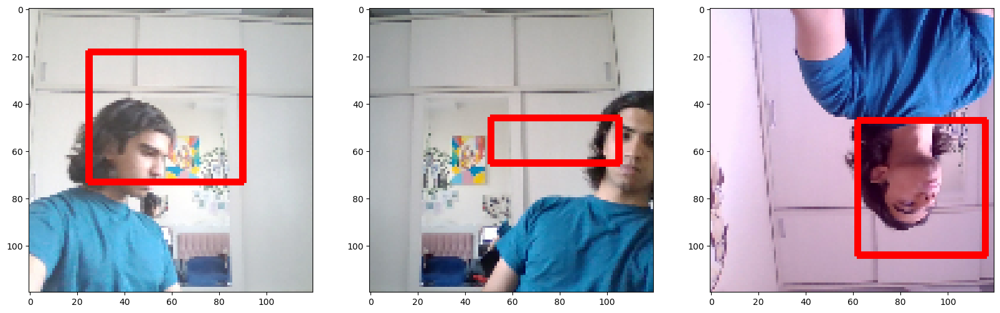

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999963 ],
       [0.9999726 ],
       [0.9999998 ],
       [0.99999976],
       [0.9986592 ],
       [0.9999996 ],
       [0.9999986 ],
       [0.9999998 ]], dtype=float32), array([[0.14175372, 0.37089306, 0.6699932 , 0.7993682 ],
       [0.4262331 , 0.38230178, 0.92320657, 0.7947502 ],
       [0.03806622, 0.4251104 , 0.4574361 , 0.8433822 ],
       [0.03183953, 0.44005412, 0.39362168, 0.8410388 ],
       [0.4252013 , 0.3720566 , 0.8794782 , 0.59580517],
       [0.06575821, 0.38377726, 0.45859358, 0.83369786],
       [0.22092792, 0.1495705 , 0.66017693, 0.5976812 ],
       [0.21357797, 0.11677478, 0.7077372 , 0.5814272 ]], dtype=float32)]


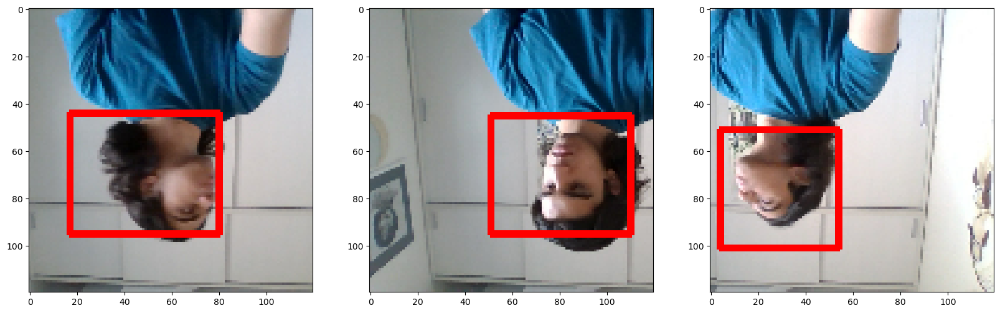

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999595],
       [0.9999994 ],
       [0.9999998 ],
       [0.999999  ],
       [0.9999999 ],
       [0.9997917 ],
       [0.9999996 ],
       [0.9999517 ]], dtype=float32), array([[0.14837743, 0.24143964, 0.6228706 , 0.54776424],
       [0.435772  , 0.38697025, 0.91941816, 0.863327  ],
       [0.12187358, 0.15998295, 0.5423123 , 0.6008737 ],
       [0.09522825, 0.4497702 , 0.6745242 , 0.7598654 ],
       [0.13542382, 0.17293647, 0.6132222 , 0.5605889 ],
       [0.47624376, 0.38465074, 0.9269567 , 0.67149186],
       [0.08500135, 0.40076137, 0.5471154 , 0.8439263 ],
       [0.50381464, 0.38724715, 0.9446864 , 0.77431273]], dtype=float32)]


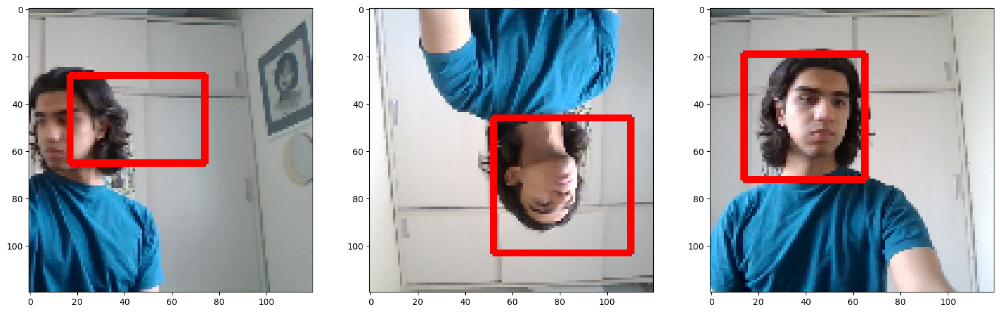

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999984 ],
       [0.9999907 ],
       [0.9996257 ],
       [0.99995327],
       [0.99999964],
       [0.99999917],
       [0.99949485],
       [0.99859   ]], dtype=float32), array([[0.27062708, 0.36653334, 0.75862175, 0.86005473],
       [0.47408357, 0.34643582, 0.9056568 , 0.80485713],
       [0.35286802, 0.38556525, 0.8605535 , 0.6880551 ],
       [0.33811435, 0.36952025, 0.84410036, 0.7254816 ],
       [0.30344412, 0.11348543, 0.81662047, 0.5738621 ],
       [0.06792194, 0.42021522, 0.59995663, 0.7587254 ],
       [0.48899078, 0.3883382 , 0.928755  , 0.6987903 ],
       [0.45485342, 0.42561284, 0.8900415 , 0.6317066 ]], dtype=float32)]


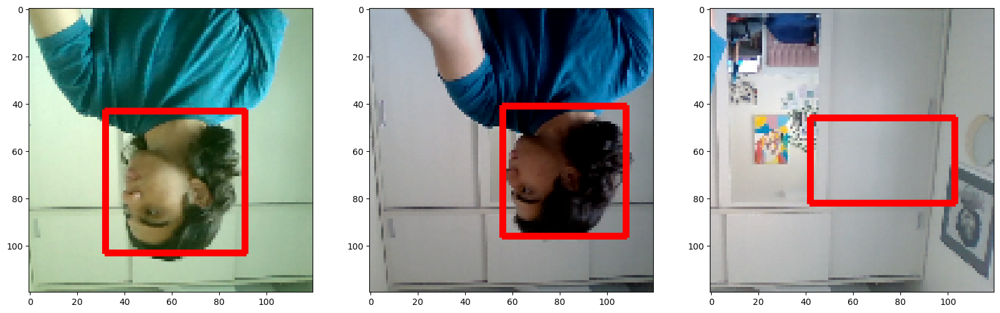

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999981 ],
       [0.9999975 ],
       [0.99999756],
       [0.999987  ],
       [1.        ],
       [0.9999923 ],
       [0.9999994 ],
       [0.99999666]], dtype=float32), array([[0.09460323, 0.39226133, 0.58207434, 0.8085667 ],
       [0.13869368, 0.48568076, 0.58939385, 0.7885323 ],
       [0.19983709, 0.17110474, 0.673115  , 0.56781065],
       [0.638157  , 0.4246466 , 0.97844625, 0.84447634],
       [0.09718905, 0.22687659, 0.5754995 , 0.4903844 ],
       [0.49404746, 0.1697904 , 0.9551082 , 0.5876219 ],
       [0.29511058, 0.14748994, 0.75656325, 0.55725527],
       [0.66471434, 0.4415259 , 0.984885  , 0.8698293 ]], dtype=float32)]


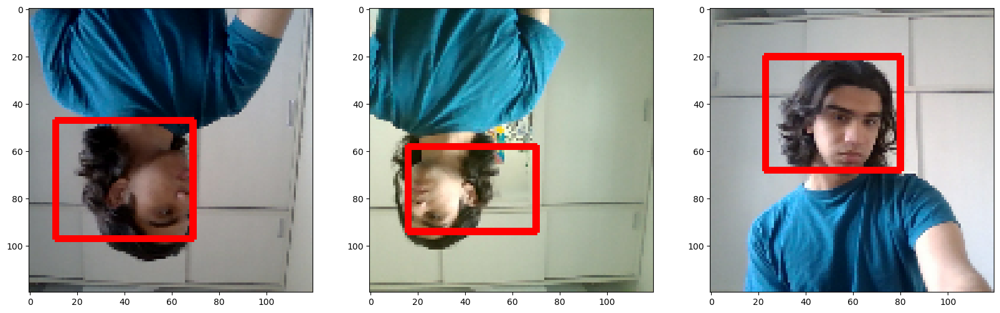

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999213],
       [0.999735  ],
       [0.99999785],
       [0.99996126],
       [0.99997765],
       [0.99998885],
       [0.9999967 ],
       [0.9999978 ]], dtype=float32), array([[0.4858658 , 0.2692171 , 0.9100002 , 0.6123427 ],
       [0.35940334, 0.3264251 , 0.8937379 , 0.72301805],
       [0.14669901, 0.3499438 , 0.6841383 , 0.7804763 ],
       [0.5262332 , 0.31475648, 0.9283422 , 0.6449219 ],
       [0.21306488, 0.2947064 , 0.7170788 , 0.54337907],
       [0.3570839 , 0.2348239 , 0.84425694, 0.51198435],
       [0.30298945, 0.13587847, 0.7059844 , 0.6150463 ],
       [0.64130795, 0.42912835, 0.9833696 , 0.86297053]], dtype=float32)]


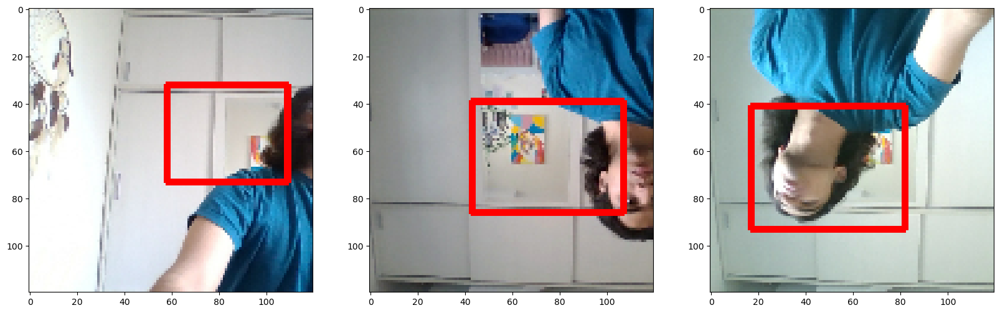

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99906635],
       [0.9999994 ],
       [0.9999981 ],
       [0.9999991 ],
       [0.9997787 ],
       [0.99999106],
       [0.999994  ],
       [0.99999833]], dtype=float32), array([[0.45672104, 0.35042667, 0.9238126 , 0.6013577 ],
       [0.16744657, 0.12359703, 0.5523714 , 0.5929612 ],
       [0.48086953, 0.22648224, 0.9152316 , 0.617877  ],
       [0.57558465, 0.4162634 , 0.97911525, 0.8711437 ],
       [0.46215904, 0.4026174 , 0.9223511 , 0.6747484 ],
       [0.56127775, 0.20458744, 0.97222745, 0.614812  ],
       [0.16981329, 0.27529192, 0.686612  , 0.5369977 ],
       [0.16775274, 0.4605608 , 0.6268603 , 0.82964665]], dtype=float32)]


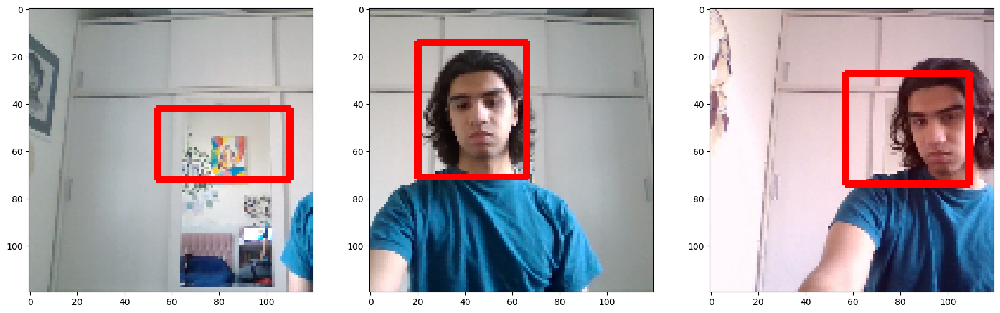

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999464],
       [1.        ],
       [1.        ],
       [0.99999934],
       [0.9999989 ],
       [0.99999875],
       [0.9999603 ],
       [0.99999934]], dtype=float32), array([[0.27777308, 0.42532146, 0.8086959 , 0.7723305 ],
       [0.01286972, 0.4305573 , 0.39308792, 0.8583897 ],
       [0.02448428, 0.43941516, 0.5120997 , 0.8361723 ],
       [0.10988906, 0.22122574, 0.6010098 , 0.5608933 ],
       [0.17694199, 0.22180419, 0.7190685 , 0.53600466],
       [0.5412159 , 0.41646913, 0.97234726, 0.86199385],
       [0.46519095, 0.36122164, 0.94638604, 0.77367944],
       [0.07987668, 0.40886027, 0.608597  , 0.7779933 ]], dtype=float32)]


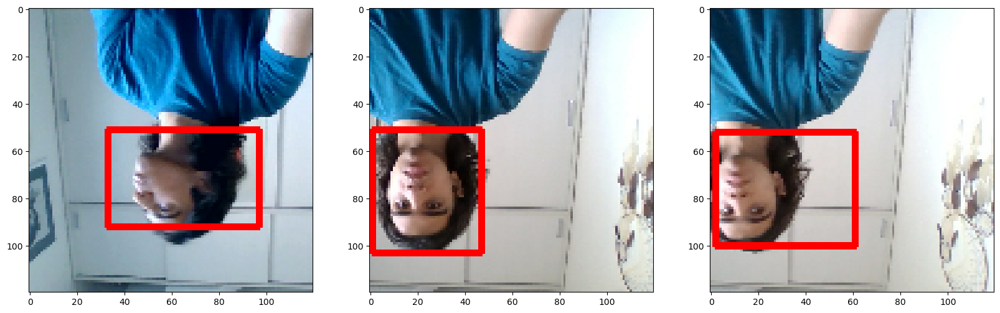

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999106],
       [0.99999994],
       [0.9999848 ],
       [0.99999505],
       [0.99999887],
       [0.99999946],
       [0.9999985 ],
       [0.99999934]], dtype=float32), array([[0.5014037 , 0.39209834, 0.9500417 , 0.8621189 ],
       [0.03168329, 0.45519486, 0.5419649 , 0.8212708 ],
       [0.31630176, 0.39307845, 0.79955745, 0.73263955],
       [0.21279092, 0.24749276, 0.7522131 , 0.5626631 ],
       [0.52140355, 0.1392876 , 0.92288655, 0.60206866],
       [0.16972141, 0.44765145, 0.7218975 , 0.75753725],
       [0.0705833 , 0.364075  , 0.4550977 , 0.7840907 ],
       [0.14493488, 0.2749693 , 0.64384675, 0.5109583 ]], dtype=float32)]


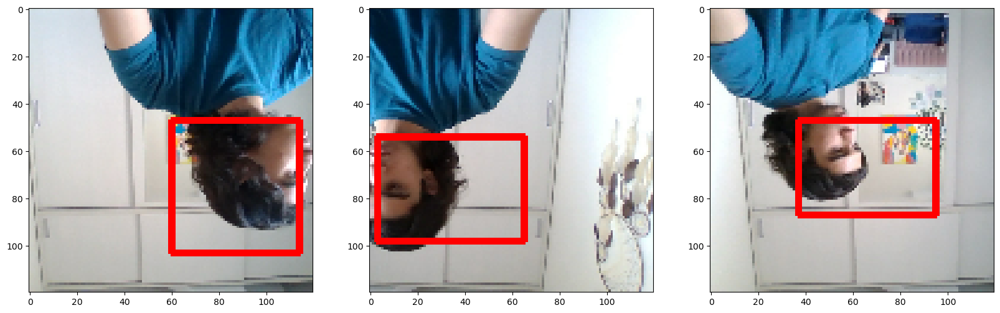

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999981 ],
       [0.99999976],
       [0.9999997 ],
       [0.9999986 ],
       [0.9993261 ],
       [1.        ],
       [0.9999996 ],
       [0.9998263 ]], dtype=float32), array([[0.18194395, 0.30214837, 0.68059266, 0.5388128 ],
       [0.17736347, 0.12891386, 0.6578692 , 0.53458416],
       [0.05167526, 0.40032837, 0.44483384, 0.85205084],
       [0.42556208, 0.2132041 , 0.88578403, 0.60044116],
       [0.49393606, 0.3755165 , 0.9312586 , 0.70007014],
       [0.08808003, 0.16869475, 0.48304683, 0.5108742 ],
       [0.1941109 , 0.12644292, 0.7488302 , 0.56060904],
       [0.2969372 , 0.34937784, 0.74041057, 0.60297656]], dtype=float32)]


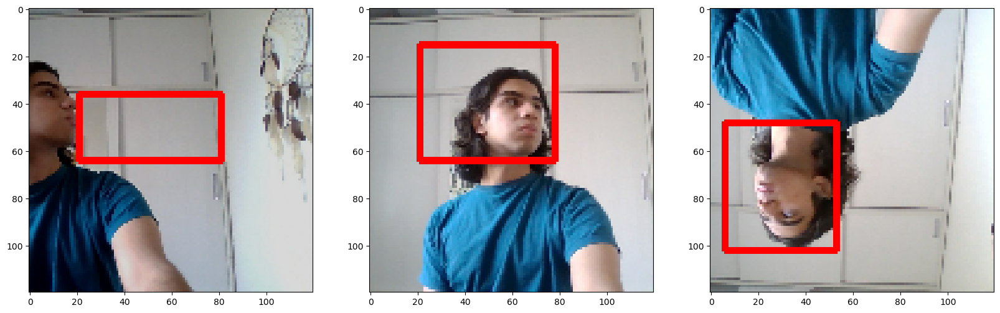

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999904 ],
       [0.99999917],
       [0.99999905],
       [0.99999917],
       [0.9999461 ],
       [0.99999195],
       [0.99999976],
       [0.9999998 ]], dtype=float32), array([[0.25323847, 0.20247549, 0.8004112 , 0.47359052],
       [0.46313095, 0.16292205, 0.9020416 , 0.6091958 ],
       [0.22187488, 0.18039155, 0.71479464, 0.52451897],
       [0.08194321, 0.4731333 , 0.519303  , 0.8382619 ],
       [0.3449355 , 0.23186177, 0.8748128 , 0.48801047],
       [0.28607118, 0.3757039 , 0.83238107, 0.78124917],
       [0.02769339, 0.43529353, 0.37170628, 0.8273647 ],
       [0.11610277, 0.23185267, 0.58717895, 0.5014857 ]], dtype=float32)]


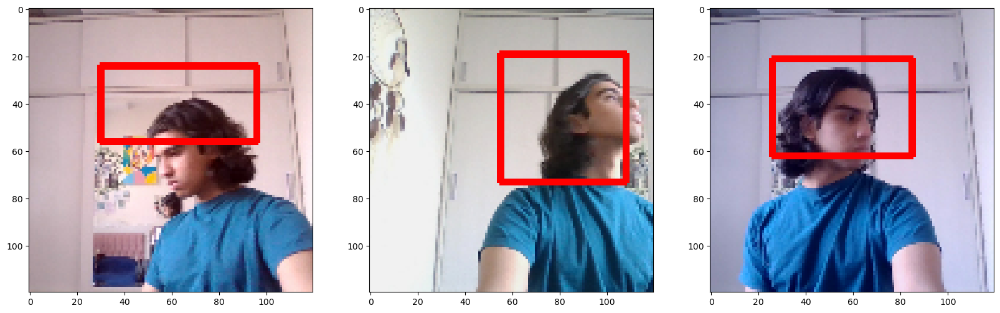

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999994 ],
       [0.99999696],
       [0.9999998 ],
       [0.9999864 ],
       [0.9999993 ],
       [0.9999987 ],
       [0.99999046],
       [0.9999996 ]], dtype=float32), array([[0.18269762, 0.11437862, 0.6333357 , 0.5888874 ],
       [0.19512987, 0.2056343 , 0.5727861 , 0.5541832 ],
       [0.03131796, 0.41259748, 0.47860175, 0.81745553],
       [0.63666975, 0.38940504, 0.9732088 , 0.8430353 ],
       [0.5225113 , 0.40509757, 0.93836063, 0.8807857 ],
       [0.20054182, 0.44531593, 0.6531962 , 0.8485887 ],
       [0.49294713, 0.20051871, 0.9677586 , 0.58736694],
       [0.1423553 , 0.14379676, 0.58111906, 0.5769268 ]], dtype=float32)]


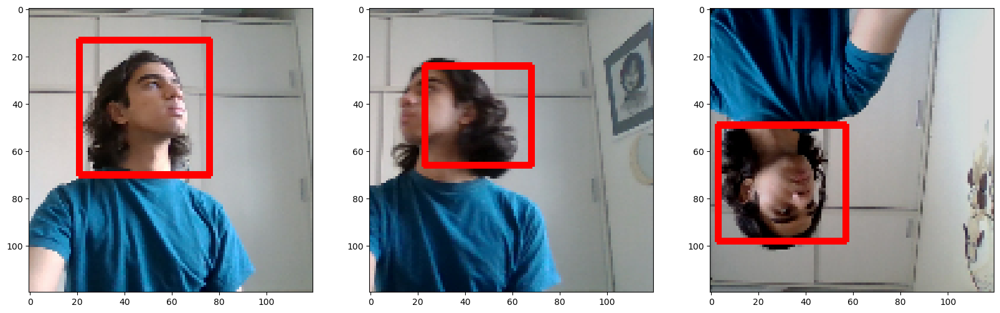

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999974 ],
       [0.99999917],
       [0.9999974 ],
       [0.9999985 ],
       [0.9999994 ],
       [0.9999988 ],
       [0.99999136],
       [0.9999853 ]], dtype=float32), array([[0.34376684, 0.15308134, 0.81266373, 0.5770884 ],
       [0.49521253, 0.18100524, 0.9157776 , 0.6474458 ],
       [0.4288391 , 0.17011015, 0.8913555 , 0.55344856],
       [0.07697771, 0.42462483, 0.50935465, 0.814605  ],
       [0.56610054, 0.38578874, 0.9701574 , 0.863899  ],
       [0.64843607, 0.4401843 , 0.98739356, 0.85999155],
       [0.5691855 , 0.40858713, 0.9577053 , 0.8390839 ],
       [0.41508755, 0.43148568, 0.927978  , 0.8153645 ]], dtype=float32)]


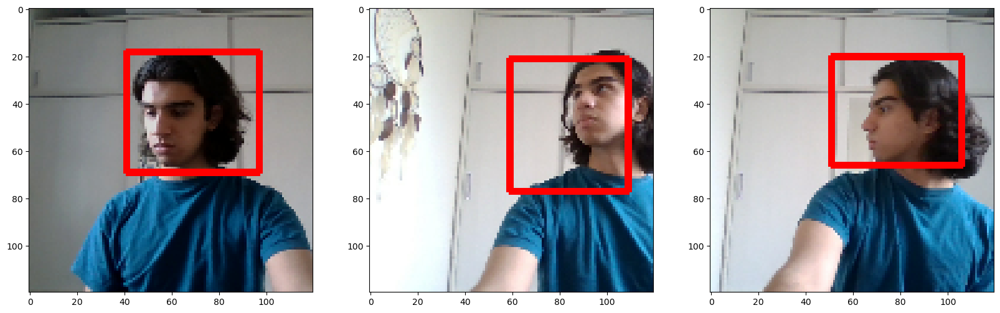

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999374],
       [0.9999997 ],
       [0.9999721 ],
       [0.99999994],
       [0.9999972 ],
       [0.99998856],
       [0.9999996 ],
       [0.999978  ]], dtype=float32), array([[0.27933544, 0.42576447, 0.8314526 , 0.7733209 ],
       [0.0366993 , 0.3772077 , 0.3801342 , 0.8421676 ],
       [0.606475  , 0.38101885, 0.97142136, 0.7954962 ],
       [0.13867554, 0.19038229, 0.6094395 , 0.55277157],
       [0.14805847, 0.42797878, 0.6766441 , 0.7432728 ],
       [0.5773318 , 0.18812816, 0.9766056 , 0.61820495],
       [0.30075103, 0.11587981, 0.7549443 , 0.5922953 ],
       [0.48221084, 0.39485312, 0.94640654, 0.80373865]], dtype=float32)]


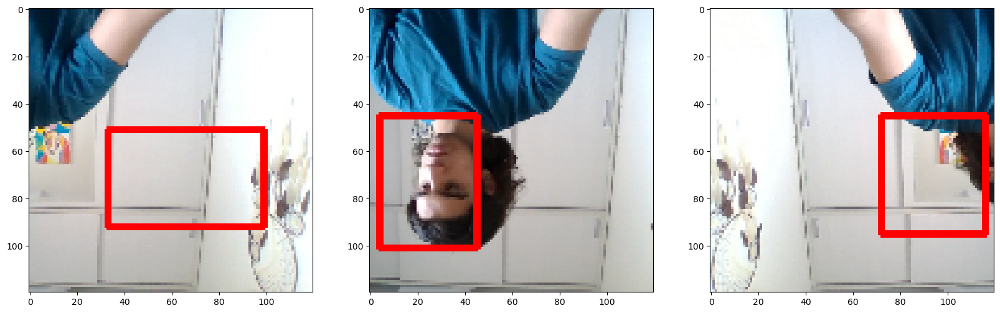

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999999 ],
       [0.9999996 ],
       [0.99999374],
       [0.99999905],
       [0.9999966 ],
       [0.99999744],
       [0.99998325],
       [0.99999875]], dtype=float32), array([[0.02122238, 0.40461192, 0.37205073, 0.85540944],
       [0.24895029, 0.12998585, 0.7610332 , 0.56200933],
       [0.15413608, 0.3645197 , 0.7057704 , 0.7023298 ],
       [0.17022148, 0.33039635, 0.66555655, 0.5150516 ],
       [0.20525086, 0.3871649 , 0.75180936, 0.8234149 ],
       [0.25244933, 0.3767616 , 0.72027546, 0.792249  ],
       [0.43885675, 0.3687657 , 0.93222994, 0.8195466 ],
       [0.36501503, 0.15444556, 0.8354516 , 0.5947163 ]], dtype=float32)]


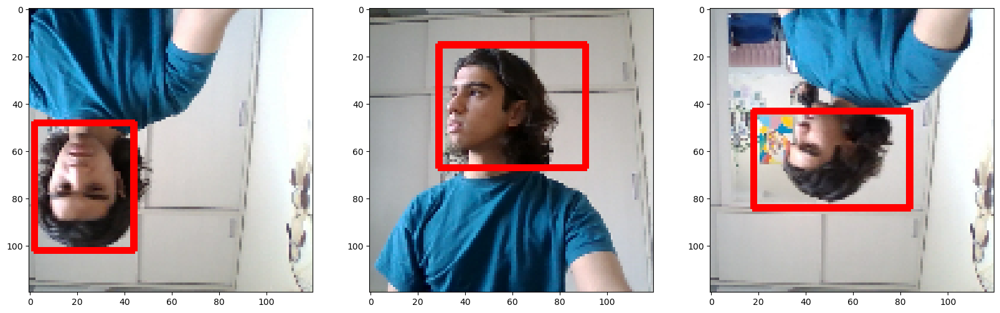

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[1.        ],
       [0.99999714],
       [0.99999815],
       [0.9999927 ],
       [0.99997735],
       [0.9999988 ],
       [0.99999994],
       [0.99998945]], dtype=float32), array([[0.10172807, 0.1703468 , 0.5674763 , 0.51922166],
       [0.15599336, 0.22956441, 0.54870534, 0.5353333 ],
       [0.47583485, 0.37945816, 0.91794026, 0.83986914],
       [0.519333  , 0.19613194, 0.9659877 , 0.58500457],
       [0.463201  , 0.40516767, 0.92528343, 0.80839074],
       [0.09728165, 0.34977433, 0.58575046, 0.83312875],
       [0.13849933, 0.2070261 , 0.6324363 , 0.5526446 ],
       [0.5718365 , 0.35934487, 0.97180414, 0.8396248 ]], dtype=float32)]


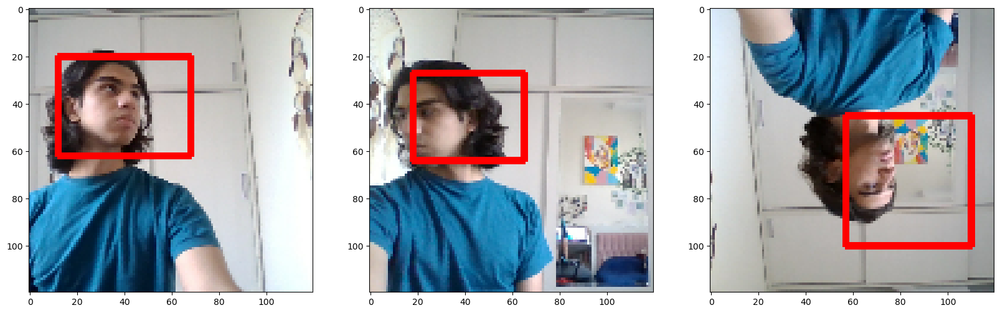

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
[array([[0.9999989 ],
       [0.9999996 ],
       [0.9999997 ],
       [0.99999964],
       [0.9999956 ],
       [0.99999875],
       [0.9999976 ],
       [0.999999  ]], dtype=float32), array([[0.43212047, 0.38400882, 0.8563496 , 0.8356248 ],
       [0.03971063, 0.41715112, 0.49003094, 0.78876674],
       [0.165122  , 0.11707252, 0.67329645, 0.54132843],
       [0.03762179, 0.42661038, 0.42103717, 0.8401852 ],
       [0.42978492, 0.31510937, 0.8754498 , 0.8154966 ],
       [0.07450904, 0.36099195, 0.5401178 , 0.77870417],
       [0.17217198, 0.45882976, 0.68266   , 0.74444616],
       [0.14570716, 0.44356233, 0.56868374, 0.851341  ]], dtype=float32)]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


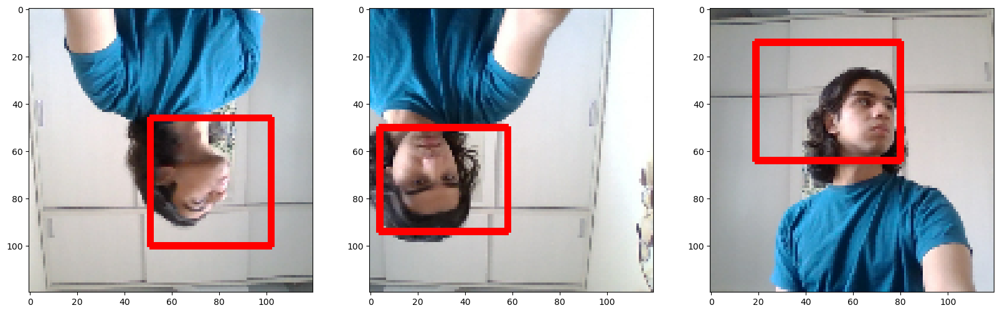

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999943 ],
       [0.9999998 ],
       [0.9998141 ],
       [0.9999987 ],
       [0.99999946],
       [0.99998724],
       [0.9999999 ],
       [0.9999969 ]], dtype=float32), array([[0.19944274, 0.3485274 , 0.78120977, 0.760244  ],
       [0.15759164, 0.103758  , 0.56604576, 0.57854927],
       [0.43416345, 0.36107373, 0.9213128 , 0.72362155],
       [0.13247949, 0.45940456, 0.60525393, 0.85555094],
       [0.43599164, 0.11476804, 0.90808696, 0.6032684 ],
       [0.42282712, 0.39243633, 0.88696676, 0.82278043],
       [0.0241502 , 0.4305416 , 0.36617213, 0.8489598 ],
       [0.17533033, 0.28018388, 0.6621021 , 0.5002941 ]], dtype=float32)]


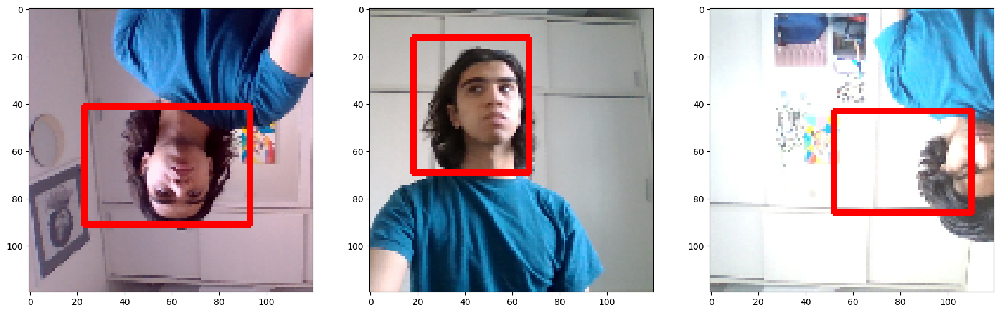

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9992245 ],
       [0.9999527 ],
       [0.99999994],
       [0.99955875],
       [0.99999875],
       [0.99998665],
       [0.9999991 ],
       [0.9999972 ]], dtype=float32), array([[0.44410127, 0.3384596 , 0.9160049 , 0.57613736],
       [0.3213629 , 0.29027164, 0.78202456, 0.5146885 ],
       [0.17093655, 0.24381514, 0.6799705 , 0.5194353 ],
       [0.49360535, 0.37261254, 0.93256   , 0.70538366],
       [0.08162719, 0.42433926, 0.6338537 , 0.7513767 ],
       [0.38987377, 0.38110065, 0.9214573 , 0.808501  ],
       [0.15083465, 0.17410846, 0.593192  , 0.5123091 ],
       [0.52138704, 0.15776101, 0.9676223 , 0.6176223 ]], dtype=float32)]


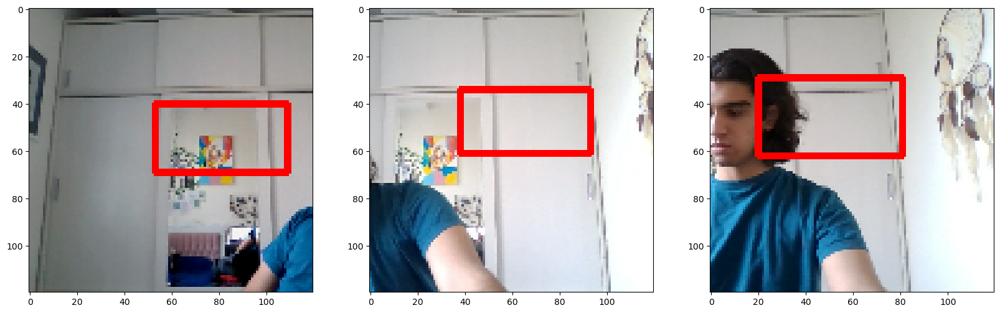

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999934],
       [0.99999994],
       [0.9999988 ],
       [0.9999964 ],
       [0.9999948 ],
       [0.99999744],
       [0.99999344],
       [0.9999993 ]], dtype=float32), array([[0.09475689, 0.38183293, 0.52550954, 0.8380317 ],
       [0.04156424, 0.43732017, 0.6094806 , 0.81170106],
       [0.4963059 , 0.35458177, 0.9267844 , 0.856364  ],
       [0.5600325 , 0.15662022, 0.96242905, 0.5920229 ],
       [0.19513777, 0.27915898, 0.7478683 , 0.5489797 ],
       [0.1095873 , 0.3690092 , 0.6382858 , 0.78417706],
       [0.4187051 , 0.21988003, 0.95253694, 0.5580995 ],
       [0.51029456, 0.36904746, 0.95139253, 0.8503883 ]], dtype=float32)]


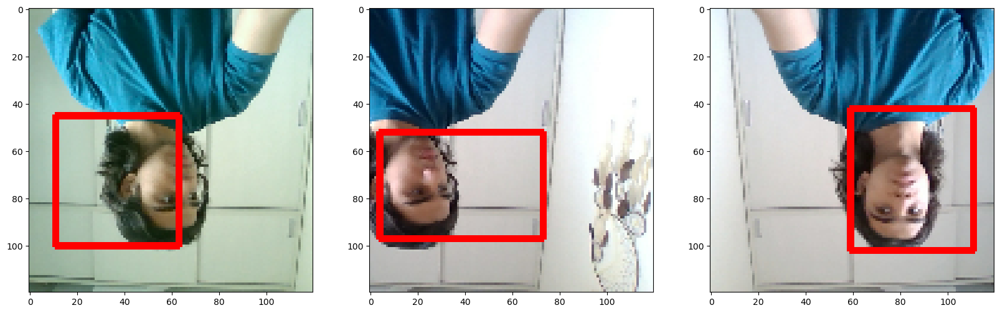

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999956 ],
       [0.9999829 ],
       [0.99999744],
       [0.9999994 ],
       [0.99999845],
       [0.9999995 ],
       [0.9999892 ],
       [0.99999595]], dtype=float32), array([[0.4787236 , 0.33771113, 0.9116524 , 0.82351166],
       [0.21852992, 0.3489599 , 0.78248584, 0.7438647 ],
       [0.2298979 , 0.47345796, 0.791898  , 0.7770968 ],
       [0.28308603, 0.15372455, 0.74712324, 0.5857903 ],
       [0.11611845, 0.36727318, 0.6077099 , 0.7778077 ],
       [0.1391163 , 0.17047653, 0.58205557, 0.5226601 ],
       [0.375427  , 0.4002685 , 0.851462  , 0.7619371 ],
       [0.31560466, 0.3800386 , 0.8789356 , 0.8213525 ]], dtype=float32)]


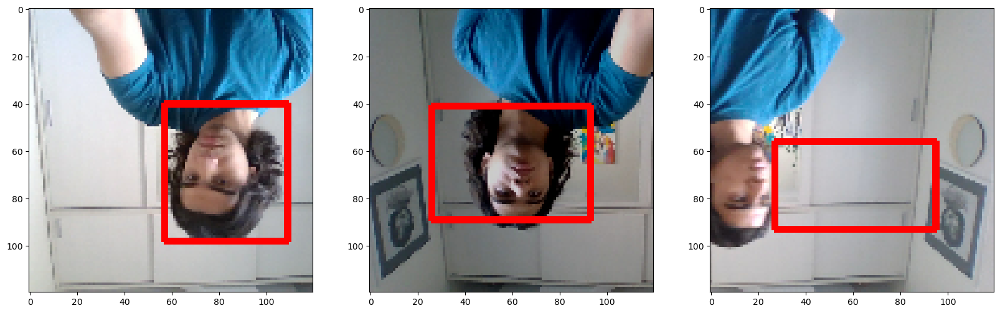

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999984 ],
       [0.9999966 ],
       [0.99999857],
       [0.99987876],
       [0.99987036],
       [0.9999956 ],
       [0.9999855 ],
       [0.9999992 ]], dtype=float32), array([[0.09271449, 0.36380666, 0.5585996 , 0.7790916 ],
       [0.21012563, 0.16511333, 0.60238415, 0.5483304 ],
       [0.22444439, 0.16674699, 0.7239834 , 0.55105424],
       [0.2708924 , 0.29184306, 0.7357987 , 0.54367113],
       [0.31457004, 0.33743194, 0.88415354, 0.67084837],
       [0.18584834, 0.37634677, 0.6911173 , 0.76477766],
       [0.50002277, 0.21943367, 0.96674335, 0.61620957],
       [0.3917669 , 0.1283365 , 0.9027524 , 0.5968827 ]], dtype=float32)]


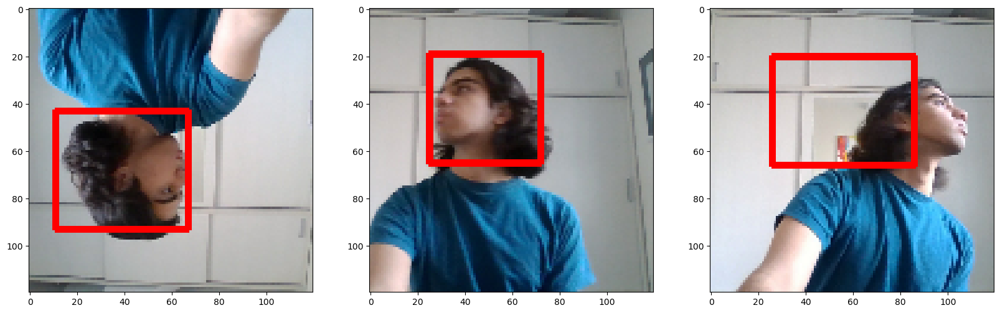

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999976 ],
       [0.9999998 ],
       [0.99997306],
       [0.9999922 ],
       [0.99999934],
       [0.999996  ],
       [0.9999996 ],
       [0.99984324]], dtype=float32), array([[0.34696713, 0.37429428, 0.78766716, 0.7796378 ],
       [0.30288535, 0.10840051, 0.790354  , 0.63177645],
       [0.4753413 , 0.35674837, 0.9505593 , 0.78156096],
       [0.19839457, 0.144466  , 0.6778387 , 0.54800284],
       [0.4707021 , 0.13751508, 0.8819277 , 0.5967703 ],
       [0.22796264, 0.1348551 , 0.695781  , 0.57788867],
       [0.04642144, 0.4222352 , 0.5174682 , 0.7884439 ],
       [0.5064392 , 0.2632286 , 0.9235077 , 0.4925719 ]], dtype=float32)]


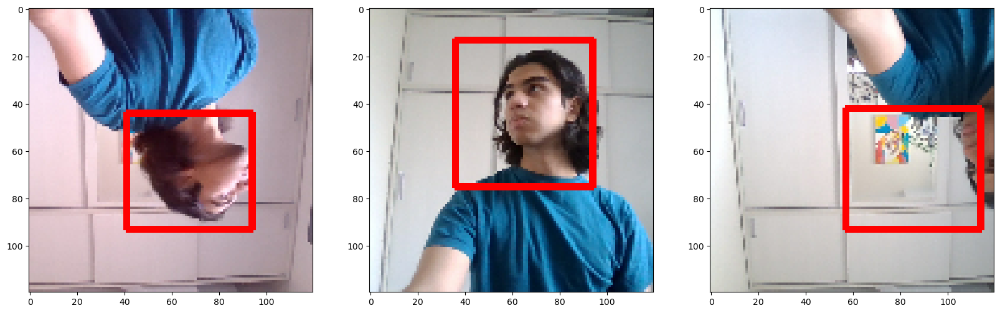

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9992691 ],
       [0.9999999 ],
       [0.99926627],
       [0.9999966 ],
       [0.9999997 ],
       [0.999865  ],
       [0.9999991 ],
       [0.99999934]], dtype=float32), array([[0.38312614, 0.4320615 , 0.880183  , 0.69430643],
       [0.23212934, 0.10431343, 0.7886727 , 0.5916971 ],
       [0.48334917, 0.36878133, 0.92786133, 0.70773995],
       [0.29262125, 0.405787  , 0.87752813, 0.82535726],
       [0.22473662, 0.14027083, 0.7018101 , 0.59303105],
       [0.36703172, 0.35777652, 0.878177  , 0.68120897],
       [0.15217233, 0.17383896, 0.59938014, 0.51207167],
       [0.09252375, 0.40888238, 0.52928346, 0.84259284]], dtype=float32)]


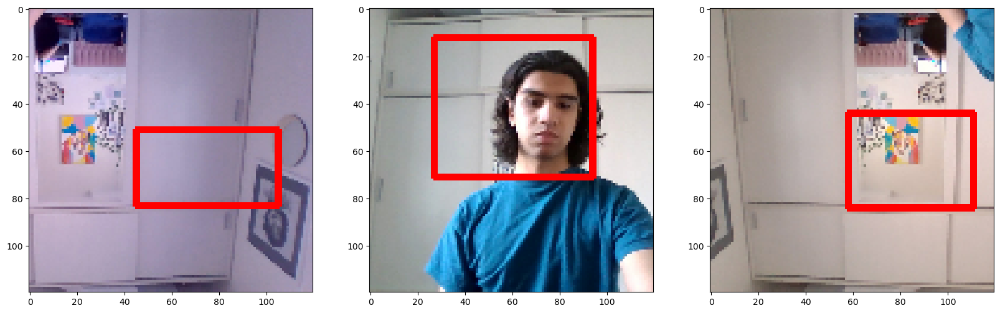

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999976],
       [0.9999978 ],
       [0.9999938 ],
       [0.9999985 ],
       [0.99999964],
       [0.99991304],
       [0.9999967 ],
       [0.99999917]], dtype=float32), array([[0.04235486, 0.3997326 , 0.4321035 , 0.8505042 ],
       [0.5264515 , 0.15707375, 0.96110815, 0.5905548 ],
       [0.30553016, 0.2010885 , 0.8053819 , 0.55282307],
       [0.12900642, 0.2130177 , 0.5835005 , 0.5186262 ],
       [0.15661342, 0.09998019, 0.56560314, 0.5298344 ],
       [0.20233907, 0.34448013, 0.73853344, 0.6486715 ],
       [0.18891881, 0.42892236, 0.72282505, 0.70426774],
       [0.10171507, 0.40175146, 0.5493745 , 0.8495444 ]], dtype=float32)]


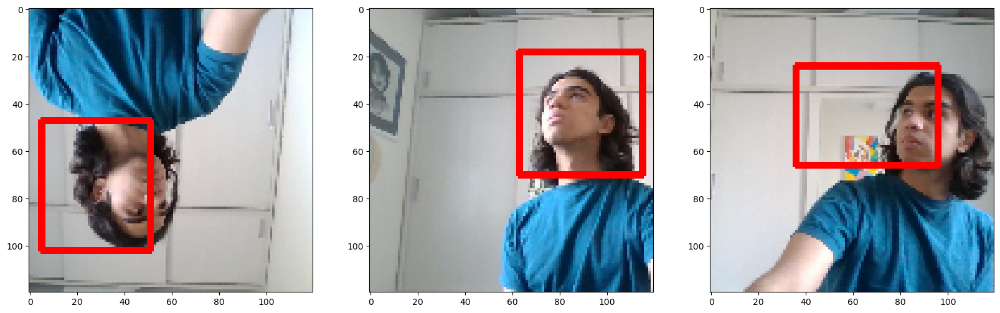

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.999809  ],
       [0.99999106],
       [0.9999991 ],
       [0.9999997 ],
       [0.99992657],
       [0.99999845],
       [0.99999994],
       [0.99999845]], dtype=float32), array([[0.3055528 , 0.38200587, 0.8480408 , 0.66255033],
       [0.48242512, 0.25317895, 0.90957034, 0.61267483],
       [0.15833148, 0.46706274, 0.65931773, 0.77326834],
       [0.3088727 , 0.13686931, 0.7880734 , 0.60614616],
       [0.5133521 , 0.34171975, 0.9216088 , 0.6483728 ],
       [0.2830815 , 0.37320182, 0.7457559 , 0.82878333],
       [0.16835195, 0.23379485, 0.7130141 , 0.5435727 ],
       [0.27719662, 0.16007154, 0.77679884, 0.47097585]], dtype=float32)]


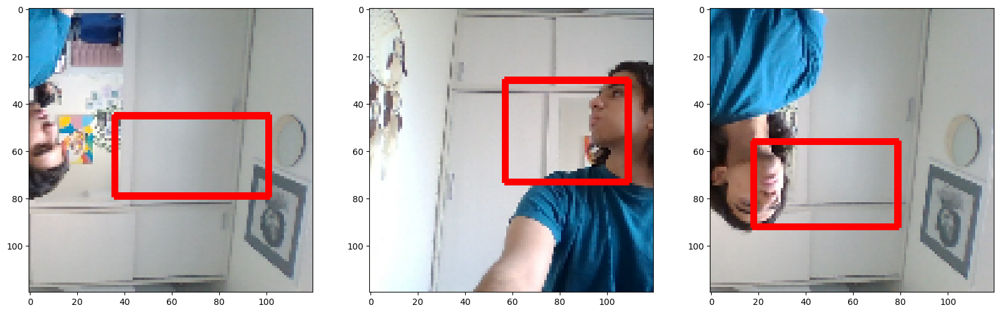

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999984 ],
       [0.999999  ],
       [0.9999972 ],
       [0.99999726],
       [0.9999976 ],
       [0.99999815],
       [0.99995244],
       [0.99976224]], dtype=float32), array([[0.6415628 , 0.42980057, 0.98407835, 0.8451944 ],
       [0.14992462, 0.12102444, 0.5107869 , 0.56174517],
       [0.279771  , 0.15029684, 0.7147987 , 0.5641156 ],
       [0.3265936 , 0.20415898, 0.808504  , 0.5920816 ],
       [0.16716254, 0.23509301, 0.6473944 , 0.5644537 ],
       [0.13757867, 0.50605106, 0.60497177, 0.8105    ],
       [0.29265207, 0.29391378, 0.77813405, 0.61938787],
       [0.3571917 , 0.37169808, 0.8757376 , 0.65527046]], dtype=float32)]


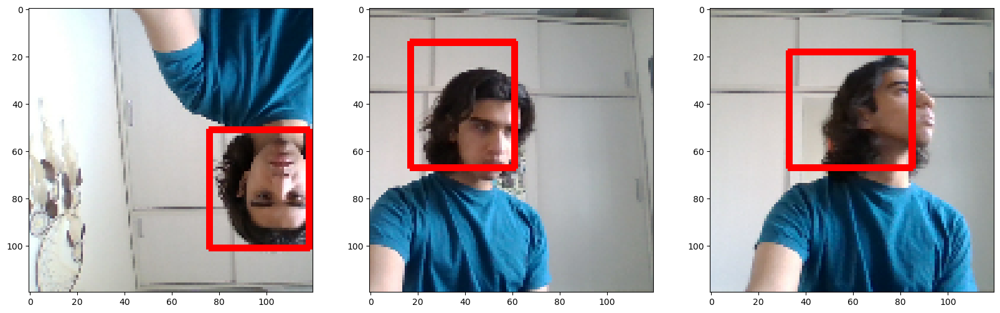

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.999756  ],
       [0.99999446],
       [0.9999992 ],
       [0.99998456],
       [0.9995328 ],
       [0.9999982 ],
       [0.99999547],
       [0.99999964]], dtype=float32), array([[0.46871015, 0.38797346, 0.9249657 , 0.671563  ],
       [0.5860315 , 0.3889163 , 0.9679399 , 0.83439434],
       [0.52050924, 0.34706762, 0.943068  , 0.8575666 ],
       [0.33951575, 0.18852201, 0.8380881 , 0.5346145 ],
       [0.41546276, 0.33733353, 0.9354324 , 0.6319788 ],
       [0.66367805, 0.4153623 , 0.98463756, 0.8477675 ],
       [0.49085546, 0.19643778, 0.96754616, 0.6150037 ],
       [0.2970946 , 0.12192841, 0.81393117, 0.5807736 ]], dtype=float32)]


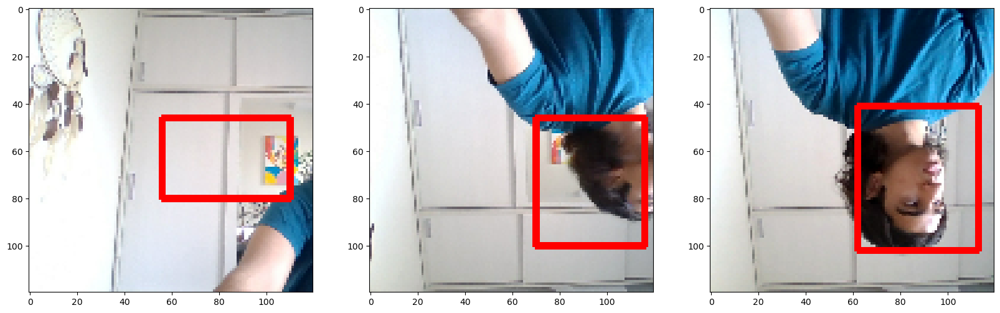

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999987 ],
       [0.99999887],
       [0.9999994 ],
       [0.9999987 ],
       [0.99997646],
       [0.99999976],
       [0.9999557 ],
       [0.9999992 ]], dtype=float32), array([[0.11739811, 0.17409071, 0.6187809 , 0.5335946 ],
       [0.05657168, 0.38387743, 0.53546715, 0.7819675 ],
       [0.206092  , 0.1134673 , 0.6600597 , 0.5912571 ],
       [0.6198426 , 0.4005226 , 0.9815491 , 0.88228524],
       [0.47910982, 0.39798272, 0.94341695, 0.80338377],
       [0.1840985 , 0.12497139, 0.65533394, 0.59823513],
       [0.4470522 , 0.28932154, 0.90726846, 0.57372993],
       [0.221589  , 0.11744371, 0.672682  , 0.6001049 ]], dtype=float32)]


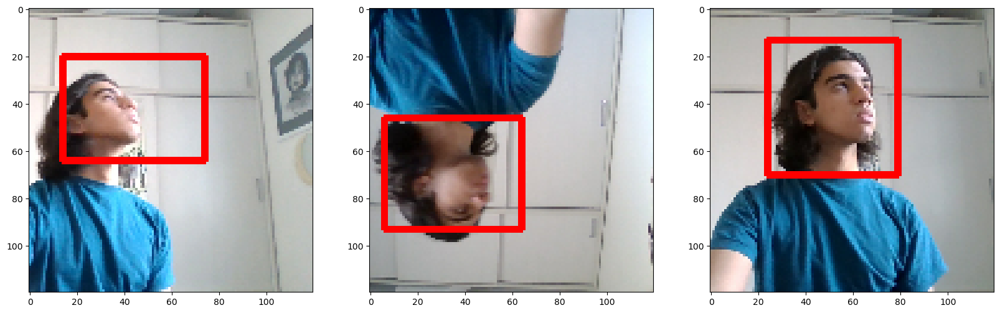

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99970305],
       [0.999995  ],
       [0.999998  ],
       [0.99999905],
       [0.9994536 ],
       [0.99999696],
       [0.9999996 ],
       [0.99997854]], dtype=float32), array([[0.4856221 , 0.38671306, 0.92067003, 0.6694608 ],
       [0.459467  , 0.19222425, 0.924897  , 0.61773777],
       [0.17794722, 0.4328722 , 0.6525183 , 0.840031  ],
       [0.16358028, 0.49255243, 0.7460911 , 0.78847593],
       [0.4793745 , 0.3501711 , 0.9333621 , 0.7081351 ],
       [0.24187775, 0.14400108, 0.6830575 , 0.6217479 ],
       [0.04298654, 0.40545213, 0.4274786 , 0.8370824 ],
       [0.43608195, 0.39253506, 0.92531276, 0.8138341 ]], dtype=float32)]


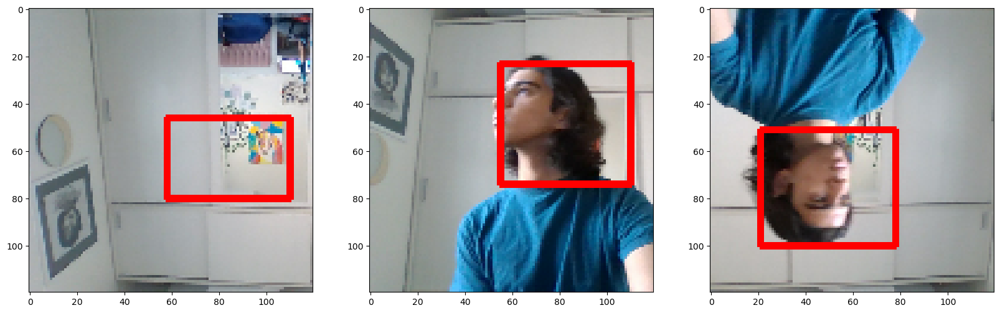

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99997705],
       [0.9999914 ],
       [0.9997105 ],
       [0.9999998 ],
       [0.9999999 ],
       [0.9999988 ],
       [0.9999542 ],
       [0.99999905]], dtype=float32), array([[0.46707463, 0.3864904 , 0.93510145, 0.813131  ],
       [0.44172442, 0.3972072 , 0.9005606 , 0.84396195],
       [0.48704985, 0.38949463, 0.93285954, 0.691828  ],
       [0.25040472, 0.10912941, 0.7020117 , 0.60357225],
       [0.17767335, 0.26961666, 0.68359643, 0.52919173],
       [0.1992579 , 0.13922545, 0.6506536 , 0.56326854],
       [0.49684727, 0.36292496, 0.9508169 , 0.78550744],
       [0.08763784, 0.493817  , 0.54018915, 0.83763963]], dtype=float32)]


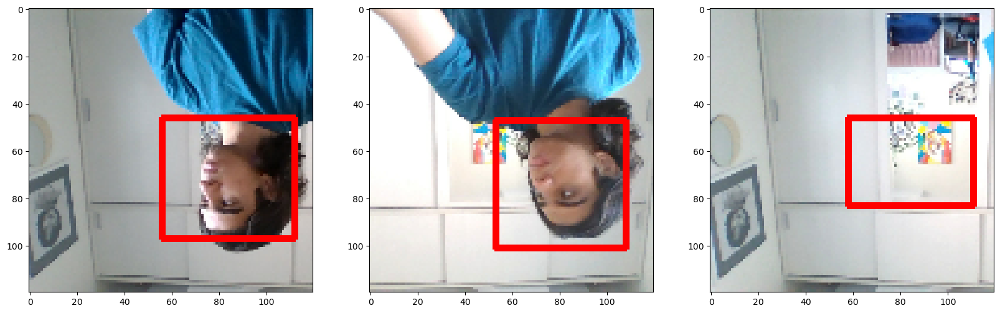

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99997926],
       [0.99998873],
       [0.99999297],
       [0.99999696],
       [0.9999995 ],
       [0.99999964],
       [0.9999994 ],
       [0.99999875]], dtype=float32), array([[0.47838718, 0.40318277, 0.9428695 , 0.8071749 ],
       [0.3297656 , 0.4033282 , 0.90182734, 0.79011565],
       [0.3832431 , 0.3532551 , 0.84353495, 0.8116424 ],
       [0.1370575 , 0.24580742, 0.6565787 , 0.5345025 ],
       [0.1792763 , 0.4510739 , 0.7279568 , 0.7600593 ],
       [0.11707423, 0.49370927, 0.602943  , 0.7918003 ],
       [0.09604626, 0.13948709, 0.49769485, 0.58946437],
       [0.20207448, 0.42091376, 0.64423233, 0.84967923]], dtype=float32)]


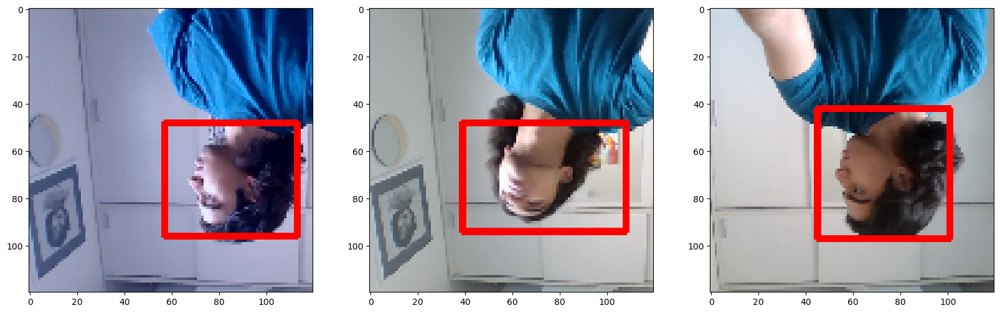

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999994],
       [0.99999785],
       [0.9999991 ],
       [0.9999992 ],
       [0.9999996 ],
       [1.        ],
       [0.9999897 ],
       [0.9999986 ]], dtype=float32), array([[0.02939152, 0.44918397, 0.52246755, 0.8234995 ],
       [0.5714481 , 0.14502437, 0.97026217, 0.58519447],
       [0.14566775, 0.16071792, 0.6173916 , 0.5352117 ],
       [0.10873716, 0.446626  , 0.63461137, 0.78451097],
       [0.04366556, 0.3606637 , 0.3678081 , 0.8449579 ],
       [0.08089957, 0.18558669, 0.46383065, 0.5464108 ],
       [0.52819645, 0.2170794 , 0.9680622 , 0.60071623],
       [0.24546875, 0.13802682, 0.605093  , 0.5702437 ]], dtype=float32)]


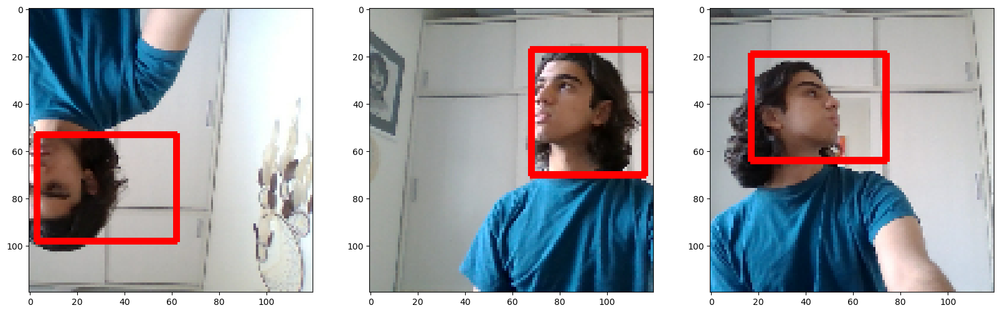

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999934],
       [0.9999106 ],
       [0.99999833],
       [0.99999905],
       [0.999999  ],
       [0.9999992 ],
       [0.9999996 ],
       [0.9999996 ]], dtype=float32), array([[0.49265572, 0.09984489, 0.92814976, 0.58771324],
       [0.4849623 , 0.367387  , 0.9457105 , 0.77026796],
       [0.15275045, 0.28177053, 0.6345165 , 0.50974596],
       [0.21215971, 0.45473108, 0.6775018 , 0.841808  ],
       [0.30184597, 0.16165048, 0.7528325 , 0.59265804],
       [0.13313308, 0.23202282, 0.6593828 , 0.56727505],
       [0.31076783, 0.10021729, 0.79285073, 0.58815336],
       [0.19681215, 0.186898  , 0.71578425, 0.53393435]], dtype=float32)]


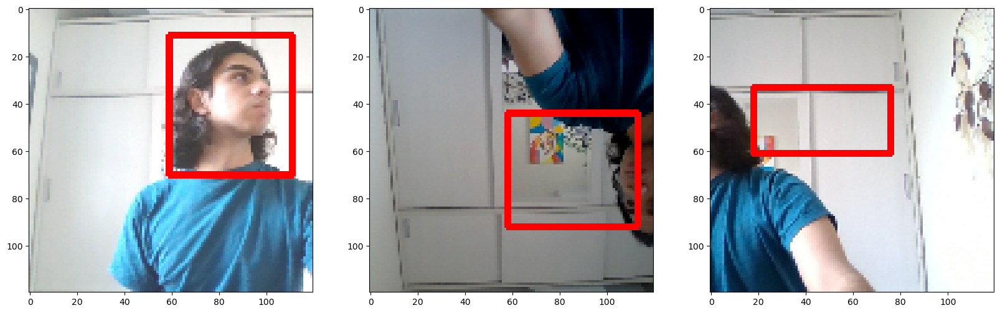

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99983644],
       [0.9999987 ],
       [0.99999577],
       [0.9999723 ],
       [0.9999972 ],
       [0.9999916 ],
       [0.9999582 ],
       [0.9999979 ]], dtype=float32), array([[0.2973598 , 0.3571276 , 0.7211711 , 0.59447026],
       [0.15601873, 0.12987527, 0.54543173, 0.5387117 ],
       [0.35926616, 0.16916335, 0.85188746, 0.51731163],
       [0.43198943, 0.29222766, 0.86259794, 0.5612258 ],
       [0.13759439, 0.32063058, 0.5957991 , 0.78003377],
       [0.45678785, 0.27668422, 0.9162484 , 0.6411724 ],
       [0.39763087, 0.3893736 , 0.8967172 , 0.7410921 ],
       [0.6420419 , 0.429341  , 0.9836692 , 0.8444193 ]], dtype=float32)]


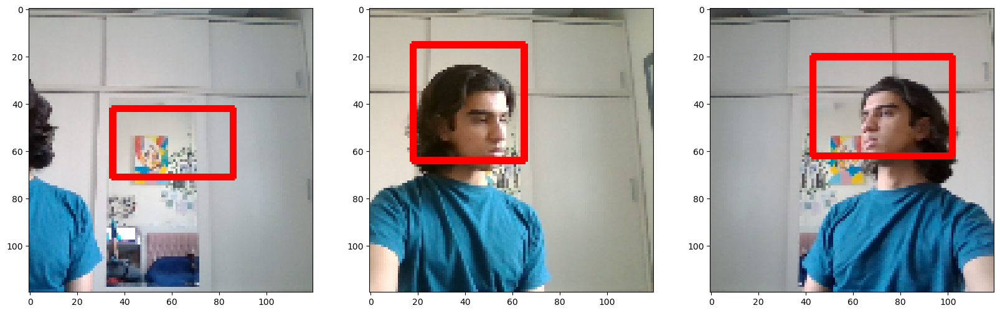

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999859 ],
       [0.9999987 ],
       [0.9999999 ],
       [0.99999917],
       [0.99998987],
       [0.9999997 ],
       [0.99999833],
       [0.9999997 ]], dtype=float32), array([[0.61208236, 0.41182894, 0.9716223 , 0.80534947],
       [0.27598202, 0.15513387, 0.79796976, 0.56964463],
       [0.10942946, 0.15252024, 0.55059606, 0.5202048 ],
       [0.17071386, 0.1808533 , 0.69967353, 0.5098318 ],
       [0.5748271 , 0.37378153, 0.97154075, 0.83881605],
       [0.4189746 , 0.13254862, 0.8451215 , 0.60416543],
       [0.6291207 , 0.41826335, 0.9827889 , 0.86184883],
       [0.03601877, 0.4143599 , 0.39208135, 0.8372399 ]], dtype=float32)]


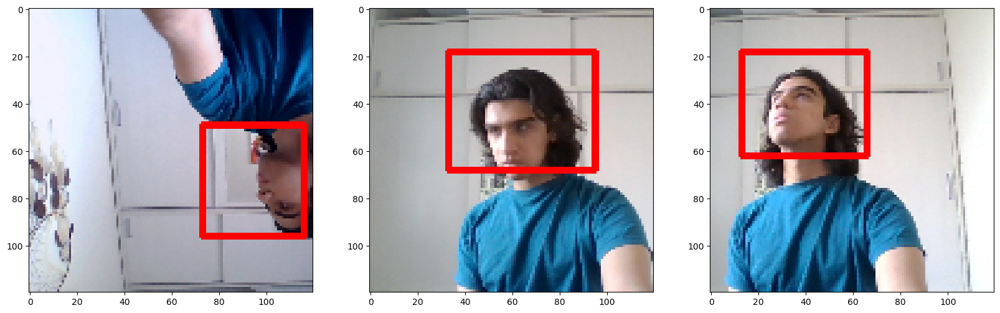

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.9999998 ],
       [0.9999671 ],
       [0.9999928 ],
       [0.9999993 ],
       [0.9988665 ],
       [0.9999977 ],
       [0.99996084],
       [0.9999846 ]], dtype=float32), array([[0.1752657 , 0.12439071, 0.66577655, 0.5892358 ],
       [0.16169864, 0.33131206, 0.6433706 , 0.71565795],
       [0.31983885, 0.20359439, 0.84040654, 0.582506  ],
       [0.18885638, 0.18240923, 0.67095554, 0.5140498 ],
       [0.43263483, 0.38460854, 0.8463904 , 0.6218153 ],
       [0.28942034, 0.4033109 , 0.76770157, 0.81536937],
       [0.53649414, 0.29194313, 0.91770047, 0.6456124 ],
       [0.43149292, 0.3905289 , 0.92909104, 0.84203625]], dtype=float32)]


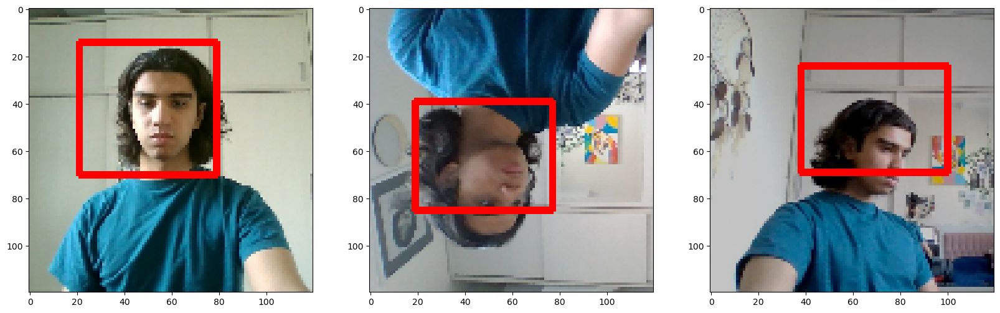

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


[array([[0.99999684],
       [0.9999999 ],
       [0.9999998 ],
       [0.99999964],
       [0.99999654],
       [0.999996  ],
       [0.9999558 ],
       [0.9999993 ]], dtype=float32), array([[0.09910157, 0.4741756 , 0.5898129 , 0.755823  ],
       [0.18535976, 0.23970921, 0.706182  , 0.56296337],
       [0.10139567, 0.11536656, 0.4501476 , 0.5754274 ],
       [0.08897124, 0.47358572, 0.67418957, 0.78915983],
       [0.54484344, 0.18582402, 0.9705789 , 0.58645475],
       [0.18874371, 0.20575207, 0.5676601 , 0.5504551 ],
       [0.5118114 , 0.33833724, 0.95160425, 0.76849645],
       [0.05871461, 0.41357806, 0.46928388, 0.81025434]], dtype=float32)]


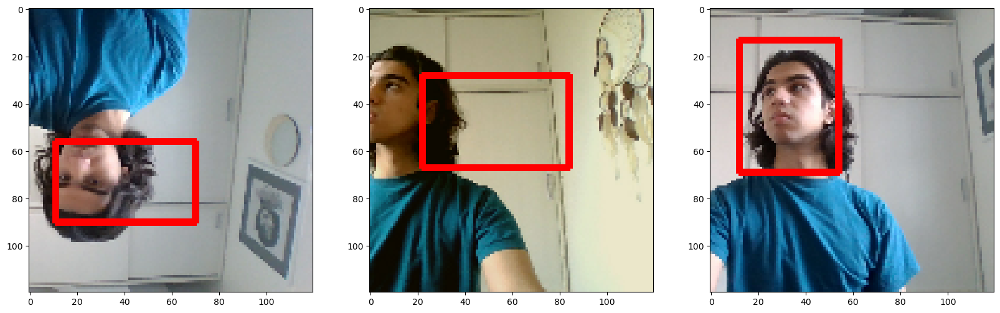

KeyboardInterrupt: 

In [68]:
import time
while True:
    val_sample = val_data.next()
    yhat = model.predict(val_sample[0])
    print(yhat)
    fig, ax = plt.subplots(ncols=3, figsize=(20,20))
    for idx in range(3): 
        sample_image = np.copy(val_sample[0][idx])
        if yhat[0][idx] > 0.50:
            sample_coords = np.copy(yhat[1][idx])
            cv2.rectangle(sample_image, 
                          tuple(np.multiply(sample_coords[:2], [120,120]).astype(int)),
                          tuple(np.multiply(sample_coords[2:], [120,120]).astype(int)), 
                                (255,0,0), 2)
        else:
            cv2.putText(sample_image, "No Face in the frame", (0, 0))
        ax[idx].imshow(sample_image)
    plt.show()